In [1]:
import numpy as np
import time
import os
import shutil

import random
import pandas as pd

from pylab import *
import matplotlib.pyplot as plt
# from matplotlib_venn import *
%matplotlib inline
import seaborn as sns

from scipy import stats
import scipy
from numpy.random import *
from scipy.stats import poisson

/opt/anaconda3/envs/nb450/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.1
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [2]:
datadir = "../data/"
outdir = "../result/"


In [4]:
%%time

df_anno = pd.read_csv(datadir+"epic_anno.csv.gz", index_col=0)
df_beta = pd.read_csv(datadir+"4data_all.tsv.gz", index_col=0)

refgenes_header = ["bin", "name", "chrom", "strand", "txStart", "txEnd", "cdsStart", "cdsEnd", "exonCount", "exonStarts", "exonEnds", "score", "name2", "cdsStartStat", "cdsEndStat", "exonFrames"] 
df_refgenes = pd.read_table(datadir+"refGene.txt.gz", header=None)
df_refgenes = df_refgenes.rename(columns=lambda i:refgenes_header[i])

top_probes = pd.read_csv(datadir+"topprobes.tsv.gz", sep="\t", index_col=0)
top_probes.head()

df_Gini = pd.read_csv(datadir+'Gini/allprobes_Gini.csv',index_col=0)

df_imp = pd.read_csv(datadir+"imp_rank.csv.gz",header=None)


<timed exec>:1: DtypeWarning: Columns (2,4,42) have mixed types. Specify dtype option on import or set low_memory=False.


FileNotFoundError: [Errno 2] No such file or directory: '../data/Gini/allprobes_Gini.csv'

In [5]:
df_samples = pd.read_csv(datadir+"4data_MYCN.csv")
sorted_samples = df_samples.loc[df_samples["class"]=="MYCNA"]["ID"]
sorted_samples = pd.concat([df_samples.loc[df_samples["class"]=="other"]["ID"]
                            , df_samples.loc[df_samples["class"]=="4s"]["ID"]
                            , df_samples.loc[df_samples["class"]=="4"]["ID"]
                            , df_samples.loc[df_samples["class"]=="MYCNA"]["ID"]])

df_D1 = pd.read_csv(datadir+"class/df_misclass.txt",header=None)
df_D2 = pd.read_csv(datadir+"class/df_trueclass.txt",header=None)

D1_name = df_samples.loc[df_samples["class"]=="other"].loc[~df_samples.loc[df_samples["class"]=="other"]["ID"].isin(df_D2[0])]
D2_name = df_samples.loc[df_samples["class"]=="other"].loc[df_samples.loc[df_samples["class"]=="other"]["ID"].isin(df_D2[0])]


In [6]:
gene_color = {
            "TSS1500":"tan", "TSS200":"red", "5'UTR":"mediumpurple", "3'UTR":"mediumpurple", "1stExon":"palegreen", "Exon":"maroon", "Intron":"gray", "Body":"maroon"
        }
gene_height = {
            "TSS1500":0.4, "TSS200":0.8, "5'UTR":0.4, "3'UTR":0.4, "1stExon":0.3, "Exon":0.9, "Intron":0.3, "Body":0.9
        }
cluster_color = {
    "['MYCNA']":"crimson","['4']":"royalblue","['4s']":"cyan","['other']":"orange","['4', 'MYCNA']":"purple"
}


In [7]:
focal_gene_names = ["MYCN", "EDAR","FAM13A","PRDM8"]
focal_genes = pd.DataFrame()
for k in focal_gene_names:
    for i,items in df_refgenes.loc[df_refgenes["name2"].str.contains(k)].iterrows():
        focal_genes.at[items["name"], "name"] = items["name"]
        focal_genes.at[items["name"], "chrom"] = items["chrom"]
        focal_genes.at[items["name"], "strand"] = items["strand"]
        focal_genes.at[items["name"], "txStart"] = items["txStart"]
        focal_genes.at[items["name"], "txEnd"] = items["txEnd"]
        focal_genes.at[items["name"], "name2"] = items["name2"]
        focal_genes.at[items["name"], "name"] = items["name"]
focal_genes

,name,chrom,strand,txStart,txEnd,name2
NR_110230,NR_110230,chr2,-,16076386.0,16081807.0,MYCNOS
NM_005378,NM_005378,chr2,+,16080671.0,16087125.0,MYCN
NR_125783,NR_125783,chr2,+,16060520.0,16076140.0,MYCNUT
NM_001293233,NM_001293233,chr2,+,16080671.0,16087125.0,MYCN
NM_001293231,NM_001293231,chr2,+,16080671.0,16087125.0,MYCN
NM_001293228,NM_001293228,chr2,+,16080671.0,16087125.0,MYCN
NR_161163,NR_161163,chr2,-,16080019.0,16082555.0,MYCNOS
NR_161162,NR_161162,chr2,-,16080019.0,16081807.0,MYCNOS
NM_145861,NM_145861,chr1,+,236557585.0,236648230.0,EDARADD
NM_080738,NM_080738,chr1,+,236558712.0,236648205.0,EDARADD


In [8]:
focal_genes

,name,chrom,strand,txStart,txEnd,name2
NR_110230,NR_110230,chr2,-,16076386.0,16081807.0,MYCNOS
NM_005378,NM_005378,chr2,+,16080671.0,16087125.0,MYCN
NR_125783,NR_125783,chr2,+,16060520.0,16076140.0,MYCNUT
NM_001293233,NM_001293233,chr2,+,16080671.0,16087125.0,MYCN
NM_001293231,NM_001293231,chr2,+,16080671.0,16087125.0,MYCN
NM_001293228,NM_001293228,chr2,+,16080671.0,16087125.0,MYCN
NR_161163,NR_161163,chr2,-,16080019.0,16082555.0,MYCNOS
NR_161162,NR_161162,chr2,-,16080019.0,16081807.0,MYCNOS
NM_145861,NM_145861,chr1,+,236557585.0,236648230.0,EDARADD
NM_080738,NM_080738,chr1,+,236558712.0,236648205.0,EDARADD


NR_125783 MYCNUT + 16060520 16060520 16076140
NR_110230 MYCNOS - 16081807 16076386 16081807
NR_161163 MYCNOS - 16082555 16080019 16082555
NR_161162 MYCNOS - 16081807 16080019 16081807
NM_005378 MYCN + 16080671 16080671 16087125


NameError: name 'df_Gini' is not defined

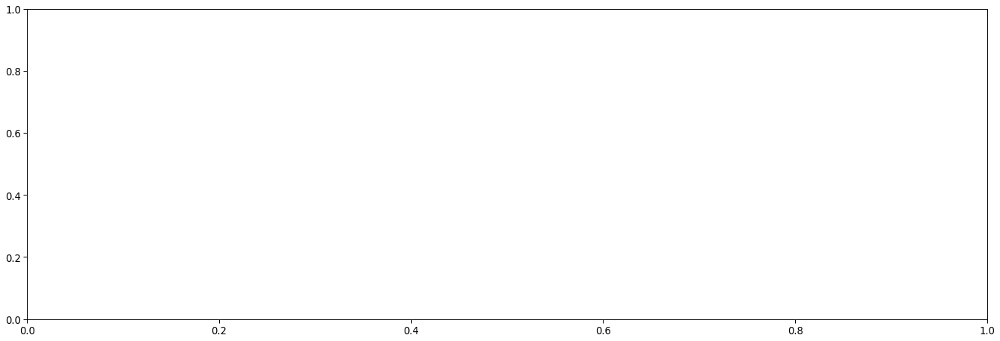

In [10]:
sns.set_context("paper", font_scale=1.5)

lw=3

for j, itemsg in focal_genes.iterrows():
    TSS = 0
    if itemsg["strand"] == "+":
        TSS = itemsg["txStart"]
    else:
        TSS = itemsg["txEnd"]
        
    side = 100000
    print(itemsg["name"], itemsg["name2"], itemsg["strand"], TSS, itemsg["txStart"], itemsg["txEnd"])
#     continue
    refseq_id = itemsg["name"]
    symbol = itemsg["name2"]
    focalprobes = df_anno.loc[(df_anno["CHR"]==itemsg["chrom"].replace("chr","")) & (df_anno["Methyl450_Loci"]==True) & (df_anno["MAPINFO"]>TSS-side) & (df_anno["MAPINFO"]<TSS+side)].sort_values("MAPINFO")
    focalprobes

    focalprobes["UCSC_RefGene_Accession"] = focalprobes["UCSC_RefGene_Accession"].fillna("-1")

    if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(refseq_id)].shape[0]==0:
        continue

    chrom = df_refgenes.loc[df_refgenes["name"]==refseq_id]["chrom"].values[0]
    strand = df_refgenes.loc[df_refgenes["name"]==refseq_id]["strand"].values[0]
    txStart = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txStart"].values[0]
    txEnd = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txEnd"].values[0]
    focal_genes = df_refgenes.loc[(df_refgenes["chrom"]==chrom) & ((txStart-100000<df_refgenes["txEnd"])) & (df_refgenes["txEnd"]<txStart+100000)]
    focal_genes = focal_genes.sort_values("txStart")
    
    samplenum = 82+55+246+110

#     fig = plt.figure(figsize=(focalprobes.shape[0]/2, 10))
    fig = plt.figure(figsize=((focalprobes.shape[0]+5)/2, (samplenum+60+15*focal_genes.shape[0])/40))

    ############### ax2
    ax2 = fig.add_subplot(211)
    
    yticks_pos = []
    yticks_label = []
 
    h_offset = 0
    top_check = focalprobes.index.isin(top_probes.index)
    for i in range(len(top_check)):
        if focalprobes.index.isin(top_probes.index)[i]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((i,h_offset+10),1,20,fc="gray"))
#             ax2.add_patch(matplotlib.patches.Rectangle((i,h_offset+10),1,20,fc="magenta"))
    yticks_pos.append(h_offset+20)
    yticks_label.append("Top importance probes")

    focal_Gini = pd.DataFrame()
    for k in focalprobes.index:
        for ka in ['thre', 'large', 'small', 'large0.5', 'small0.5', 'large0.6', 'small0.6', 'large0.7', 'small0.7', 'large0.8', 'small0.8', 'large0.9', 'small0.9']:
            focal_Gini.at[k, ka] = df_Gini.at[k, ka]
    focal_Gini
    
    h_offset+=40
    ia = 0
    for i, items in focal_Gini.iterrows():
        for k in cluster_color.keys():
            if items["large0.8"]==k:
                tri = plt.Polygon(((ia,h_offset+20),(ia+1,h_offset+20),(ia,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
            if items["small0.8"]==k:
                tri = plt.Polygon(((ia,h_offset),(ia+1,h_offset+20),(ia+1,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("$CMS_k$")
    
    h_offset += 30
    ia = 0
    for i, items in focalprobes.iterrows():
        if items["450k_Enhancer"]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,20,fc="orange"))
        if items["Relation_to_UCSC_CpG_Island"]=="Island":
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,20,fc="b"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shore") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shore"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,14,fc="royalblue"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shelf") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shelf"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,8,fc="skyblue"))
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("450k_Enhancer")
    yticks_pos.append(h_offset+40)
    yticks_label.append("CpG_Island")

#     yticks_label.append("Relation_to_UCSC_CpG_Island")
    h_offset += 40

    # gene annotation
    ia = 0
    for k in [refseq_id]:
        h_offset+=30
        for i, items in focalprobes.iterrows():
            if items["UCSC_RefGene_Accession"]=="-1":

                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)

            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,8,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values.shape[0] == 0:
                continue
            group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
        yticks_label.append(k)



    print(h_offset)
    for ka,itemsk in focal_genes.iterrows():
        k = itemsk["name"]
#         print(itemsk["name"],itemsk["name2"])
        if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(k)].shape[0]==0:
            continue
        if k==refseq_id:
            continue
            
        ia = 0
        h_offset+=30
        print(ka, k, h_offset)

        for i, items in focalprobes.iterrows():
            if pd.isna(items["UCSC_RefGene_Accession"])==True:
                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

#             print(k, i)
            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)
#                 print("\t", k, i, h_offset)
            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
#                 print(df_tmp)
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,16,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")].shape[0] > 0:
                group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
#         yticks_label.append(k)
        yticks_label.append(itemsk["name2"]+"( "+itemsk["name"]+" )")

    print(yticks_pos)
    print(yticks_label)


    ax2.set_yticks(yticks_pos)
    ax2.set_yticklabels(yticks_label,fontsize=28)
    ax2.set_xticks([])
    ax2.set_xticklabels([])
    ax2.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax2.set_ylim(-50, h_offset+50)
    ax2.spines['top'].set_visible(False)
    ax2.spines['bottom'].set_visible(False)
    ax2.spines['right'].set_visible(False)
    ax2.spines['left'].set_visible(False)
    plt.title(symbol+"( "+refseq_id+" )", fontsize=30)


#     ax2.axis('off')

    xlabel_rank = []
    xlabel_rank2 = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
        if itemsg["strand"] == "+":
            xlabel_rank2.append(int(focalprobes.at[k, "MAPINFO"]-itemsg["txStart"]))
        else:
            xlabel_rank2.append(int(itemsg["txEnd"]-focalprobes.at[k, "MAPINFO"]))

    ax1 = fig.add_subplot(212)
    
    xlabel_rank = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
    sns.heatmap(df_beta.loc[focalprobes.index][sorted_samples].transpose(), xticklabels=xlabel_rank, cmap="YlGnBu"
                , cbar_kws={"shrink": 0.3*40/focalprobes.shape[0], "label":"beta", "orientation":"horizontal"})
    cax = ax1.collections[0].colorbar.ax
    cax.tick_params(which='major', labelsize=24)
    cax.xaxis.label.set_fontsize(24)

    lw=3
    ax1.hlines(51,0,443,"k",linewidth=lw)
    ax1.hlines(82,0,443,"k",linewidth=lw)
    ax1.hlines(82+55,0,443,"k",linewidth=lw)
    ax1.hlines(82+55+246,0,443,"k",linewidth=lw)
    # ax.hlines(110+55+246+82,0,443,"k",linewidth=lw)

    labels = ax1.get_xticklabels()
    ax1.set_xticklabels(labels,rotation=90)
    ax1.xaxis.tick_top()

    # ylabel
    ax1.set_yticks([51/2,51+31/2,82+55/2,82+55+246/2,82+55+246+110/2])
    ax1.set_yticklabels(["D2","D1","C","B","A"],fontsize=32)
    ax1.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax1.set_ylim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[0])

    ax1.text(-.3,550,"IlmnID", size=32, ha="right")
#     ax1.text(-.3,-70,"Distance from TSS", size=32, ha="right")

#     for i in range(len(xlabel_rank2)):
#         ax1.text(i+.5,-10,xlabel_rank2[i], size=14, ha="center", va="top", rotation=-90)

    ax1.set_xlabel("")
    ax1.set_ylabel("Samples",fontsize=28)

    print("fin", h_offset)


    # plt.savefig(wd+"/fig/topgenes_20211117/"+symbol+"-"+refseq_id+".pdf", bbox_inches="tight")
    plt.show()
#     break

In [ ]:
topgenes = pd.read_csv(wd+"data/Gini/top_probes_Gini_sum.csv", index_col=0)
topgenes

In [12]:
# focal_gene_name = "MYCN"
focal_genes = pd.DataFrame()
for k in topgenes.index:
    for i,items in df_refgenes.loc[df_refgenes["name"].str.contains(k)].iterrows():
#         print(items)
        focal_genes.at[items["name"], "name"] = items["name"]
        focal_genes.at[items["name"], "chrom"] = items["chrom"]
        focal_genes.at[items["name"], "strand"] = items["strand"]
        focal_genes.at[items["name"], "txStart"] = items["txStart"]
        focal_genes.at[items["name"], "txEnd"] = items["txEnd"]
        focal_genes.at[items["name"], "name2"] = items["name2"]
        focal_genes.at[items["name"], "name"] = items["name"]
# focal_genes = focal_genes.loc[focal_genes["name"]=="NM_005378"]
focal_genes

,name,chrom,strand,txStart,txEnd,name2
NM_001293233,NM_001293233,chr2,+,16080671.0,16087125.0,MYCN
NM_001293231,NM_001293231,chr2,+,16080671.0,16087125.0,MYCN
NM_001293228,NM_001293228,chr2,+,16080671.0,16087125.0,MYCN
NM_005378,NM_005378,chr2,+,16080671.0,16087125.0,MYCN
NR_110230,NR_110230,chr2,-,16076386.0,16081807.0,MYCNOS
...,...,...,...,...,...,...
NR_103739,NR_103739,chr15,-,66839516.0,66858336.0,LCTL
NM_001277332,NM_001277332,chr17,+,39431949.0,39432459.0,KRTAP9-7
NM_005902,NM_005902,chr15,+,67357939.0,67487505.0,SMAD3
NM_001164829,NM_001164829,chr1,-,43747550.0,43751252.0,C1orf210


In [17]:
focal_genes = pd.DataFrame()
for k in topgenes.index:
    for i,items in df_refgenes.loc[df_refgenes["name"]==k].iterrows():
#         print(items["name"], items["name2"])
        focal_genes.at[items["name"], "name"] = items["name"]
        focal_genes.at[items["name"], "chrom"] = items["chrom"]
        focal_genes.at[items["name"], "strand"] = items["strand"]
        focal_genes.at[items["name"], "txStart"] = items["txStart"]
        focal_genes.at[items["name"], "txEnd"] = items["txEnd"]
        focal_genes.at[items["name"], "name2"] = items["name2"]
focal_genes

,name,chrom,strand,txStart,txEnd,name2
NM_001293233,NM_001293233,chr2,+,16080671.0,16087125.0,MYCN
NM_001293231,NM_001293231,chr2,+,16080671.0,16087125.0,MYCN
NM_001293228,NM_001293228,chr2,+,16080671.0,16087125.0,MYCN
NM_005378,NM_005378,chr2,+,16080671.0,16087125.0,MYCN
NR_110230,NR_110230,chr2,-,16076386.0,16081807.0,MYCNOS
...,...,...,...,...,...,...
NR_103739,NR_103739,chr15,-,66839516.0,66858336.0,LCTL
NM_001277332,NM_001277332,chr17,+,39431949.0,39432459.0,KRTAP9-7
NM_005902,NM_005902,chr15,+,67357939.0,67487505.0,SMAD3
NM_001164829,NM_001164829,chr1,-,43747550.0,43751252.0,C1orf210


NM_001293233 MYCN + 16080671.0 16080671.0 16087125.0
NM_001293231 MYCN + 16080671.0 16080671.0 16087125.0
NM_001293228 MYCN + 16080671.0 16080671.0 16087125.0
NM_005378 MYCN + 16080671.0 16080671.0 16087125.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_005378']
fin 140


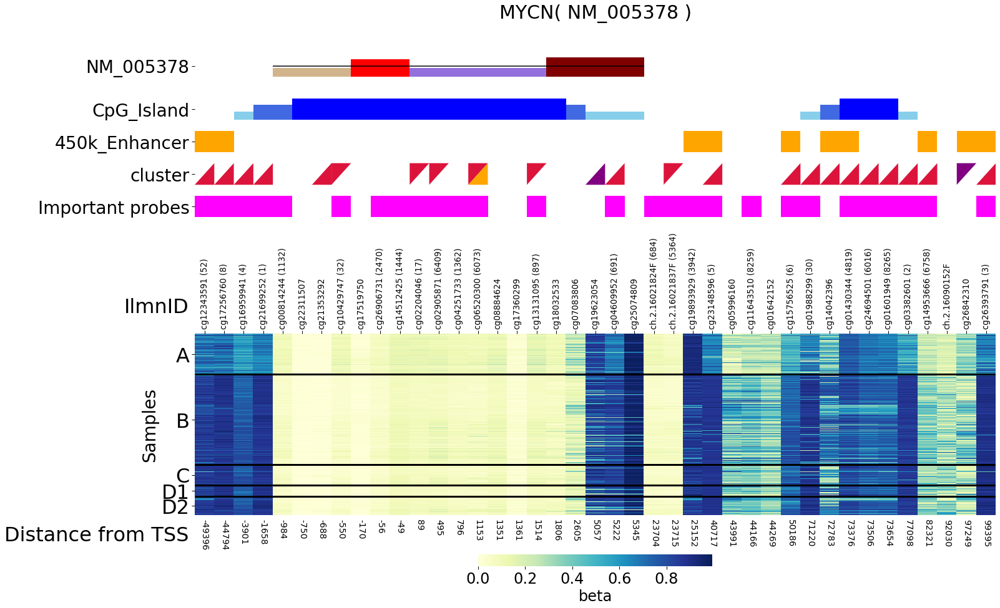

NR_110230 MYCNOS - 16081807.0 16076386.0 16081807.0
NR_125783 MYCNUT + 16060520.0 16060520.0 16076140.0
NR_126559 GACAT3 + 16190548.0 16190548.0 16225811.0
NR_110541 HORMAD2-AS1 - 30476246.0 30404735.0 30476246.0
NM_152510 HORMAD2 + 30476452.0 30476452.0 30573064.0
140
77436 NM_153050 170
37088 NM_021090 200
71793 NM_153051 230
[20, 50, 80, 110, 150, 180, 210, 240]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_152510', 'MTMR3( NM_153050 )', 'MTMR3( NM_021090 )', 'MTMR3( NM_153051 )']
fin 230


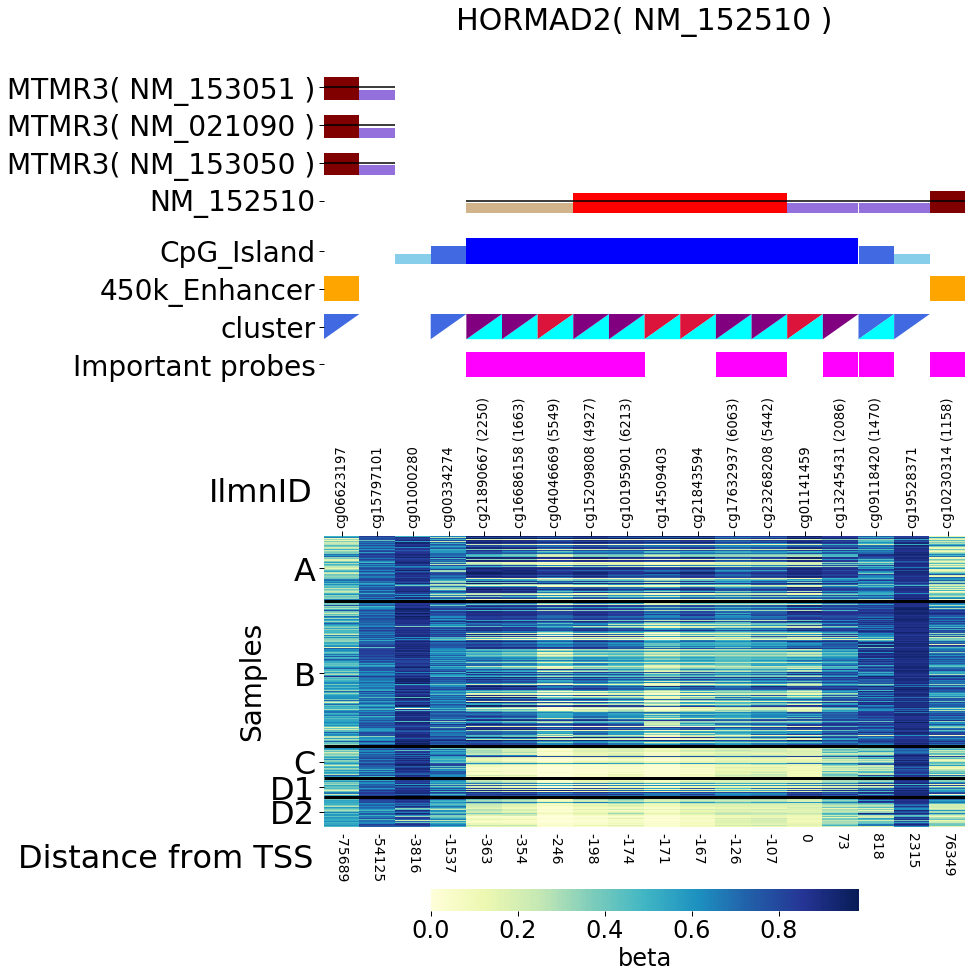

NR_106876 MIR6818 + 30403037.0 30403037.0 30403102.0
NM_001164257 PRR29 + 62075710.0 62075710.0 62081665.0
140
10939 NM_022580 170
43477 NM_001318 200
29393 NM_022579 230
13742 NM_022581 260
67819 NM_022559 290
67818 NM_022560 320
47838 NM_000515 350
69085 NM_001039933 380
32296 NM_000626 410
20576 NM_021602 440
29603 NM_000334 470
37200 NM_001099789 500
36417 NM_001099786 530
30515 NM_000873 560
47392 NM_001099787 590
28891 NM_001099788 620
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001164257', 'CSHL1( NM_022580 )', 'CSHL1( NM_001318 )', 'CSHL1( NM_022579 )', 'CSHL1( NM_022581 )', 'GH1( NM_022559 )', 'GH1( NM_022560 )', 'GH1( NM_000515 )', 'CD79B( NM_001039933 )', 'CD79B( NM_000626 )', 'CD79B( NM_021602 )', 'SCN4A( NM_000334 )', 'ICAM2( NM_001099789 )', 'ICAM2( NM_001099786 )', 'ICAM2( NM_000873 )', 'ICAM2( NM_001099787 )', 'ICAM2( NM_001099788 )']
fin 620


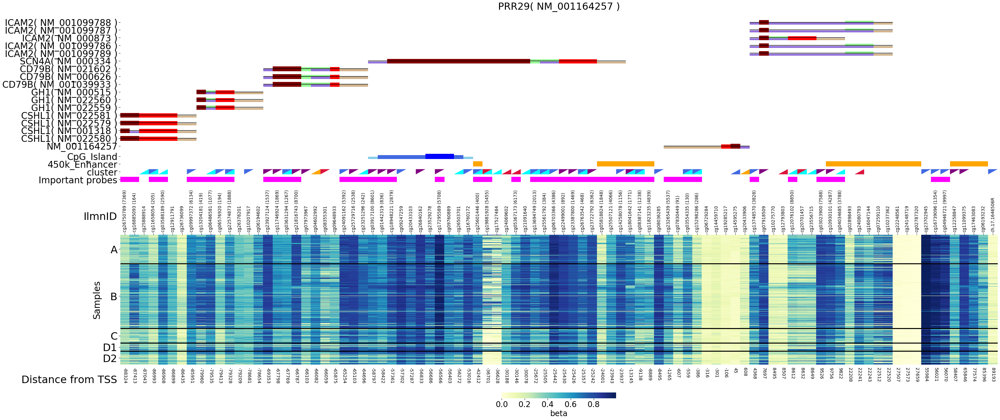

NM_001191029 PRR29 + 62075710.0 62075710.0 62081665.0
NM_001191030 PRR29 + 62075710.0 62075710.0 62081665.0
NR_126169 PRR29-AS1 - 62077259.0 62073430.0 62077259.0
NM_000873 ICAM2 - 62084283.0 62079954.0 62084283.0
140
10939 NM_022580 170
43477 NM_001318 200
29393 NM_022579 230
13742 NM_022581 260
67819 NM_022559 290
67818 NM_022560 320
47838 NM_000515 350
69085 NM_001039933 380
32296 NM_000626 410
20576 NM_021602 440
29603 NM_000334 470
40485 NM_001164257 500
37200 NM_001099789 530
36417 NM_001099786 560
47392 NM_001099787 590
28891 NM_001099788 620
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_000873', 'CSHL1( NM_022580 )', 'CSHL1( NM_001318 )', 'CSHL1( NM_022579 )', 'CSHL1( NM_022581 )', 'GH1( NM_022559 )', 'GH1( NM_022560 )', 'GH1( NM_000515 )', 'CD79B( NM_001039933 )', 'CD79B( NM_000626 )', 'CD79B( NM_021602 )', 'SCN4A( NM_000334 )', 'PRR29( NM_001164257 )', '

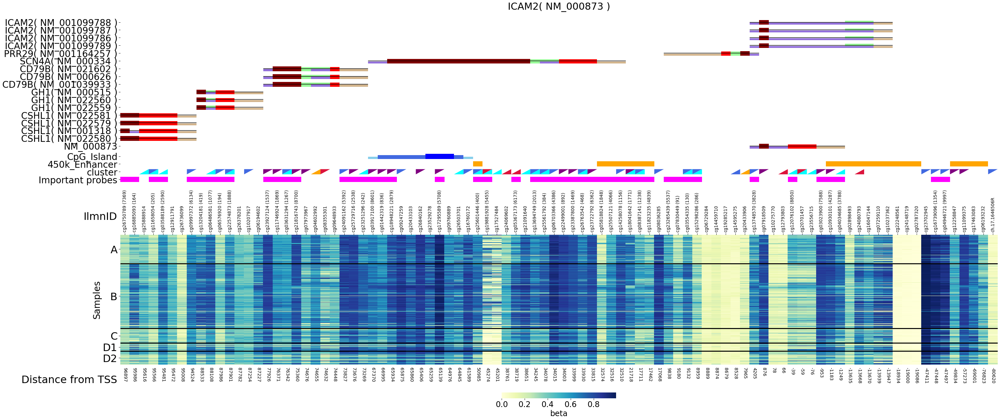

NM_001191031 PRR29 + 62075710.0 62075710.0 62081665.0
NM_001099789 ICAM2 - 62097993.0 62079954.0 62097993.0
140
69085 NM_001039933 170
32296 NM_000626 200
20576 NM_021602 230
29603 NM_000334 260
40485 NM_001164257 290
36417 NM_001099786 320
30515 NM_000873 350
47392 NM_001099787 380
28891 NM_001099788 410
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001099789', 'CD79B( NM_001039933 )', 'CD79B( NM_000626 )', 'CD79B( NM_021602 )', 'SCN4A( NM_000334 )', 'PRR29( NM_001164257 )', 'ICAM2( NM_001099786 )', 'ICAM2( NM_000873 )', 'ICAM2( NM_001099787 )', 'ICAM2( NM_001099788 )']
fin 410


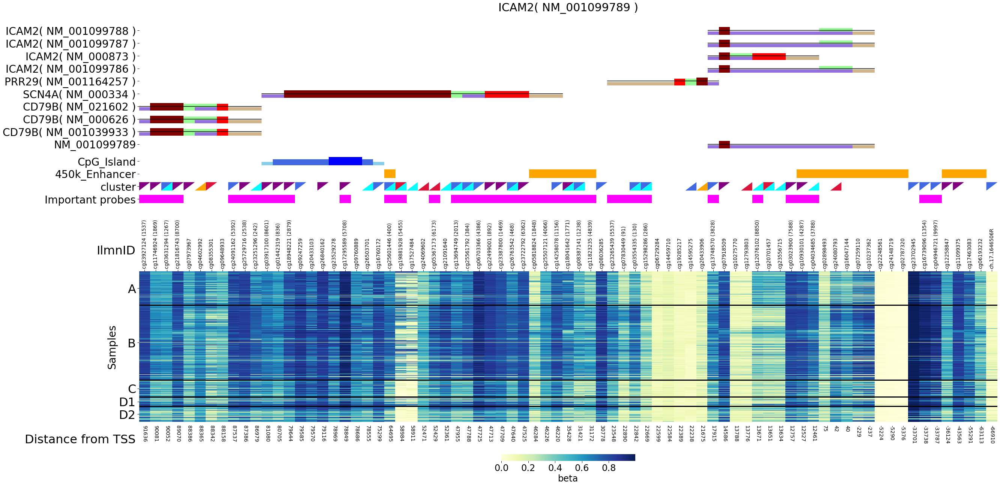

NM_001099788 ICAM2 - 62097994.0 62079954.0 62097994.0
140
69085 NM_001039933 170
32296 NM_000626 200
20576 NM_021602 230
29603 NM_000334 260
40485 NM_001164257 290
37200 NM_001099789 320
36417 NM_001099786 350
30515 NM_000873 380
47392 NM_001099787 410
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001099788', 'CD79B( NM_001039933 )', 'CD79B( NM_000626 )', 'CD79B( NM_021602 )', 'SCN4A( NM_000334 )', 'PRR29( NM_001164257 )', 'ICAM2( NM_001099789 )', 'ICAM2( NM_001099786 )', 'ICAM2( NM_000873 )', 'ICAM2( NM_001099787 )']
fin 410


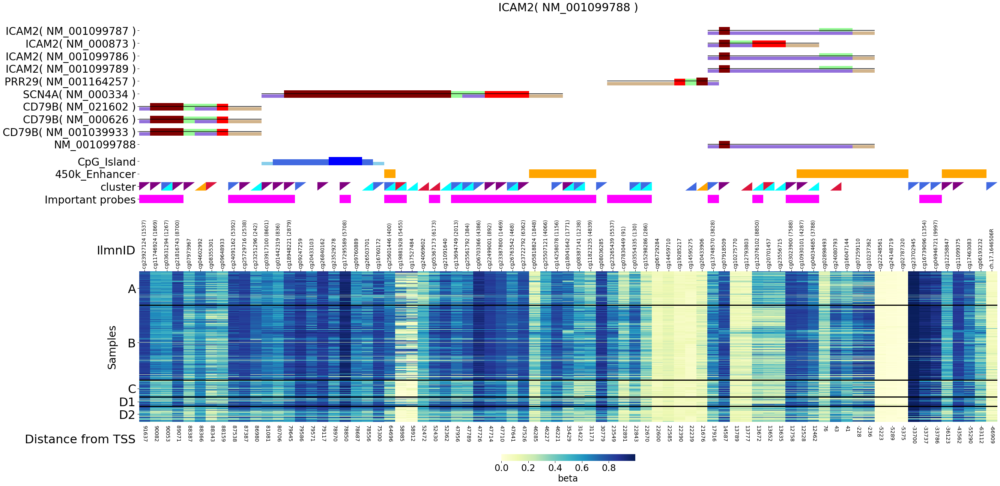

NM_001099787 ICAM2 - 62097994.0 62079954.0 62097994.0
140
69085 NM_001039933 170
32296 NM_000626 200
20576 NM_021602 230
29603 NM_000334 260
40485 NM_001164257 290
37200 NM_001099789 320
36417 NM_001099786 350
30515 NM_000873 380
28891 NM_001099788 410
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001099787', 'CD79B( NM_001039933 )', 'CD79B( NM_000626 )', 'CD79B( NM_021602 )', 'SCN4A( NM_000334 )', 'PRR29( NM_001164257 )', 'ICAM2( NM_001099789 )', 'ICAM2( NM_001099786 )', 'ICAM2( NM_000873 )', 'ICAM2( NM_001099788 )']
fin 410


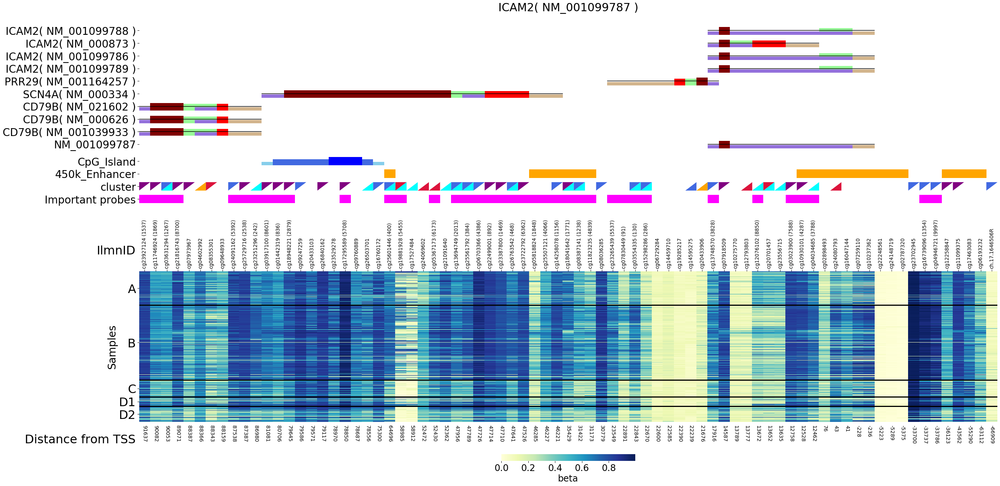

NM_001099786 ICAM2 - 62097994.0 62079954.0 62097994.0
140
69085 NM_001039933 170
32296 NM_000626 200
20576 NM_021602 230
29603 NM_000334 260
40485 NM_001164257 290
37200 NM_001099789 320
30515 NM_000873 350
47392 NM_001099787 380
28891 NM_001099788 410
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001099786', 'CD79B( NM_001039933 )', 'CD79B( NM_000626 )', 'CD79B( NM_021602 )', 'SCN4A( NM_000334 )', 'PRR29( NM_001164257 )', 'ICAM2( NM_001099789 )', 'ICAM2( NM_000873 )', 'ICAM2( NM_001099787 )', 'ICAM2( NM_001099788 )']
fin 410


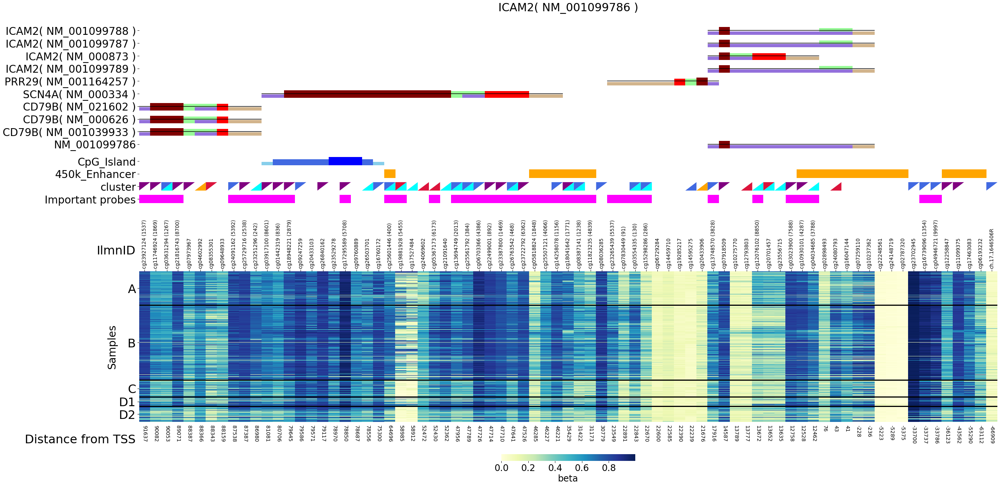

NM_000334 SCN4A - 62050278.0 62015913.0 62050278.0
140
4506 NM_022645 170
4507 NM_022644 200
36167 NM_020991 230
41607 NM_022556 260
27728 NM_022558 290
27729 NM_022557 320
51373 NM_002059 350
49502 NM_001317 380
13742 NM_022581 410
29393 NM_022579 440
10939 NM_022580 470
43477 NM_001318 500
67818 NM_022560 530
47838 NM_000515 560
67819 NM_022559 590
20576 NM_021602 620
69085 NM_001039933 650
32296 NM_000626 680
40485 NM_001164257 710
47392 NM_001099787 740
36417 NM_001099786 770
30515 NM_000873 800
28891 NM_001099788 830
37200 NM_001099789 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_000334', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_022556 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', 'GH2( NM_002059 )', 'CSH1( NM_001317 )', 'CSHL1( NM_022581 )', 'CSHL1( NM_022579 )', 'CSHL1( NM_022580 )', 

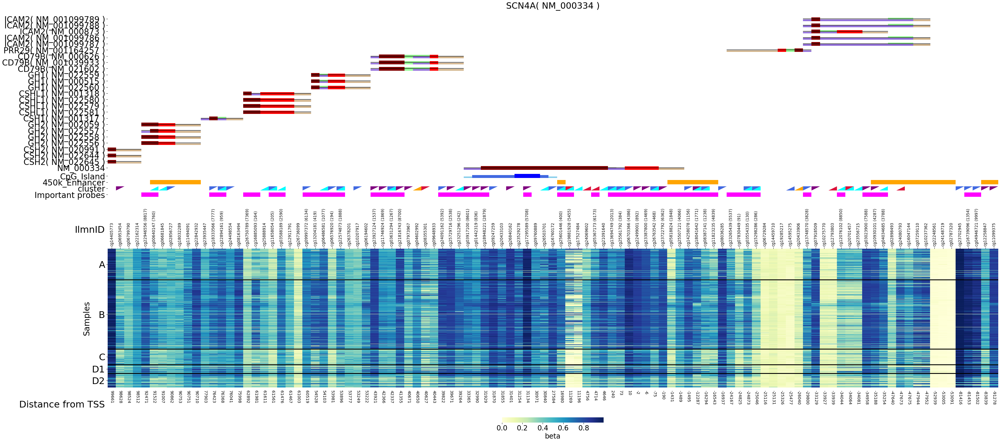

NM_014229 SLC6A11 + 10857912.0 10857912.0 10982400.0
140
40327 NR_027102 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_014229', 'LINC00606( NR_027102 )']
fin 170


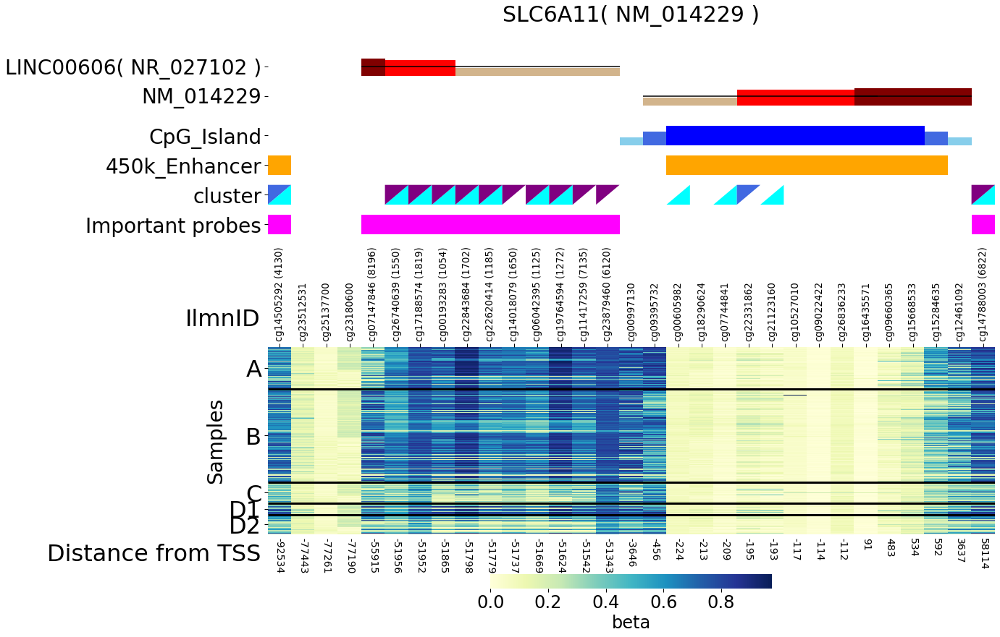

NM_001317406 SLC6A11 + 10857912.0 10857912.0 10875485.0
NM_005408 CCL13 + 32683498.0 32683498.0 32685629.0
140
48604 NM_006273 170
12628 NM_002986 200
22061 NM_005623 230
12637 NM_002981 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_005408', 'CCL7( NM_006273 )', 'CCL11( NM_002986 )', 'CCL8( NM_005623 )', 'CCL1( NM_002981 )']
fin 260


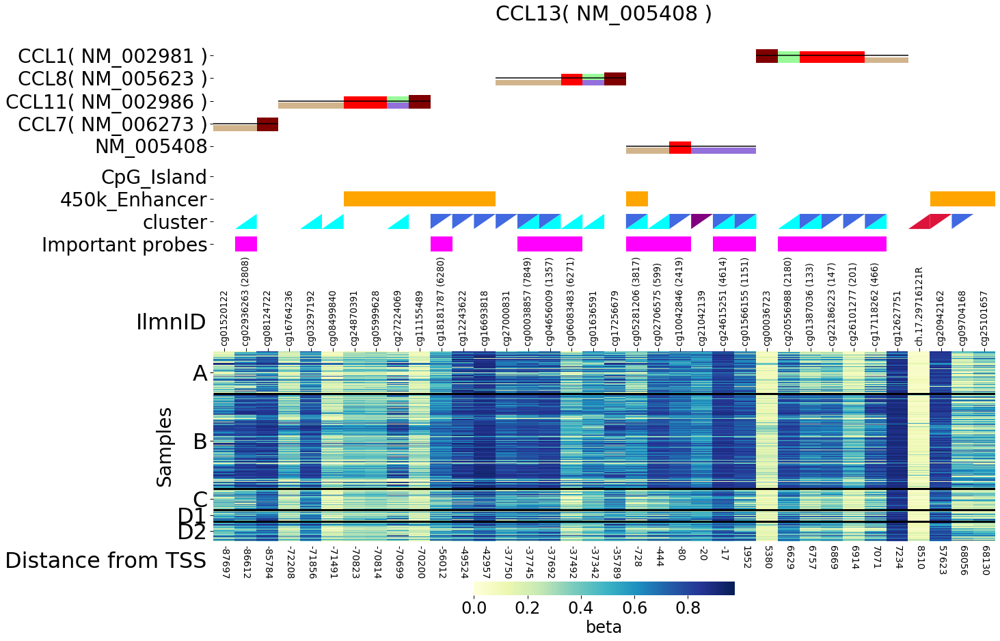

NM_002981 CCL1 - 32690252.0 32687346.0 32690252.0
140
48604 NM_006273 170
12628 NM_002986 200
22061 NM_005623 230
62780 NM_005408 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_002981', 'CCL7( NM_006273 )', 'CCL11( NM_002986 )', 'CCL8( NM_005623 )', 'CCL13( NM_005408 )']
fin 260


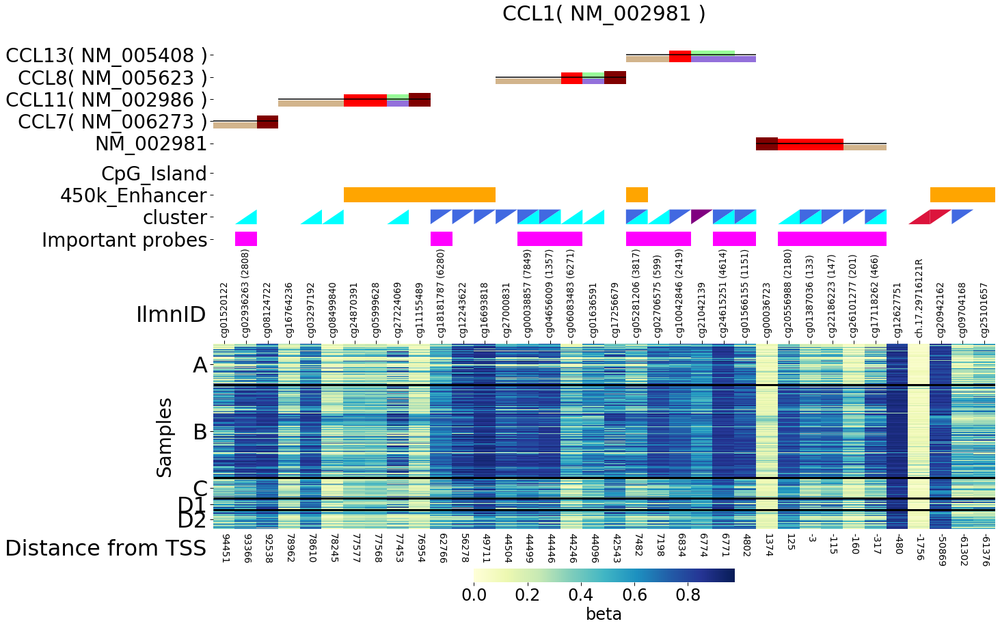

NM_001098668 SFTPA2 - 81320163.0 81315607.0 81320163.0
140
66222 NM_001099692 170
23528 NM_001093770 200
31762 NM_001164647 230
41750 NM_001164646 260
41751 NM_001164645 290
41752 NM_001164644 320
60465 NM_005411 350
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001098668', 'EIF5AL1( NM_001099692 )', 'SFTPA1( NM_001093770 )', 'SFTPA1( NM_001164647 )', 'SFTPA1( NM_001164646 )', 'SFTPA1( NM_001164645 )', 'SFTPA1( NM_001164644 )', 'SFTPA1( NM_005411 )']
fin 350


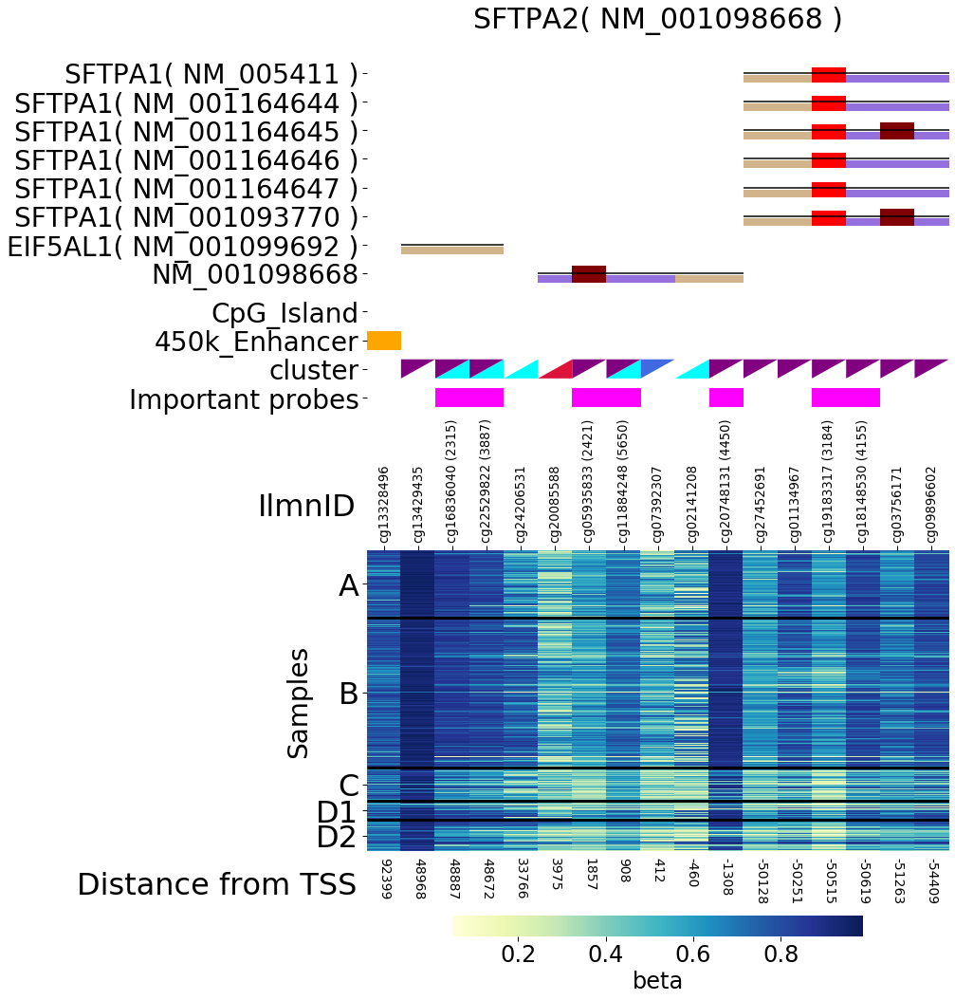

NM_001171174 CX3CR1 - 39323226.0 39304984.0 39323226.0
140
77568 NM_194293 170
31412 NM_001171172 200
31413 NM_001171171 230
45327 NM_001337 260
43892 NM_005201 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001171174', 'XIRP1( NM_194293 )', 'CX3CR1( NM_001171172 )', 'CX3CR1( NM_001171171 )', 'CX3CR1( NM_001337 )', 'CCR8( NM_005201 )']
fin 290


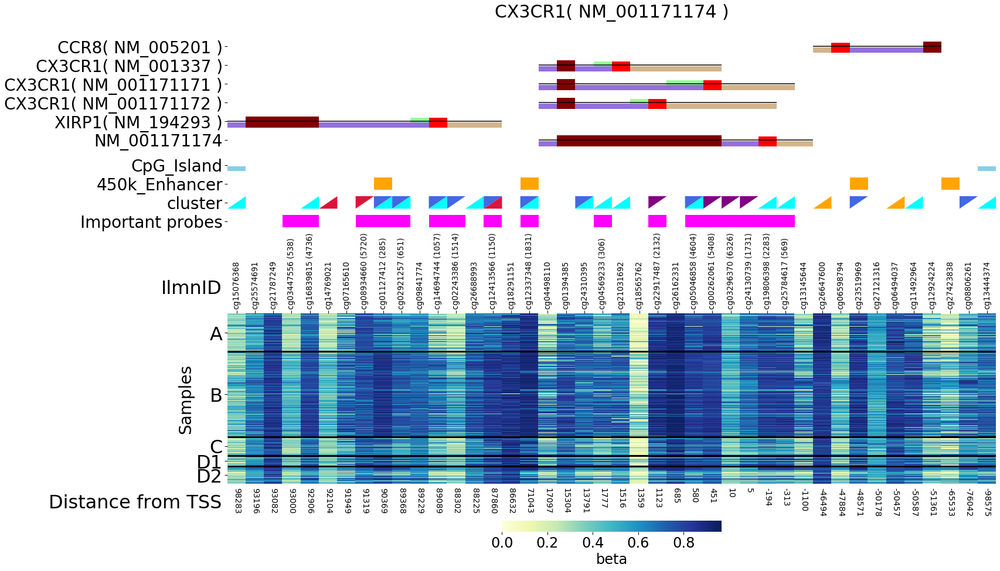

NM_001171171 CX3CR1 - 39322764.0 39304984.0 39322764.0
140
77568 NM_194293 170
27672 NM_001171174 200
31412 NM_001171172 230
45327 NM_001337 260
43892 NM_005201 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001171171', 'XIRP1( NM_194293 )', 'CX3CR1( NM_001171174 )', 'CX3CR1( NM_001171172 )', 'CX3CR1( NM_001337 )', 'CCR8( NM_005201 )']
fin 290


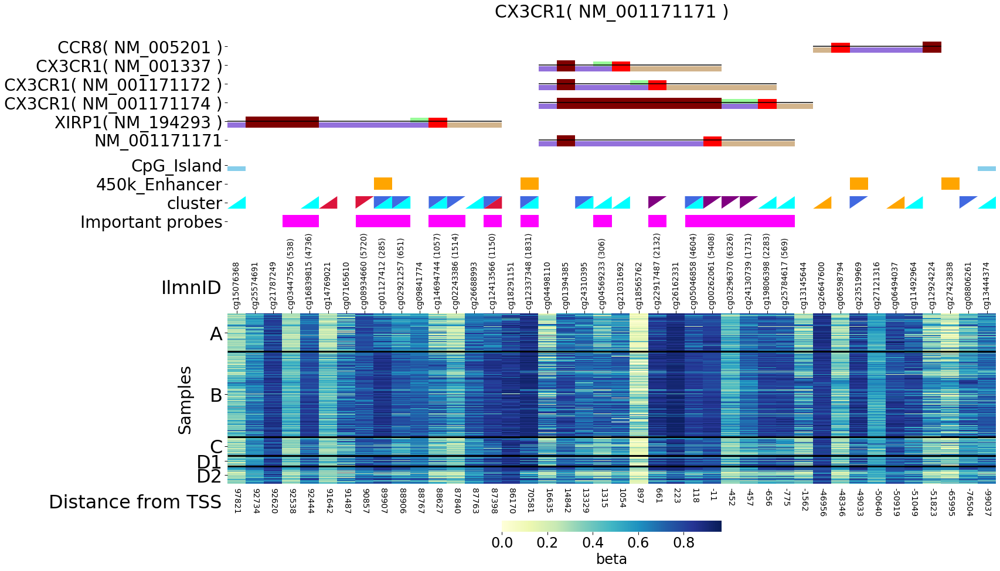

NM_005928 MFGE8 - 89456610.0 89441913.0 89456610.0
140
16000 NM_001135 170
57772 NM_013227 200
76668 NM_178232 230
70434 NM_001114614 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_005928', 'ACAN( NM_001135 )', 'ACAN( NM_013227 )', 'HAPLN3( NM_178232 )', 'MFGE8( NM_001114614 )']
fin 260


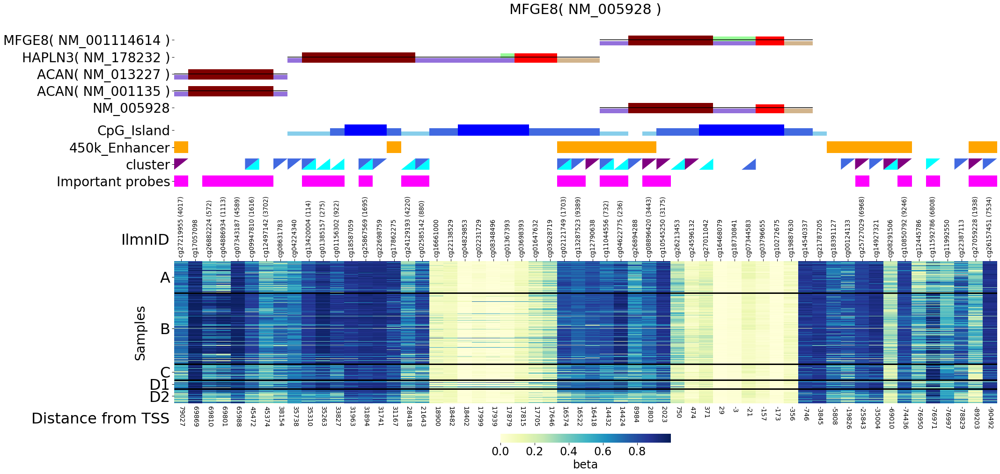

NM_001310320 MFGE8 - 89456610.0 89441913.0 89456610.0
NM_001114614 MFGE8 - 89456610.0 89441913.0 89456610.0
140
16000 NM_001135 170
57772 NM_013227 200
76668 NM_178232 230
19224 NM_005928 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001114614', 'ACAN( NM_001135 )', 'ACAN( NM_013227 )', 'HAPLN3( NM_178232 )', 'MFGE8( NM_005928 )']
fin 260


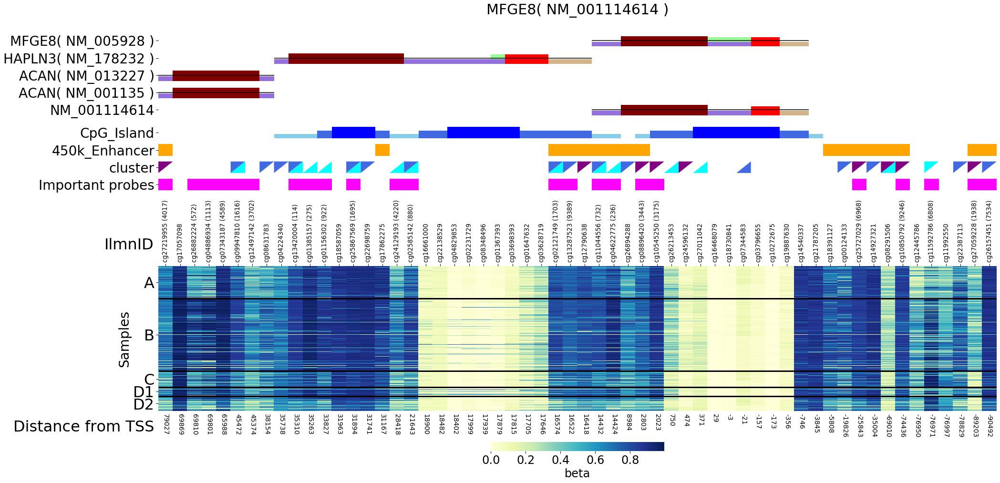

NM_001310321 MFGE8 - 89456399.0 89441913.0 89456399.0
NM_001310319 MFGE8 - 89456610.0 89441913.0 89456610.0
NM_175078 KRT77 - 53097308.0 53083409.0 53097308.0
140
74515 NM_175068 170
3691 NM_000423 200
54009 NM_006121 230
67264 NM_015848 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_175078', 'KRT73( NM_175068 )', 'KRT2( NM_000423 )', 'KRT1( NM_006121 )', 'KRT76( NM_015848 )']
fin 260


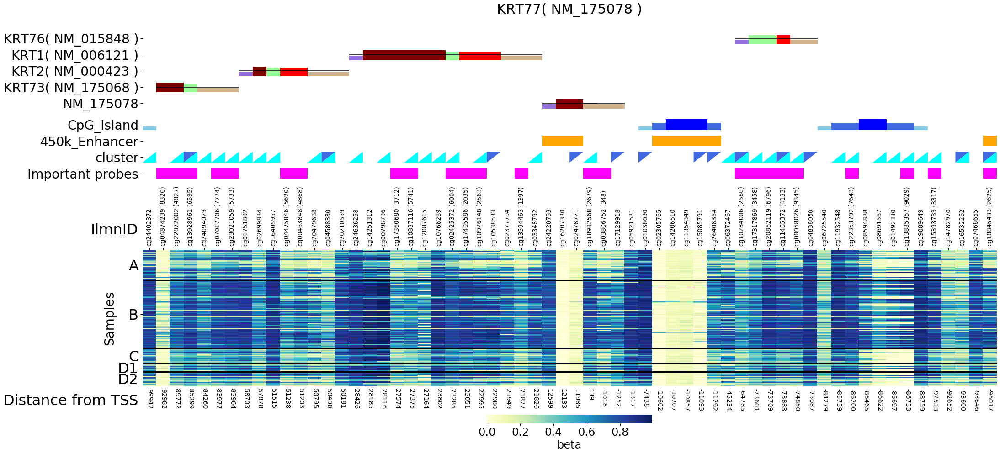

NM_001135 ACAN + 89346673.0 89346673.0 89418585.0
140
57772 NM_013227 170
76668 NM_178232 200
[20, 50, 80, 110, 150, 180, 210]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001135', 'ACAN( NM_013227 )', 'HAPLN3( NM_178232 )']
fin 200


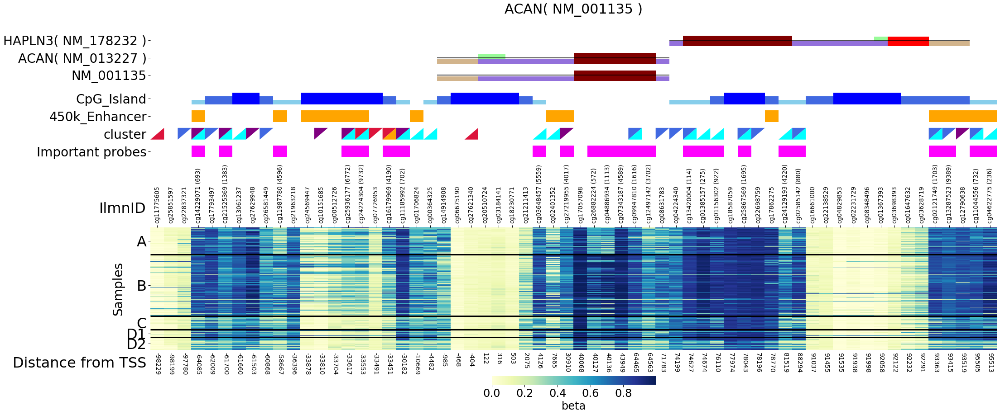

NM_013227 ACAN + 89346673.0 89346673.0 89418585.0
140
16000 NM_001135 170
76668 NM_178232 200
[20, 50, 80, 110, 150, 180, 210]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_013227', 'ACAN( NM_001135 )', 'HAPLN3( NM_178232 )']
fin 200


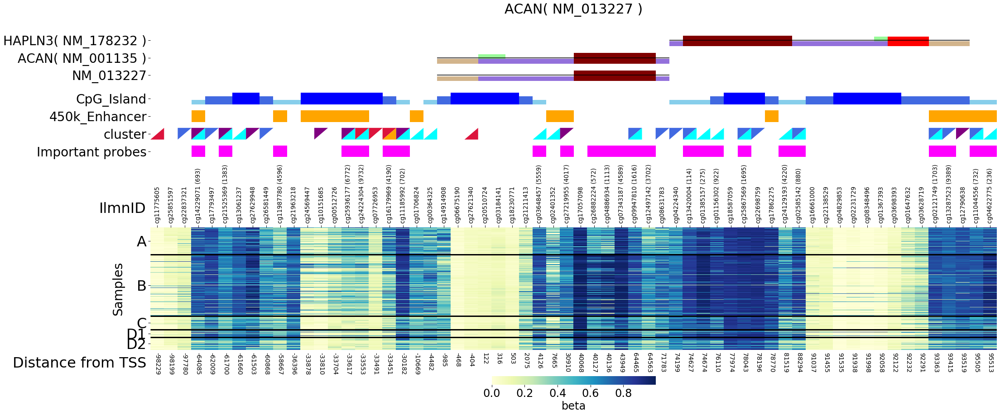

NM_001010939 LIPJ + 90346518.0 90346518.0 90366733.0
140
14511 NM_018363 170
27916 NM_001031709 200
15440 NM_004190 230
[20, 50, 80, 110, 150, 180, 210, 240]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001010939', 'RNLS( NM_018363 )', 'RNLS( NM_001031709 )', 'LIPF( NM_004190 )']
fin 230


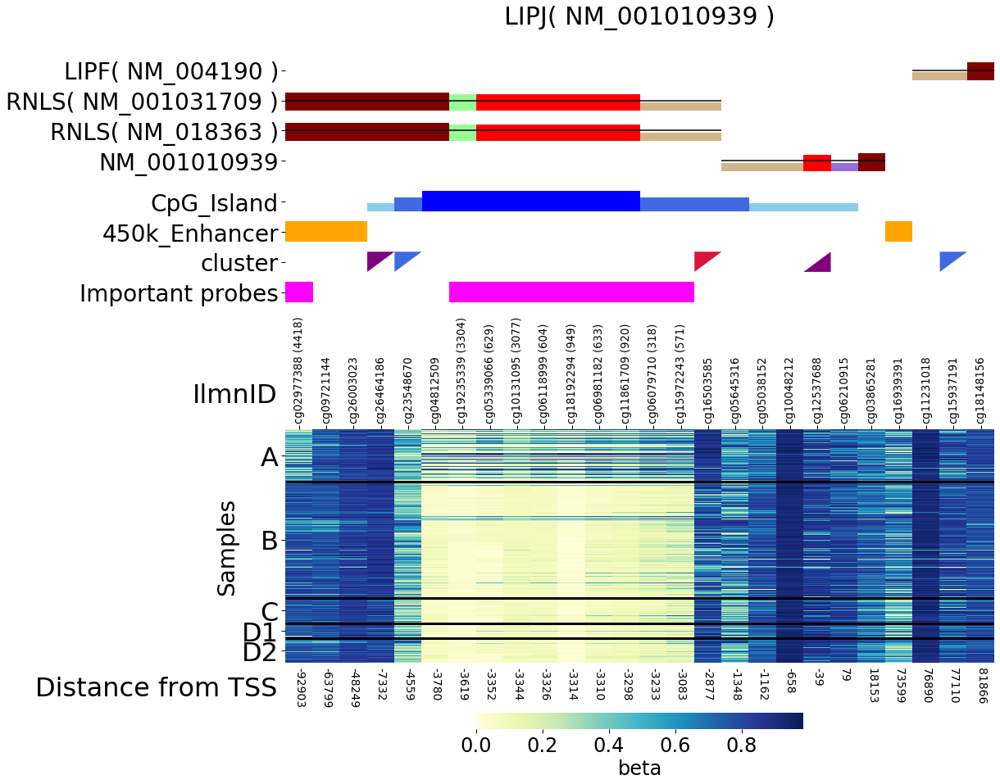

NM_018363 RNLS - 90343082.0 90033620.0 90343082.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_018363']
fin 140


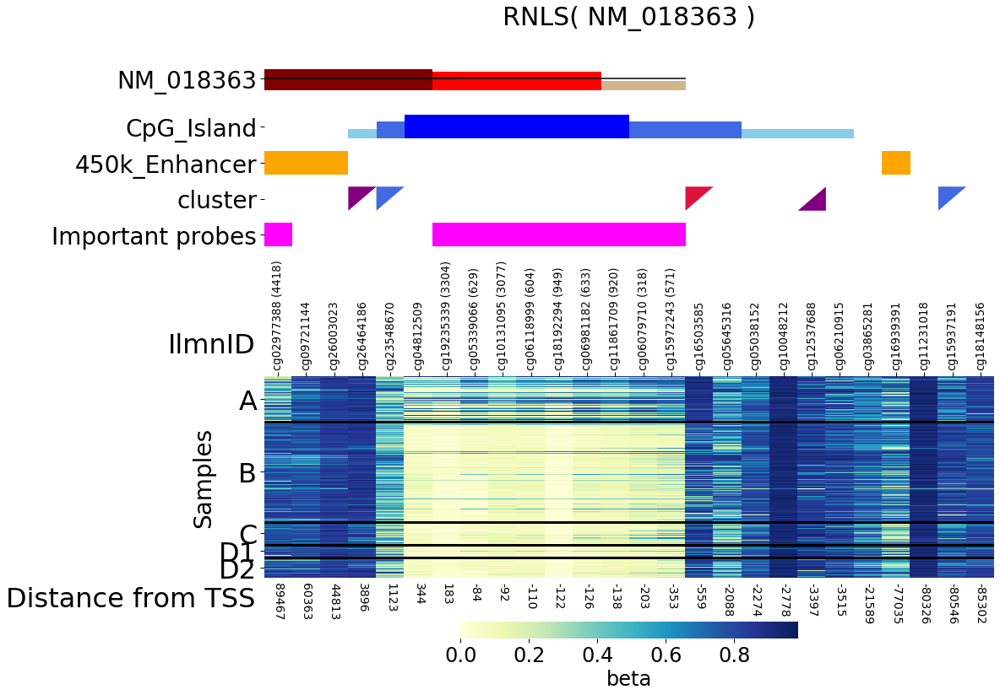

NM_017667 VPS50 + 92861678.0 92861678.0 92990435.0
140
7452 NM_152703 170
46519 NM_198151 200
60215 NM_001039372 230
49494 NM_024553 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_017667', 'SAMD9L( NM_152703 )', 'HEPACAM2( NM_198151 )', 'HEPACAM2( NM_001039372 )', 'VPS50( NM_024553 )']
fin 260


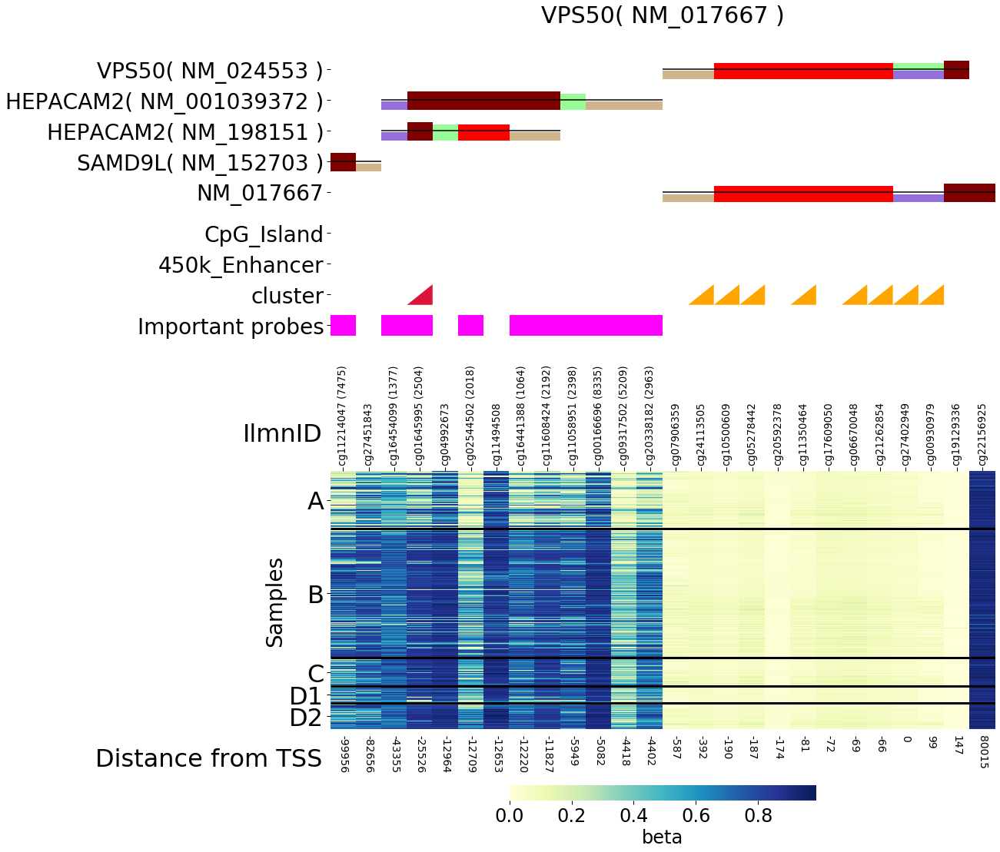

NM_001031709 RNLS - 90343075.0 90043858.0 90343075.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001031709']
fin 140


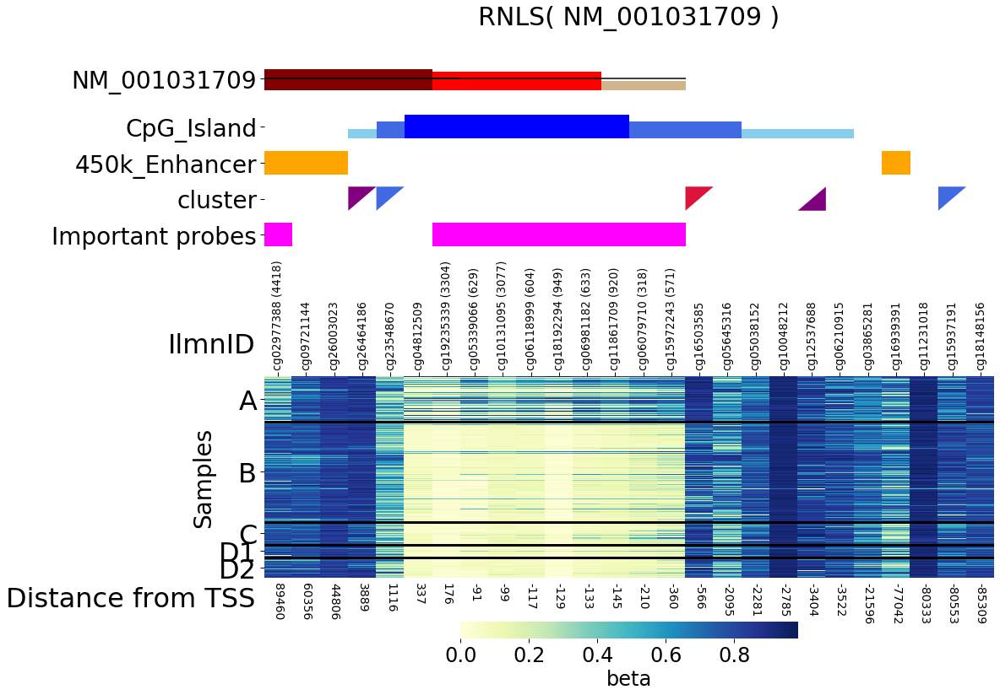

NM_024553 VPS50 + 92861652.0 92861652.0 92905737.0
140
7452 NM_152703 170
46519 NM_198151 200
60215 NM_001039372 230
[20, 50, 80, 110, 150, 180, 210, 240]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_024553', 'SAMD9L( NM_152703 )', 'HEPACAM2( NM_198151 )', 'HEPACAM2( NM_001039372 )']
fin 230


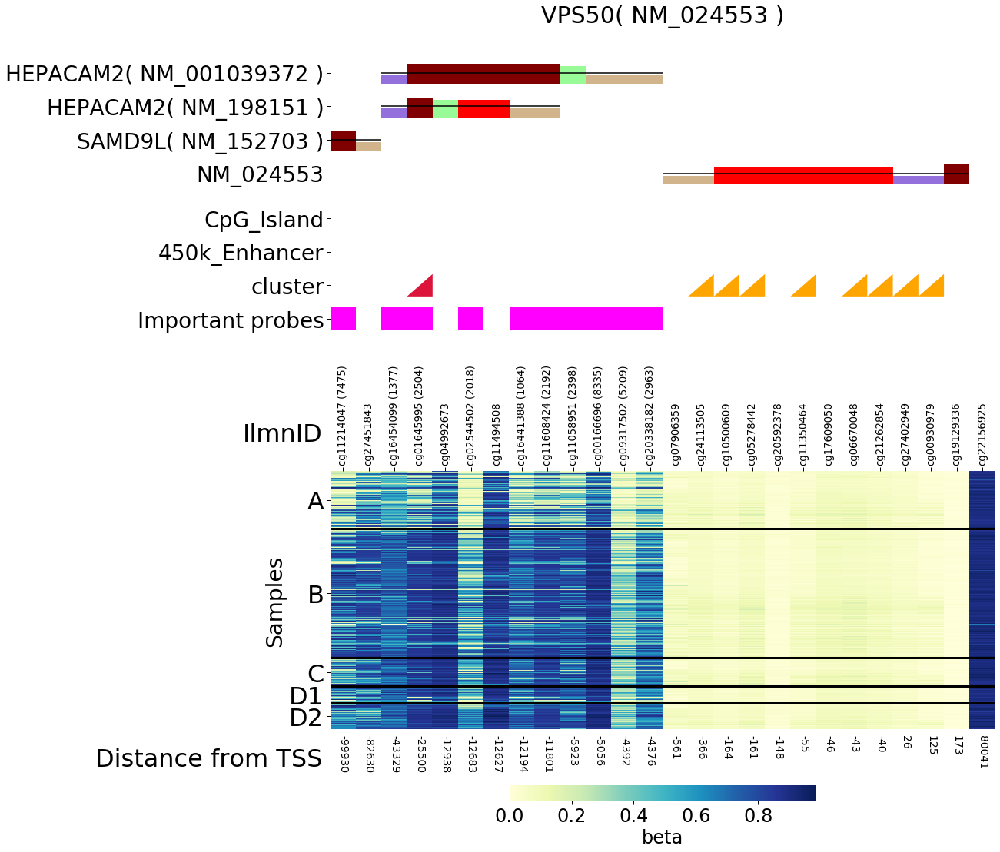

NM_001257998 VPS50 + 92861652.0 92861652.0 92990435.0
NM_002986 CCL11 + 32612760.0 32612760.0 32615353.0
140
12634 NM_002982 170
48604 NM_006273 200
22061 NM_005623 230
62780 NM_005408 260
12637 NM_002981 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_002986', 'CCL2( NM_002982 )', 'CCL7( NM_006273 )', 'CCL8( NM_005623 )', 'CCL13( NM_005408 )', 'CCL1( NM_002981 )']
fin 290


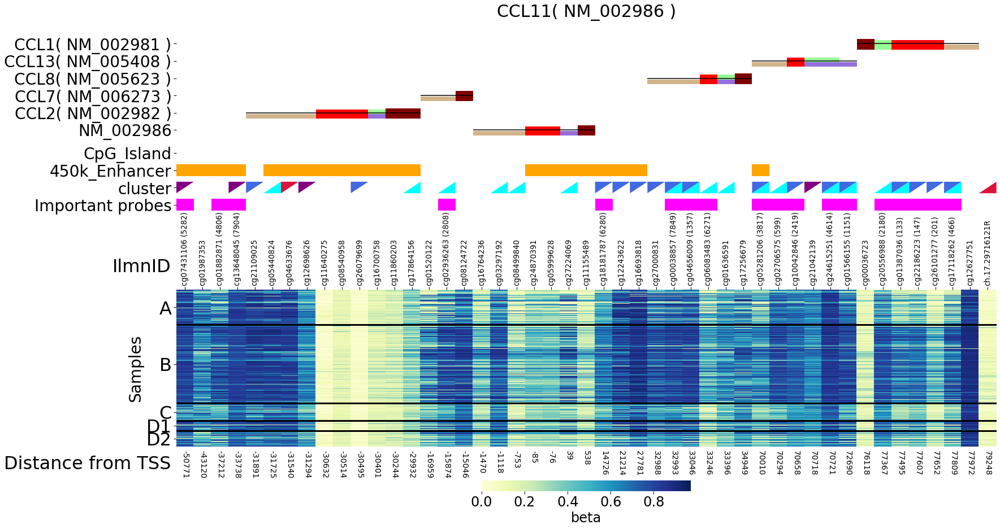

NM_001039933 CD79B - 62009691.0 62006099.0 62009691.0
140
12215 NM_001098426 170
26703 NR_002947 200
4506 NM_022645 230
4507 NM_022644 260
36167 NM_020991 290
41607 NM_022556 320
27728 NM_022558 350
27729 NM_022557 380
51373 NM_002059 410
49502 NM_001317 440
10939 NM_022580 470
29393 NM_022579 500
43477 NM_001318 530
13742 NM_022581 560
47838 NM_000515 590
67818 NM_022560 620
67819 NM_022559 650
20576 NM_021602 680
32296 NM_000626 710
29603 NM_000334 740
40485 NM_001164257 770
37200 NM_001099789 800
47392 NM_001099787 830
30515 NM_000873 860
28891 NM_001099788 890
36417 NM_001099786 920
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900, 930]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001039933', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_022556 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', '

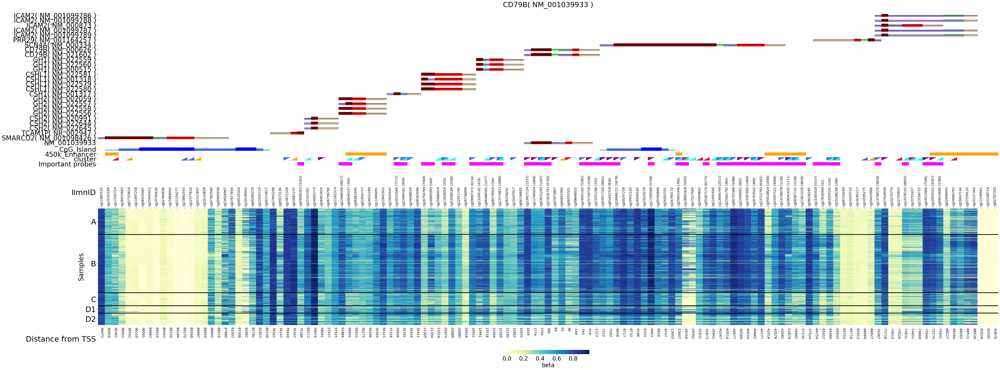

NM_021602 CD79B - 62009691.0 62006099.0 62009691.0
140
12215 NM_001098426 170
26703 NR_002947 200
4506 NM_022645 230
4507 NM_022644 260
36167 NM_020991 290
41607 NM_022556 320
27728 NM_022558 350
27729 NM_022557 380
51373 NM_002059 410
49502 NM_001317 440
10939 NM_022580 470
29393 NM_022579 500
43477 NM_001318 530
13742 NM_022581 560
47838 NM_000515 590
67818 NM_022560 620
67819 NM_022559 650
69085 NM_001039933 680
32296 NM_000626 710
29603 NM_000334 740
40485 NM_001164257 770
37200 NM_001099789 800
47392 NM_001099787 830
30515 NM_000873 860
28891 NM_001099788 890
36417 NM_001099786 920
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900, 930]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_021602', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_022556 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', 'GH2

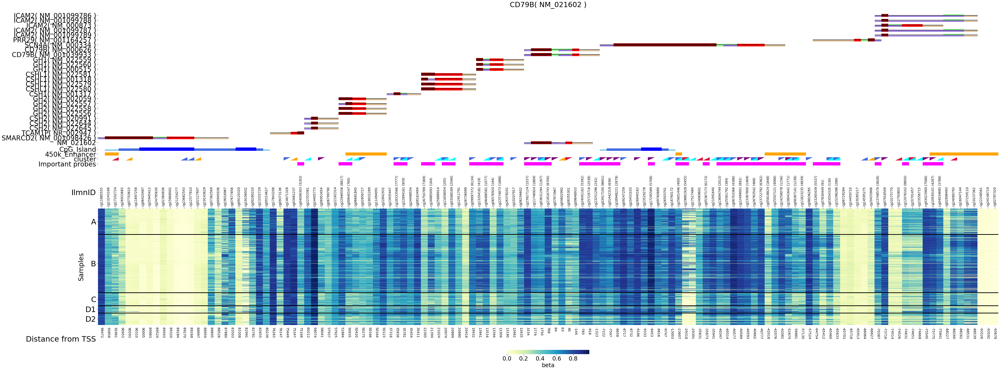

NM_000626 CD79B - 62009691.0 62006099.0 62009691.0
140
12215 NM_001098426 170
26703 NR_002947 200
4506 NM_022645 230
4507 NM_022644 260
36167 NM_020991 290
41607 NM_022556 320
27728 NM_022558 350
27729 NM_022557 380
51373 NM_002059 410
49502 NM_001317 440
10939 NM_022580 470
29393 NM_022579 500
43477 NM_001318 530
13742 NM_022581 560
47838 NM_000515 590
67818 NM_022560 620
67819 NM_022559 650
20576 NM_021602 680
69085 NM_001039933 710
29603 NM_000334 740
40485 NM_001164257 770
37200 NM_001099789 800
47392 NM_001099787 830
30515 NM_000873 860
28891 NM_001099788 890
36417 NM_001099786 920
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900, 930]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_000626', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_022556 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', 'GH2

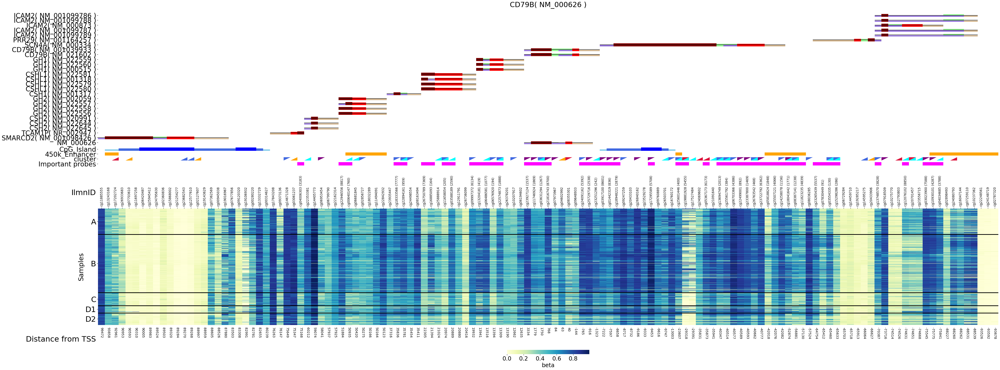

NR_038941 KIAA1671-AS1 - 25508659.0 25498383.0 25508659.0
NM_015848 KRT76 - 53171129.0 53161938.0 53171129.0
140
54009 NM_006121 170
74505 NM_175078 200
45697 NM_057088 230
22911 NM_002272 260
76616 NM_175834 290
76123 NM_173352 320
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_015848', 'KRT1( NM_006121 )', 'KRT77( NM_175078 )', 'KRT3( NM_057088 )', 'KRT4( NM_002272 )', 'KRT79( NM_175834 )', 'KRT78( NM_173352 )']
fin 320


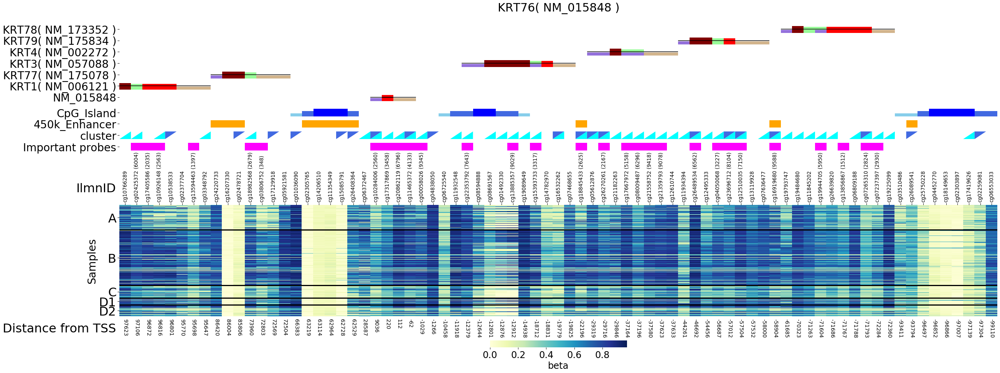

NM_005623 CCL8 + 32646453.0 32646453.0 32648421.0
140
12634 NM_002982 170
48604 NM_006273 200
12628 NM_002986 230
62780 NM_005408 260
12637 NM_002981 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_005623', 'CCL2( NM_002982 )', 'CCL7( NM_006273 )', 'CCL11( NM_002986 )', 'CCL13( NM_005408 )', 'CCL1( NM_002981 )']
fin 290


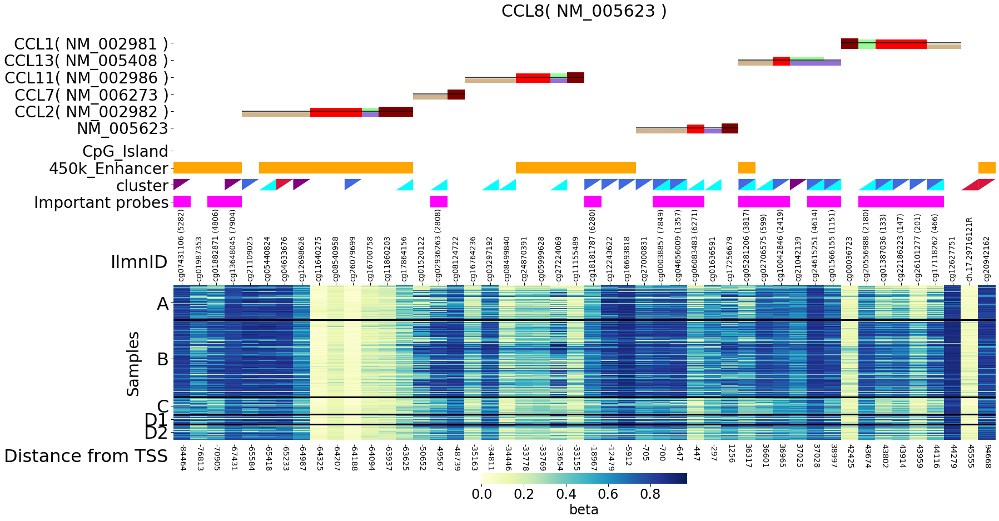

NM_152512 ENTHD1 - 40289764.0 40139048.0 40289764.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_152512']
fin 140


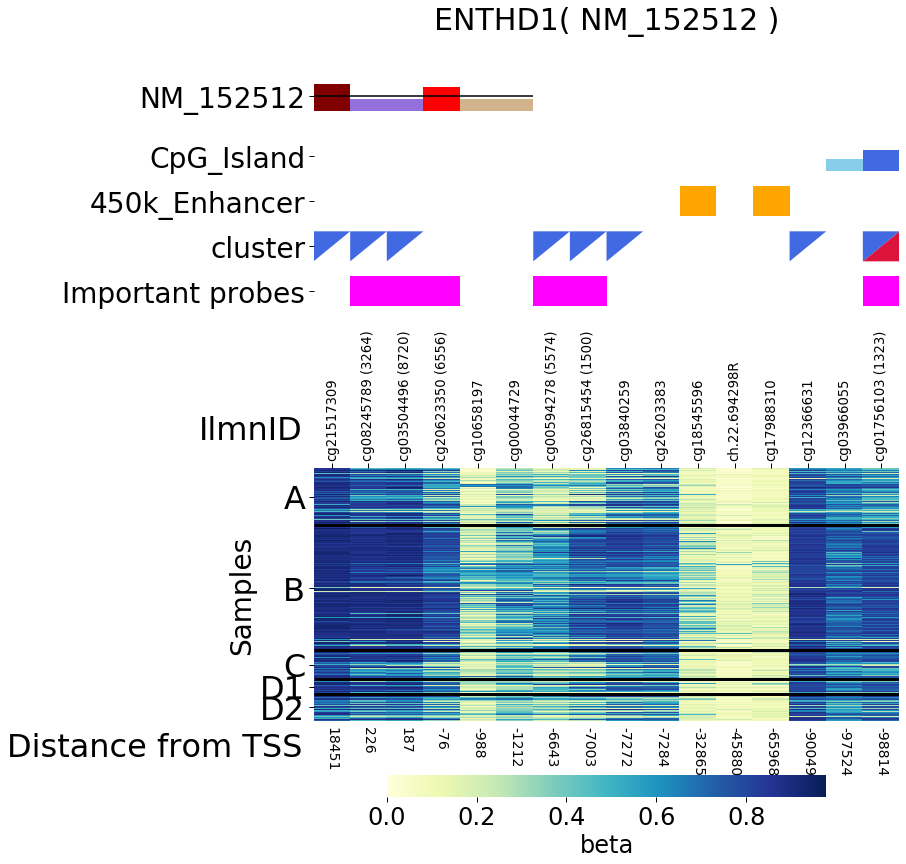

NR_110201 LINC01804 + 15830905.0 15830905.0 15859085.0
NM_198151 HEPACAM2 - 92848884.0 92817846.0 92848884.0
140
7452 NM_152703 170
60215 NM_001039372 200
49494 NM_024553 230
[20, 50, 80, 110, 150, 180, 210, 240]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_198151', 'SAMD9L( NM_152703 )', 'HEPACAM2( NM_001039372 )', 'VPS50( NM_024553 )']
fin 230


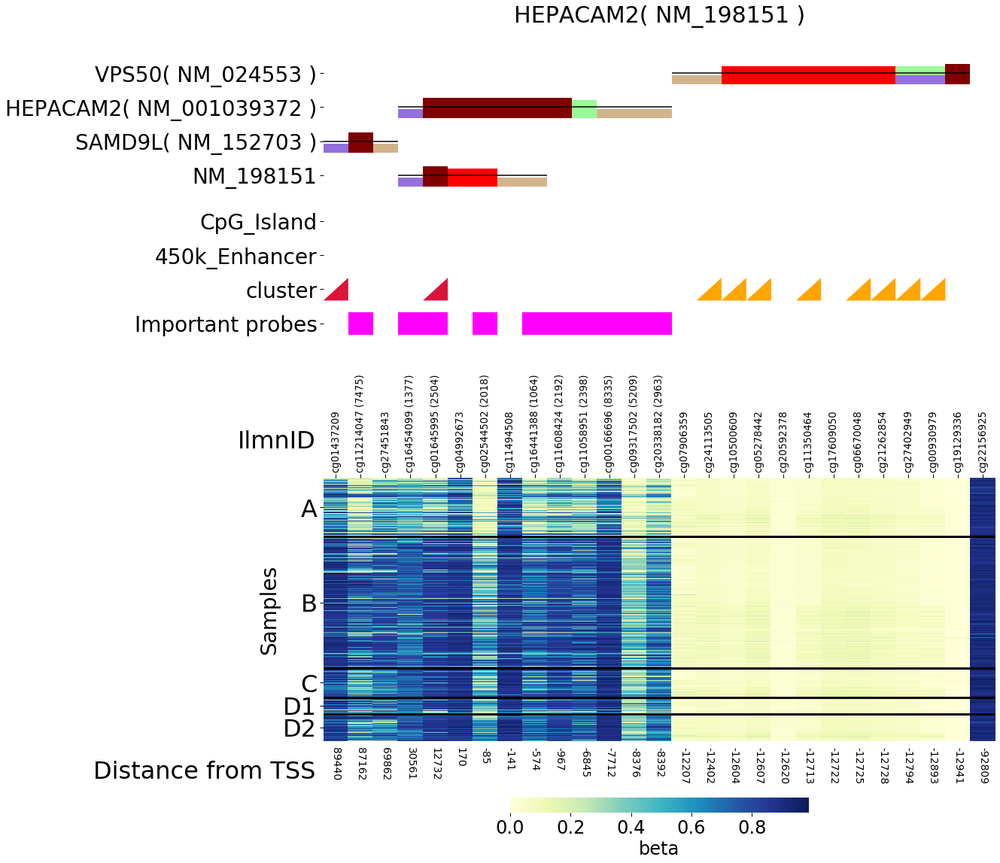

NM_001288804 HEPACAM2 - 92855782.0 92817846.0 92855782.0
NM_001288810 HEPACAM2 - 92848884.0 92817846.0 92848884.0
NM_001039372 HEPACAM2 - 92855782.0 92817846.0 92855782.0
140
7452 NM_152703 170
46519 NM_198151 200
49494 NM_024553 230
[20, 50, 80, 110, 150, 180, 210, 240]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001039372', 'SAMD9L( NM_152703 )', 'HEPACAM2( NM_198151 )', 'VPS50( NM_024553 )']
fin 230


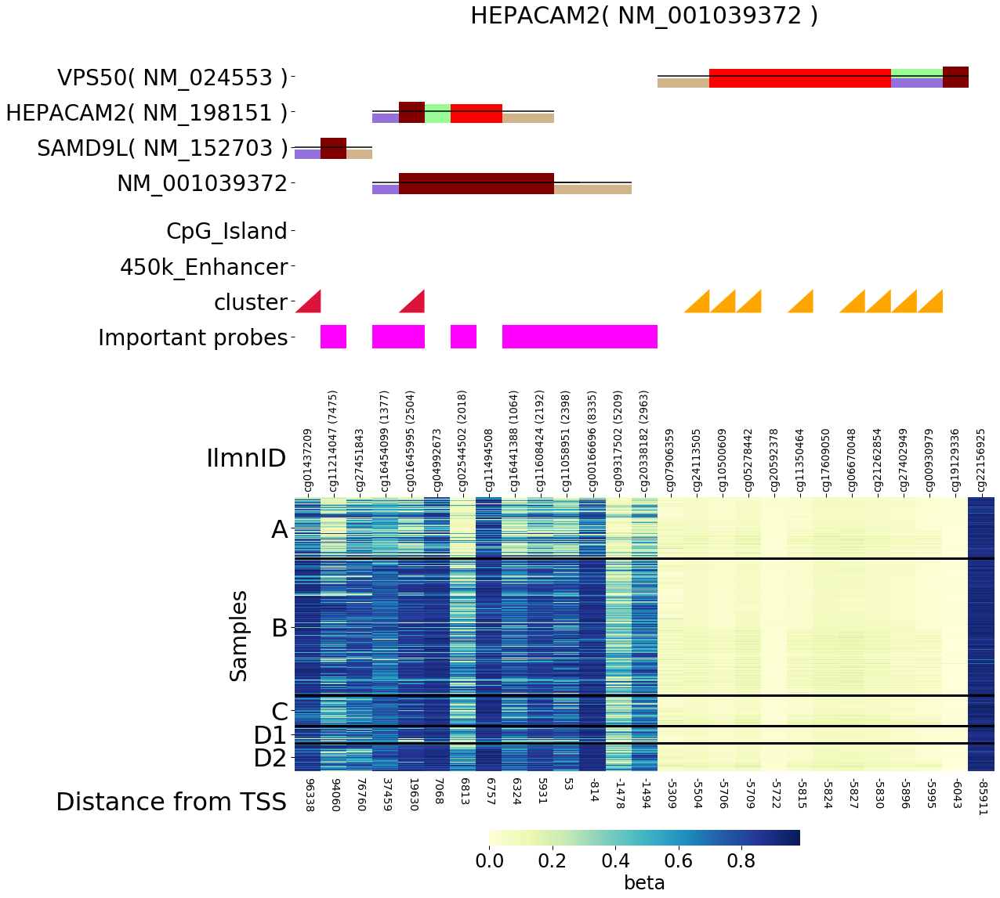

NM_057088 KRT3 - 53189901.0 53183468.0 53189901.0
140
74505 NM_175078 170
67264 NM_015848 200
22911 NM_002272 230
76616 NM_175834 260
76123 NM_173352 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_057088', 'KRT77( NM_175078 )', 'KRT76( NM_015848 )', 'KRT4( NM_002272 )', 'KRT79( NM_175834 )', 'KRT78( NM_173352 )']
fin 290


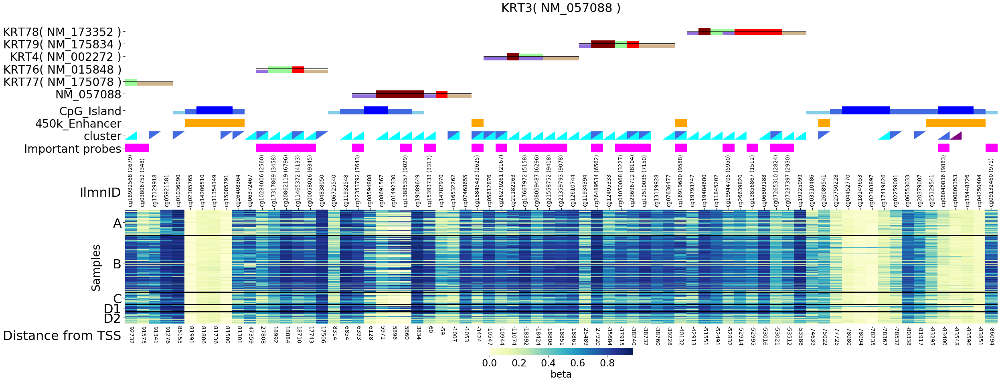

NR_027293 BMS1P20 + 22652462.0 22652462.0 22677324.0
140
57553 NM_007128 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NR_027293', 'VPREB1( NM_007128 )']
fin 170


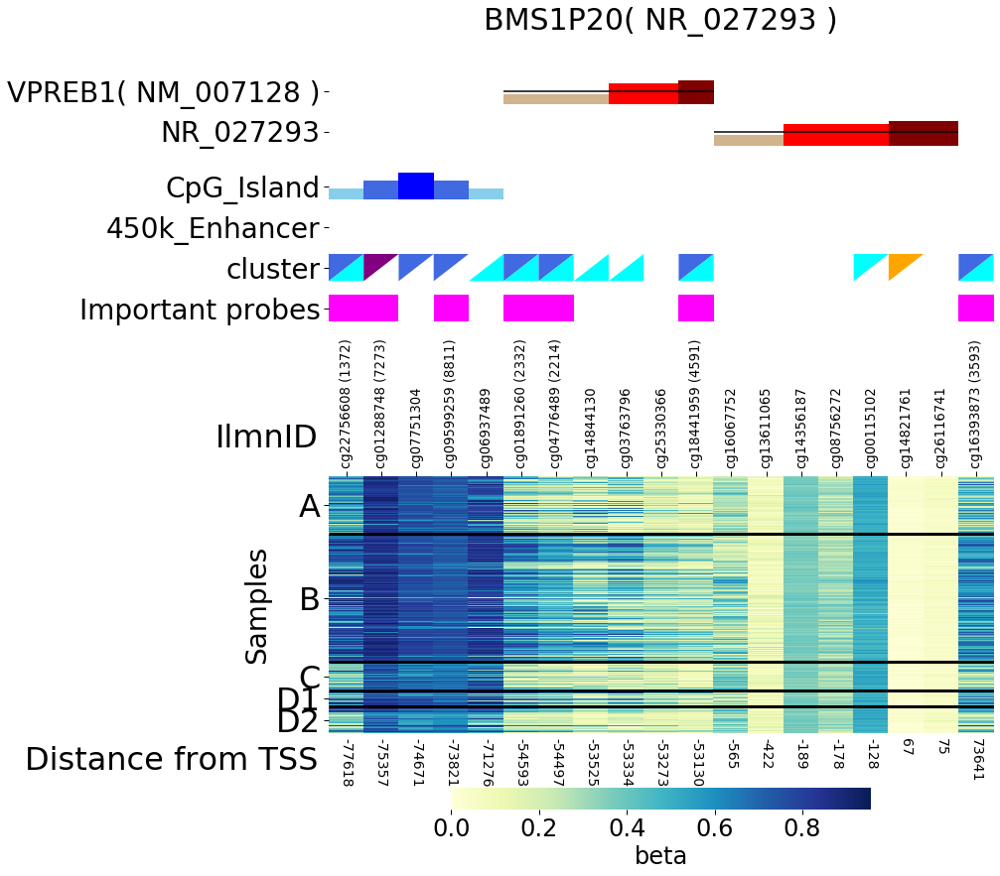

NM_001337 CX3CR1 - 39321527.0 39304986.0 39321527.0
140
77568 NM_194293 170
27672 NM_001171174 200
31412 NM_001171172 230
31413 NM_001171171 260
43892 NM_005201 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001337', 'XIRP1( NM_194293 )', 'CX3CR1( NM_001171174 )', 'CX3CR1( NM_001171172 )', 'CX3CR1( NM_001171171 )', 'CCR8( NM_005201 )']
fin 290


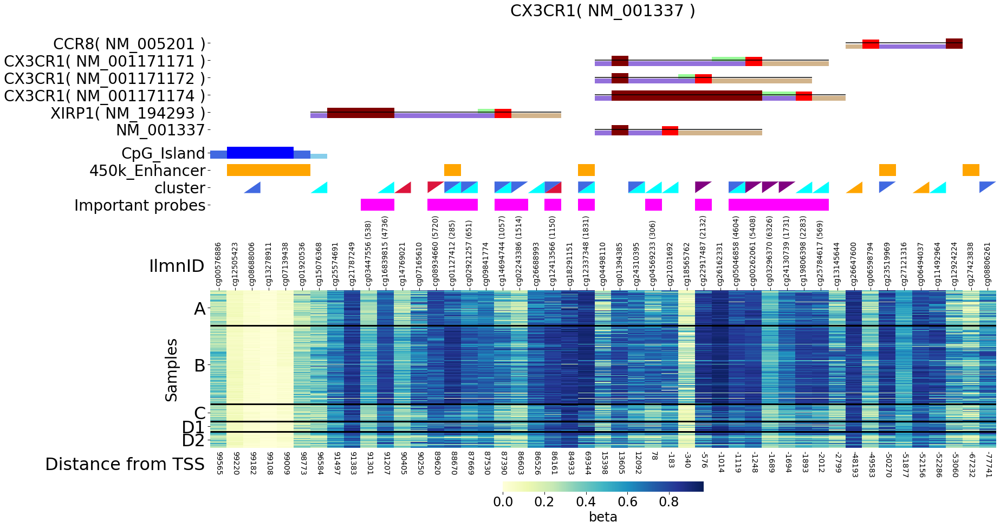

NM_004810 GRAP2 + 40297087.0 40297087.0 40369725.0
140
6613 NM_152512 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_004810', 'ENTHD1( NM_152512 )']
fin 170


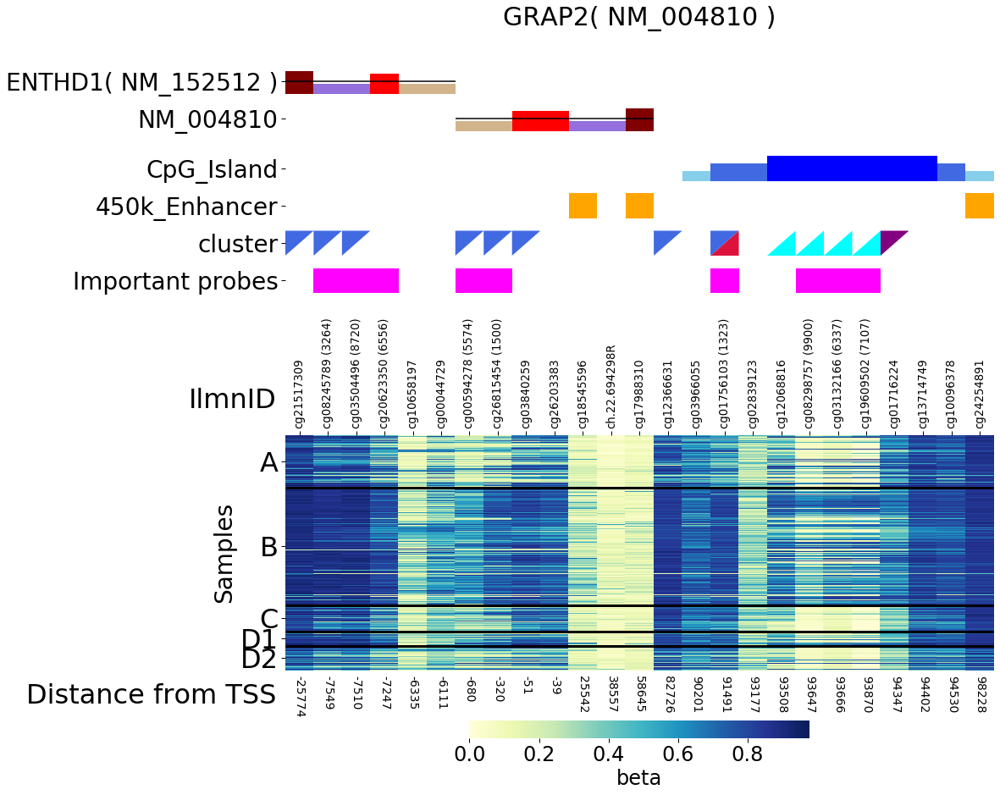

NM_006273 CCL7 + 32597239.0 32597239.0 32599261.0
140
12634 NM_002982 170
12628 NM_002986 200
22061 NM_005623 230
62780 NM_005408 260
12637 NM_002981 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_006273', 'CCL2( NM_002982 )', 'CCL11( NM_002986 )', 'CCL8( NM_005623 )', 'CCL13( NM_005408 )', 'CCL1( NM_002981 )']
fin 290


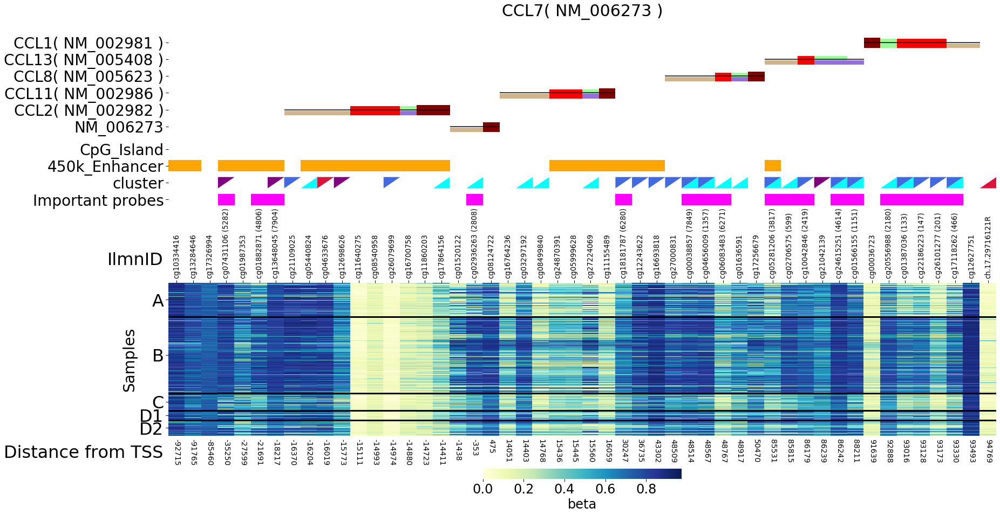

NM_020186 SDHAF3 + 96747009.0 96747009.0 96811075.0
140
9201 NM_005221 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_020186', 'DLX5( NM_005221 )']
fin 170


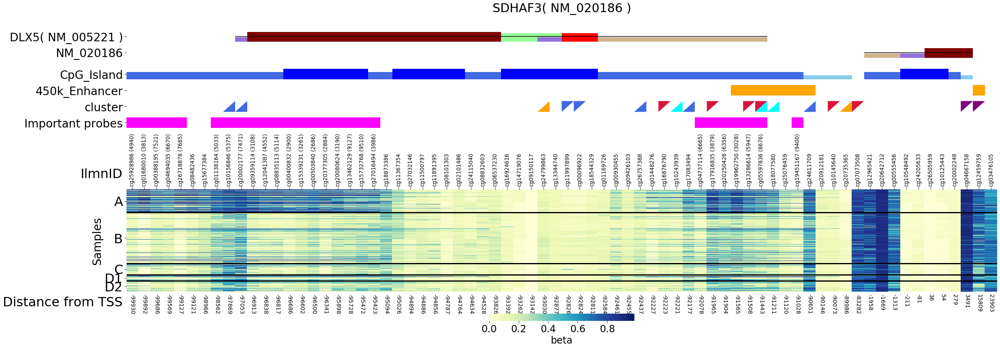

NM_001300814 KRT78 - 53242067.0 53231587.0 53242067.0
NM_004540 NCAM2 + 22370726.0 22370726.0 22915650.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_004540']
fin 140


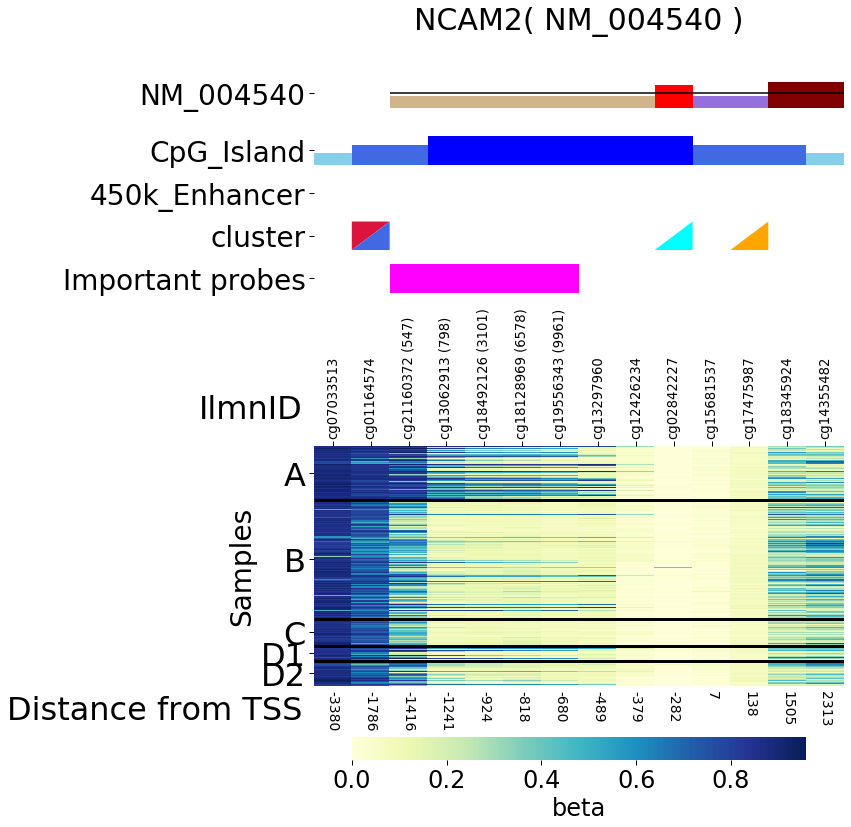

NM_001171172 CX3CR1 - 39321930.0 39304984.0 39321930.0
140
77568 NM_194293 170
27672 NM_001171174 200
31413 NM_001171171 230
45327 NM_001337 260
43892 NM_005201 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001171172', 'XIRP1( NM_194293 )', 'CX3CR1( NM_001171174 )', 'CX3CR1( NM_001171171 )', 'CX3CR1( NM_001337 )', 'CCR8( NM_005201 )']
fin 290


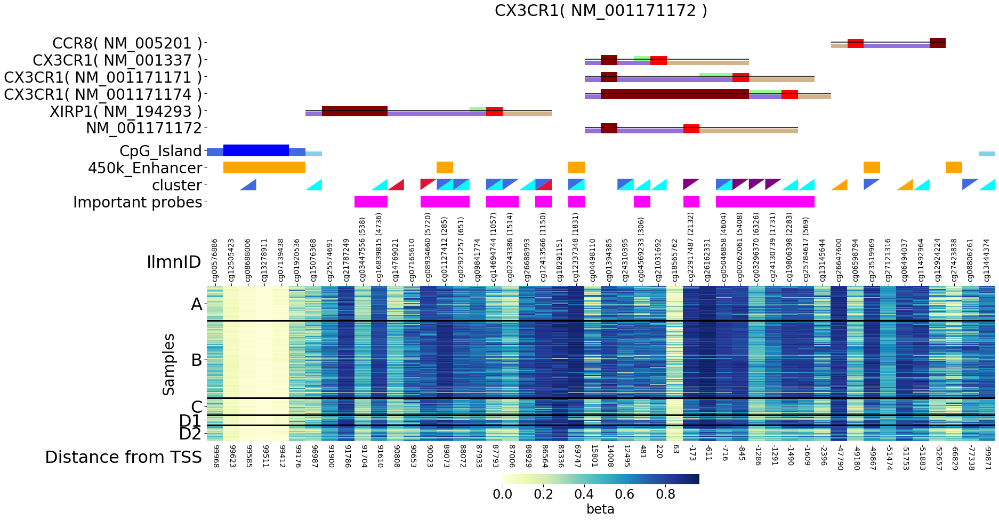

NR_027102 LINC00606 - 10805894.0 10801026.0 10805894.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NR_027102']
fin 140


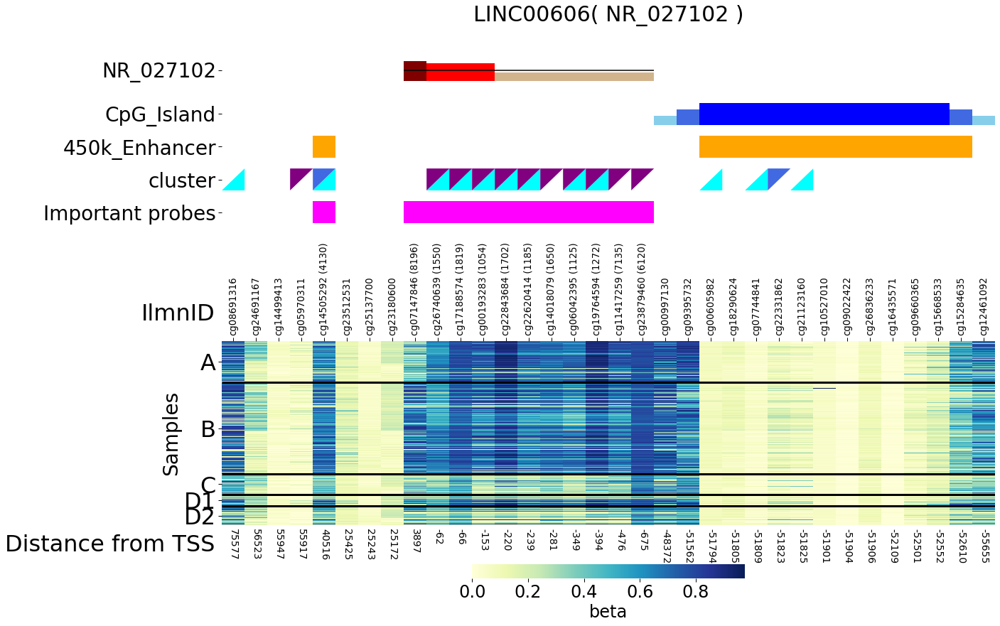

NM_000515 GH1 - 61996199.0 61994562.0 61996199.0
140
821 NM_017647 170
32933 NM_002805 200
12215 NM_001098426 230
26703 NR_002947 260
4506 NM_022645 290
4507 NM_022644 320
36167 NM_020991 350
51373 NM_002059 380
27728 NM_022558 410
27729 NM_022557 440
41607 NM_022556 470
49502 NM_001317 500
43477 NM_001318 530
10939 NM_022580 560
13742 NM_022581 590
29393 NM_022579 620
67819 NM_022559 650
67818 NM_022560 680
32296 NM_000626 710
69085 NM_001039933 740
20576 NM_021602 770
29603 NM_000334 800
40485 NM_001164257 830
30515 NM_000873 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_000515', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_002059 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', 'GH2( NM_022556 )', 'CSH1(

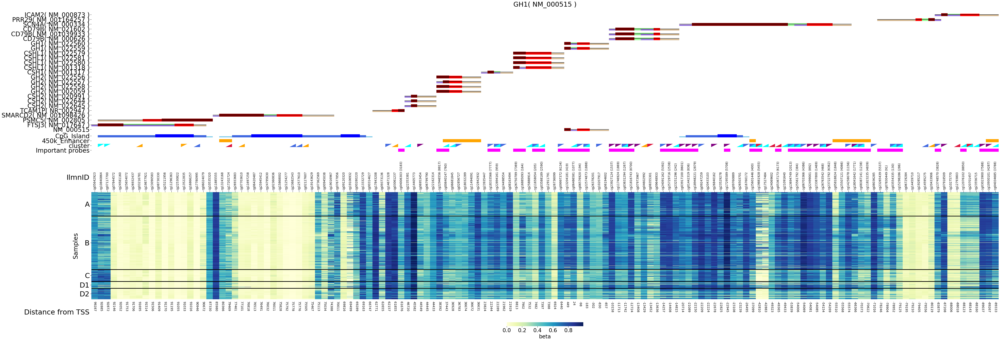

NM_022560 GH1 - 61996199.0 61994562.0 61996199.0
140
821 NM_017647 170
32933 NM_002805 200
12215 NM_001098426 230
26703 NR_002947 260
4506 NM_022645 290
4507 NM_022644 320
36167 NM_020991 350
51373 NM_002059 380
27728 NM_022558 410
27729 NM_022557 440
41607 NM_022556 470
49502 NM_001317 500
43477 NM_001318 530
10939 NM_022580 560
13742 NM_022581 590
29393 NM_022579 620
67819 NM_022559 650
47838 NM_000515 680
32296 NM_000626 710
69085 NM_001039933 740
20576 NM_021602 770
29603 NM_000334 800
40485 NM_001164257 830
30515 NM_000873 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022560', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_002059 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', 'GH2( NM_022556 )', 'CSH1(

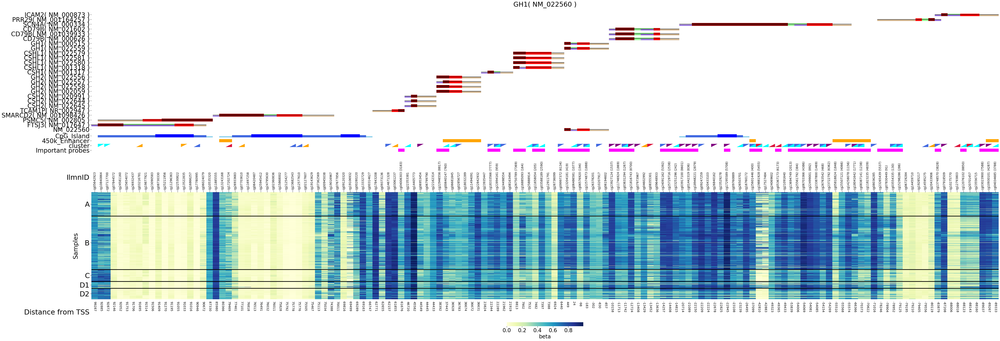

NM_022559 GH1 - 61996199.0 61994562.0 61996199.0
140
821 NM_017647 170
32933 NM_002805 200
12215 NM_001098426 230
26703 NR_002947 260
4506 NM_022645 290
4507 NM_022644 320
36167 NM_020991 350
51373 NM_002059 380
27728 NM_022558 410
27729 NM_022557 440
41607 NM_022556 470
49502 NM_001317 500
43477 NM_001318 530
10939 NM_022580 560
13742 NM_022581 590
29393 NM_022579 620
67818 NM_022560 650
47838 NM_000515 680
32296 NM_000626 710
69085 NM_001039933 740
20576 NM_021602 770
29603 NM_000334 800
40485 NM_001164257 830
30515 NM_000873 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022559', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_002059 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', 'GH2( NM_022556 )', 'CSH1(

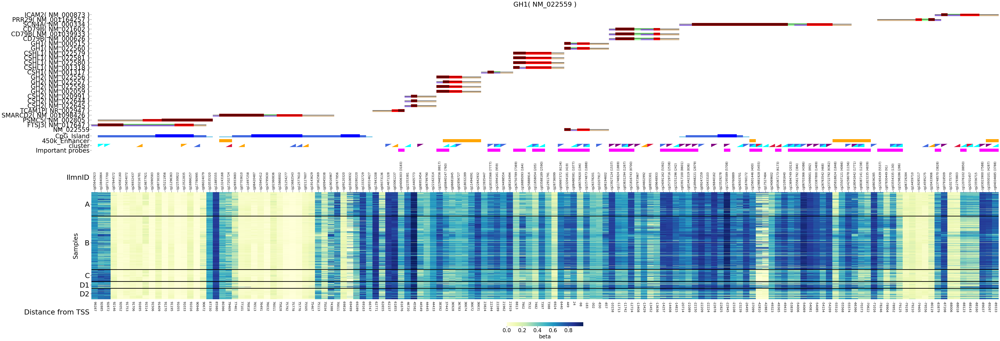

NM_175834 KRT79 - 53228095.0 53215191.0 53228095.0
140
67264 NM_015848 170
45697 NM_057088 200
22911 NM_002272 230
76123 NM_173352 260
22910 NM_002273 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_175834', 'KRT76( NM_015848 )', 'KRT3( NM_057088 )', 'KRT4( NM_002272 )', 'KRT78( NM_173352 )', 'KRT8( NM_002273 )']
fin 290


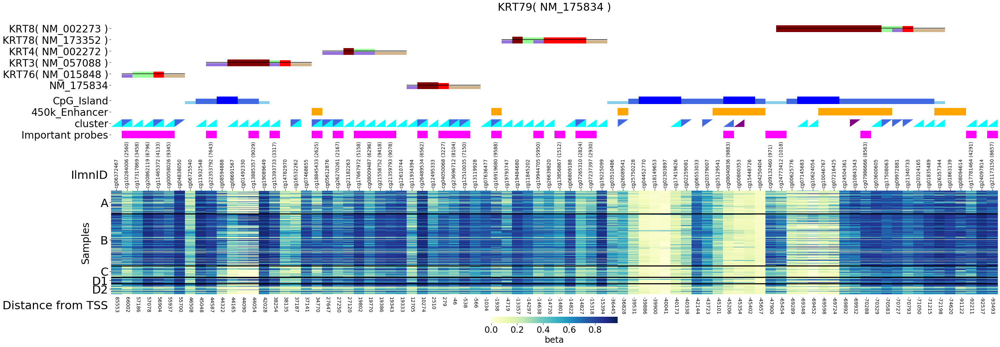

NM_001146182 KRTAP16-1 - 39465505.0 39463951.0 39465505.0
NM_005585 SMAD6 + 66994573.0 66994573.0 67075187.0
140
25987 NR_027654 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_005585', 'SMAD6( NR_027654 )']
fin 170


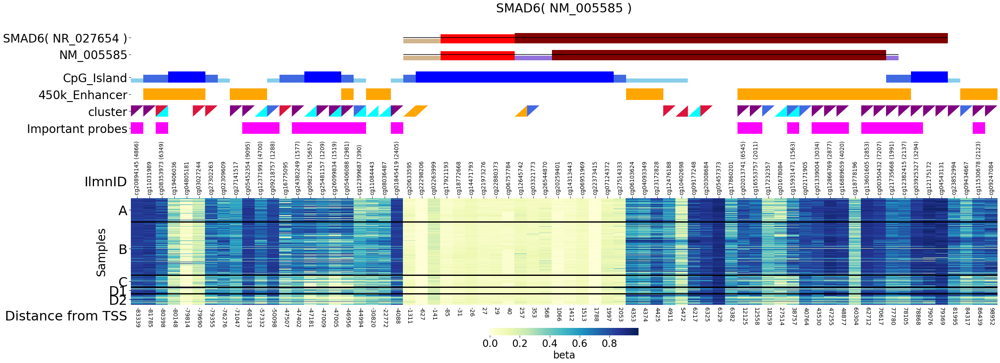

NR_027654 SMAD6 + 66994573.0 66994573.0 67075187.0
140
49384 NM_005585 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NR_027654', 'SMAD6( NM_005585 )']
fin 170


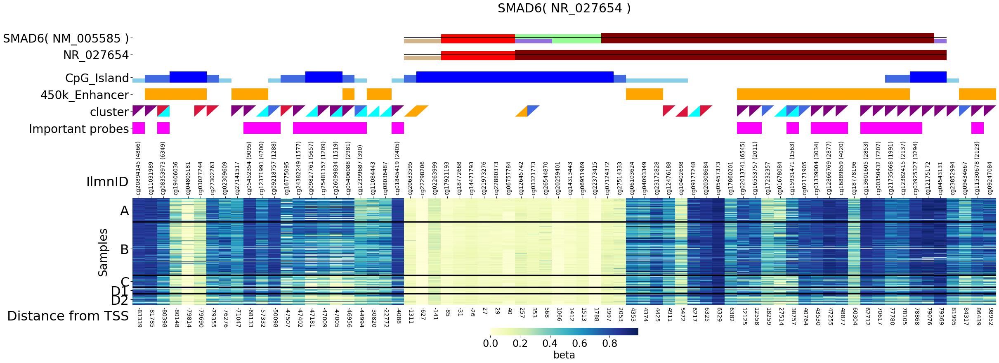

NM_001318 CSHL1 - 61988618.0 61986967.0 61988618.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
51373 NM_002059 440
27728 NM_022558 470
27729 NM_022557 500
41607 NM_022556 530
49502 NM_001317 560
10939 NM_022580 590
13742 NM_022581 620
29393 NM_022579 650
67819 NM_022559 680
67818 NM_022560 710
47838 NM_000515 740
32296 NM_000626 770
69085 NM_001039933 800
20576 NM_021602 830
29603 NM_000334 860
40485 NM_001164257 890
30515 NM_000873 920
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900, 930]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001318', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_0

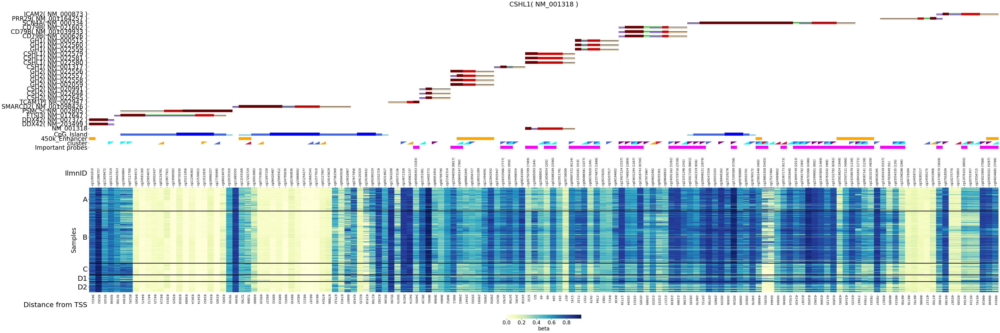

NM_022581 CSHL1 - 61988618.0 61986967.0 61988618.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
51373 NM_002059 440
27728 NM_022558 470
27729 NM_022557 500
41607 NM_022556 530
49502 NM_001317 560
43477 NM_001318 590
10939 NM_022580 620
29393 NM_022579 650
67819 NM_022559 680
67818 NM_022560 710
47838 NM_000515 740
32296 NM_000626 770
69085 NM_001039933 800
20576 NM_021602 830
29603 NM_000334 860
40485 NM_001164257 890
30515 NM_000873 920
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900, 930]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022581', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_0

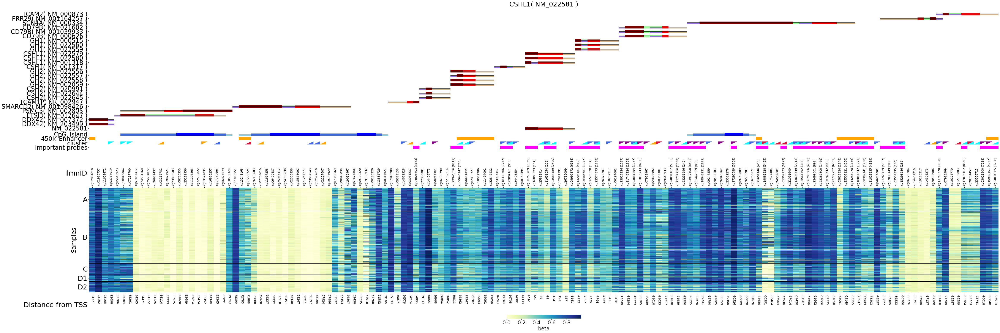

NM_022580 CSHL1 - 61988618.0 61986967.0 61988618.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
51373 NM_002059 440
27728 NM_022558 470
27729 NM_022557 500
41607 NM_022556 530
49502 NM_001317 560
43477 NM_001318 590
13742 NM_022581 620
29393 NM_022579 650
67819 NM_022559 680
67818 NM_022560 710
47838 NM_000515 740
32296 NM_000626 770
69085 NM_001039933 800
20576 NM_021602 830
29603 NM_000334 860
40485 NM_001164257 890
30515 NM_000873 920
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900, 930]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022580', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_0

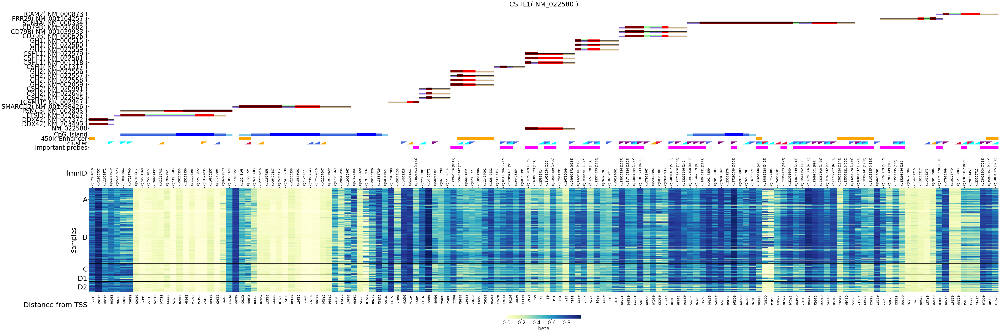

NM_022579 CSHL1 - 61988618.0 61986967.0 61988618.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
51373 NM_002059 440
27728 NM_022558 470
27729 NM_022557 500
41607 NM_022556 530
49502 NM_001317 560
43477 NM_001318 590
10939 NM_022580 620
13742 NM_022581 650
67819 NM_022559 680
67818 NM_022560 710
47838 NM_000515 740
32296 NM_000626 770
69085 NM_001039933 800
20576 NM_021602 830
29603 NM_000334 860
40485 NM_001164257 890
30515 NM_000873 920
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900, 930]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022579', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_0

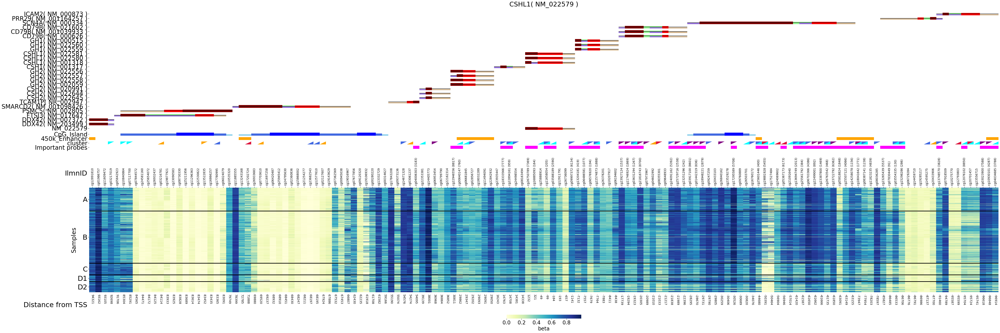

NM_000395 CSF2RB + 37309669.0 37309669.0 37336479.0
140
47765 NM_002854 170
52009 NM_000631 200
79453 NM_013416 230
3438 NM_001163857 260
33710 NM_178552 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_000395', 'PVALB( NM_002854 )', 'NCF4( NM_000631 )', 'NCF4( NM_013416 )', 'TEX33( NM_001163857 )', 'TEX33( NM_178552 )']
fin 290


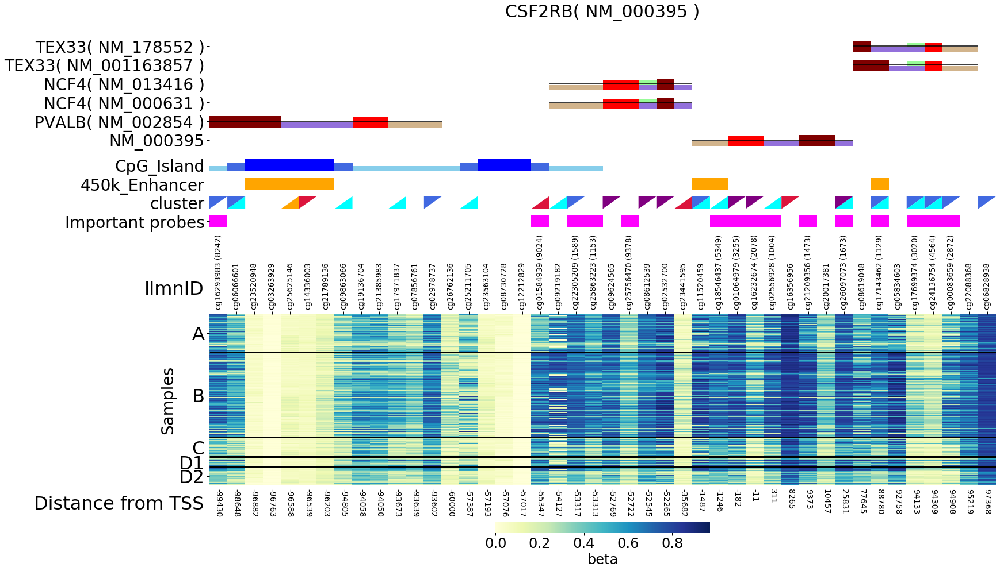

NM_031964 KRTAP17-1 - 39471962.0 39471163.0 39471962.0
140
38796 NM_031961 170
38795 NM_031962 200
38794 NM_031963 230
38029 NM_033191 260
43730 NM_030975 290
64109 NM_004138 320
9191 NM_002279 350
70836 NM_021013 380
9194 NM_002277 410
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_031964', 'KRTAP9-2( NM_031961 )', 'KRTAP9-3( NM_031962 )', 'KRTAP9-8( NM_031963 )', 'KRTAP9-4( NM_033191 )', 'KRTAP9-9( NM_030975 )', 'KRT33A( NM_004138 )', 'KRT33B( NM_002279 )', 'KRT34( NM_021013 )', 'KRT31( NM_002277 )']
fin 410


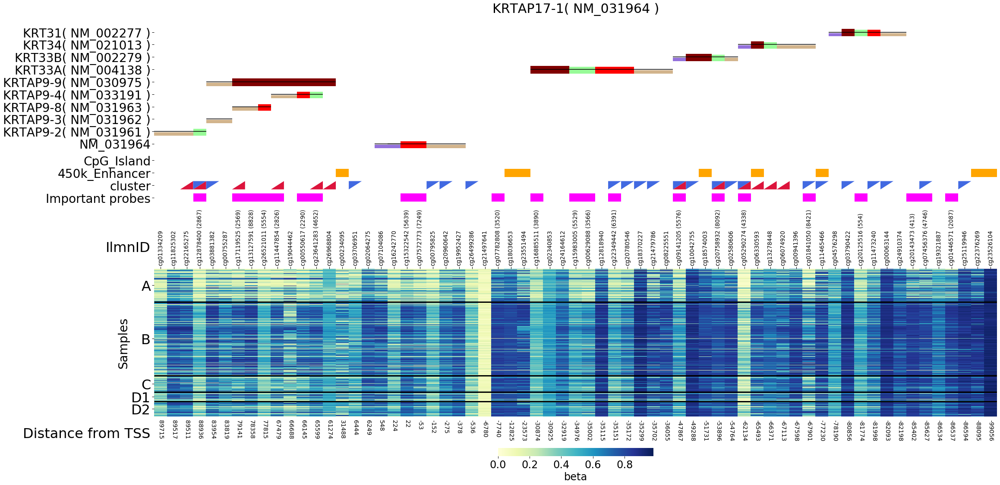

NM_001257309 KRTAP29-1 - 39459103.0 39458077.0 39459103.0
NM_007128 VPREB1 + 22599197.0 22599197.0 22599927.0
140
20409 NR_027293 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_007128', 'BMS1P20( NR_027293 )']
fin 170


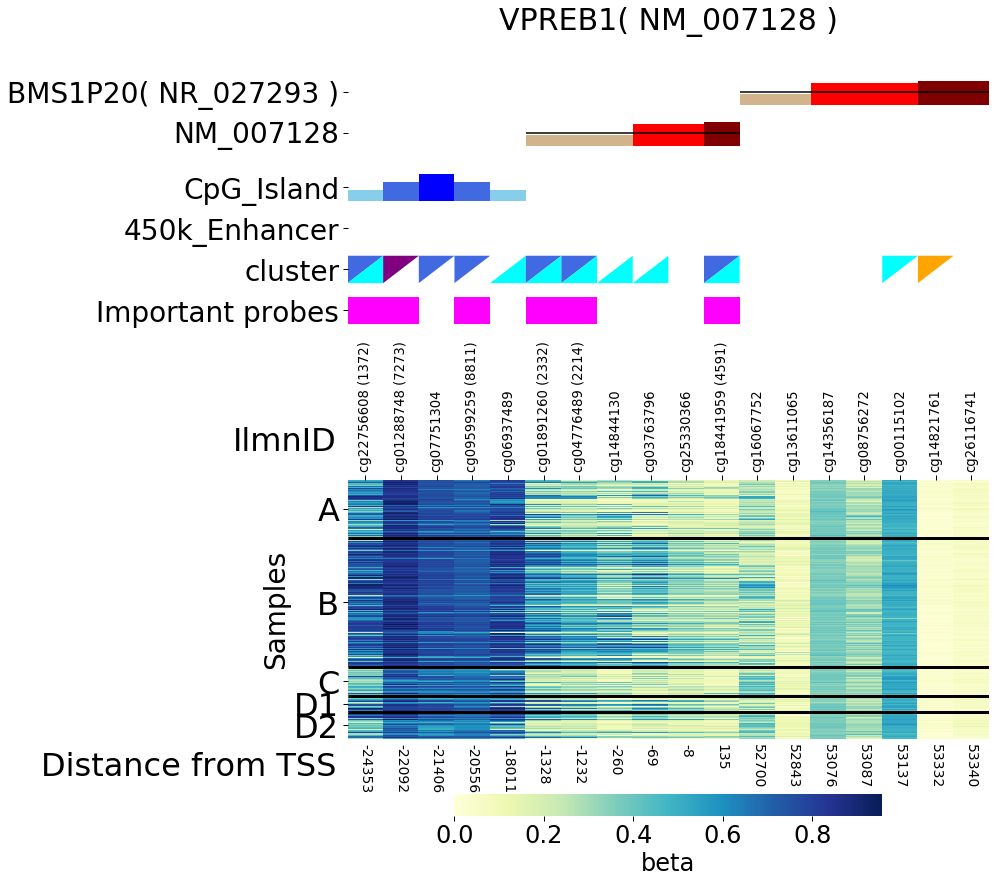

NM_001198828 LIPF + 90424198.0 90424198.0 90438570.0
NM_001198829 LIPF + 90424198.0 90424198.0 90438570.0
NM_001198830 LIPF + 90424198.0 90424198.0 90438570.0
NM_001307952 HAPLN3 - 89438775.0 89420524.0 89438775.0
NM_001303509 VPREB1 + 22599197.0 22599197.0 22599927.0
NM_004190 LIPF + 90424198.0 90424198.0 90438570.0
140
14511 NM_018363 170
27916 NM_001031709 200
8928 NM_001010939 230
45882 NM_001080518 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_004190', 'RNLS( NM_018363 )', 'RNLS( NM_001031709 )', 'LIPJ( NM_001010939 )', 'LIPK( NM_001080518 )']
fin 260


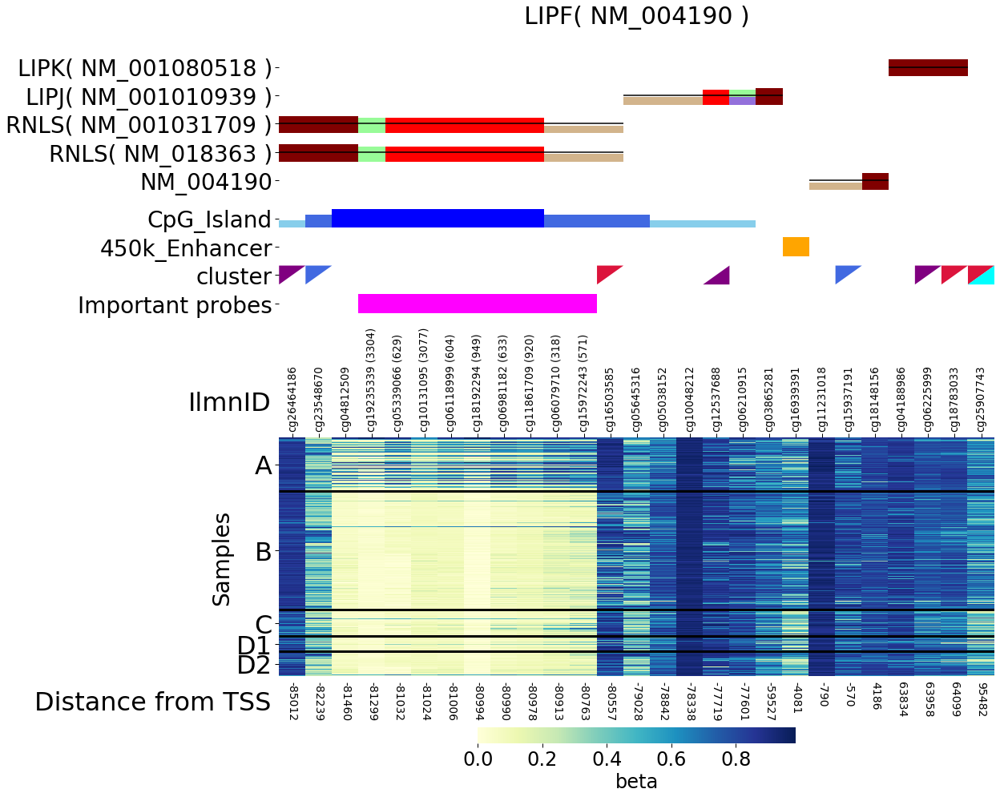

NM_173352 KRT78 - 53242778.0 53231593.0 53242778.0
140
67264 NM_015848 170
45697 NM_057088 200
22911 NM_002272 230
76616 NM_175834 260
22910 NM_002273 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_173352', 'KRT76( NM_015848 )', 'KRT3( NM_057088 )', 'KRT4( NM_002272 )', 'KRT79( NM_175834 )', 'KRT8( NM_002273 )']
fin 290


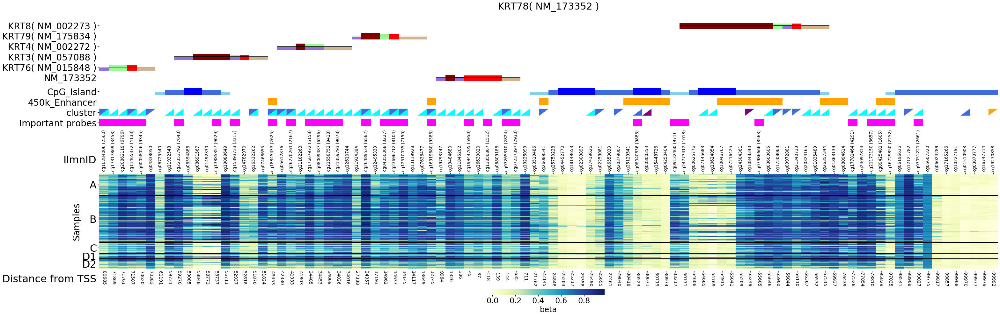

NM_178232 HAPLN3 - 89438775.0 89420524.0 89438775.0
140
16000 NM_001135 170
57772 NM_013227 200
19224 NM_005928 230
70434 NM_001114614 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_178232', 'ACAN( NM_001135 )', 'ACAN( NM_013227 )', 'MFGE8( NM_005928 )', 'MFGE8( NM_001114614 )']
fin 260


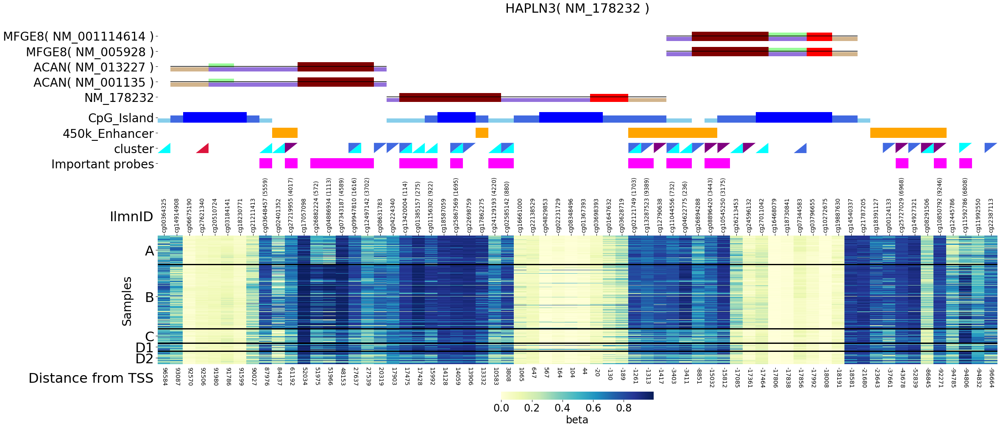

NM_006121 KRT1 - 53074191.0 53068519.0 53074191.0
140
761 NM_001146225 170
33652 NM_001146226 200
36893 NM_080747 230
74515 NM_175068 260
3691 NM_000423 290
74505 NM_175078 320
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_006121', 'KRT72( NM_001146225 )', 'KRT72( NM_001146226 )', 'KRT72( NM_080747 )', 'KRT73( NM_175068 )', 'KRT2( NM_000423 )', 'KRT77( NM_175078 )']
fin 320


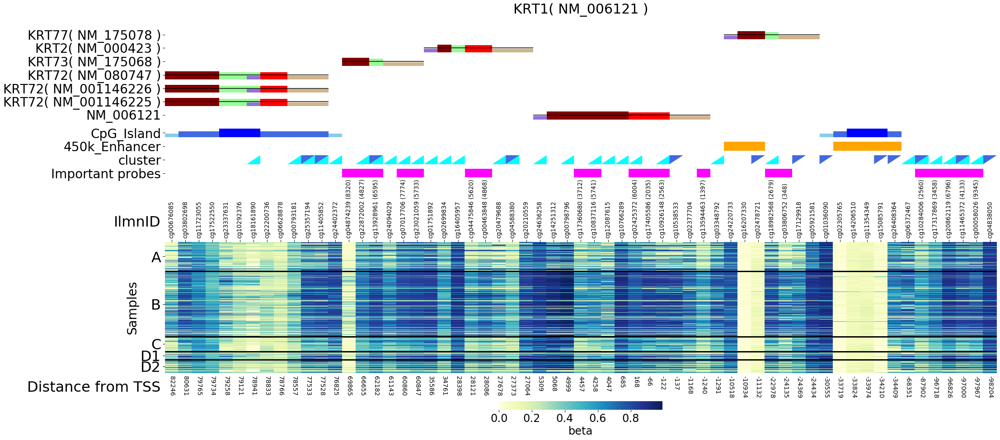

NM_152745 NXPH1 + 8473238.0 8473238.0 8792591.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_152745']
fin 140


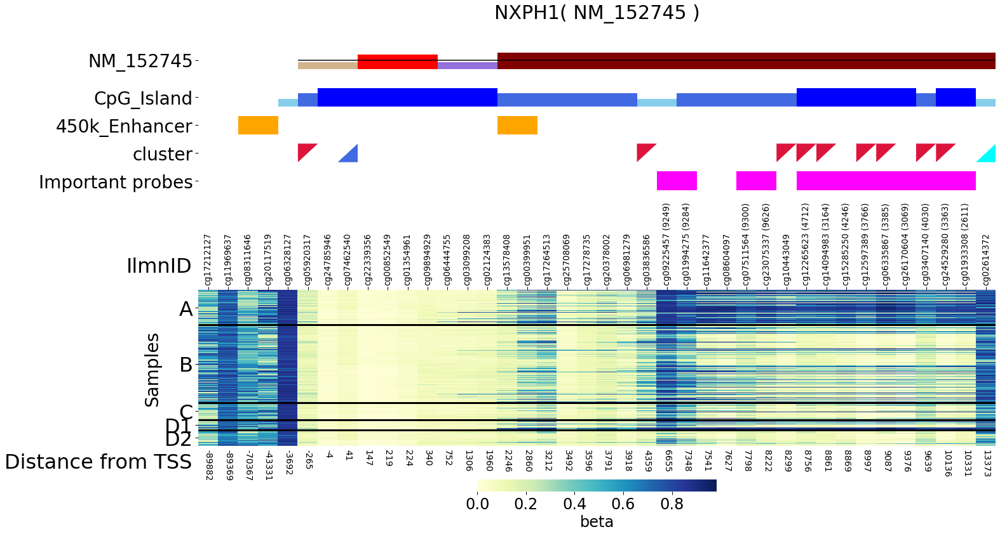

NM_002279 KRT33B - 39526065.0 39519749.0 39526065.0
140
38793 NM_031964 170
64109 NM_004138 200
70836 NM_021013 230
9194 NM_002277 260
14264 NM_003770 290
40943 NM_006771 320
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_002279', 'KRTAP17-1( NM_031964 )', 'KRT33A( NM_004138 )', 'KRT34( NM_021013 )', 'KRT31( NM_002277 )', 'KRT37( NM_003770 )', 'KRT38( NM_006771 )']
fin 320


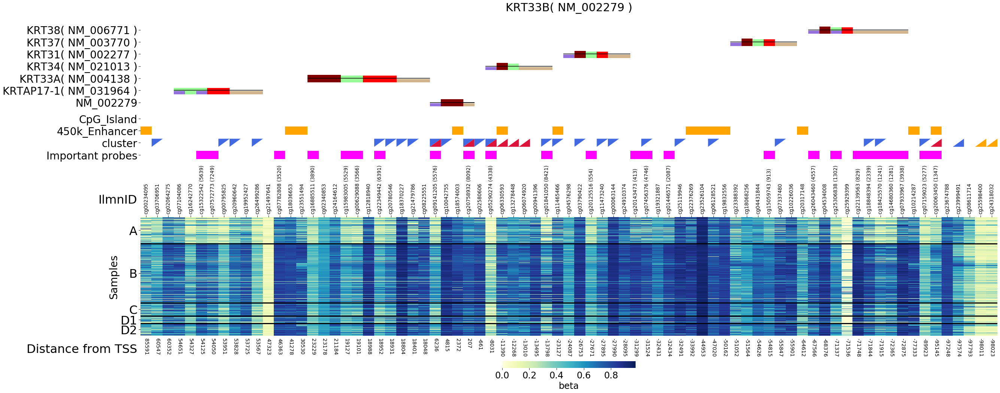

NM_004138 KRT33A - 39507080.0 39502344.0 39507080.0
140
43730 NM_030975 170
38793 NM_031964 200
9191 NM_002279 230
70836 NM_021013 260
9194 NM_002277 290
14264 NM_003770 320
40943 NM_006771 350
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_004138', 'KRTAP9-9( NM_030975 )', 'KRTAP17-1( NM_031964 )', 'KRT33B( NM_002279 )', 'KRT34( NM_021013 )', 'KRT31( NM_002277 )', 'KRT37( NM_003770 )', 'KRT38( NM_006771 )']
fin 350


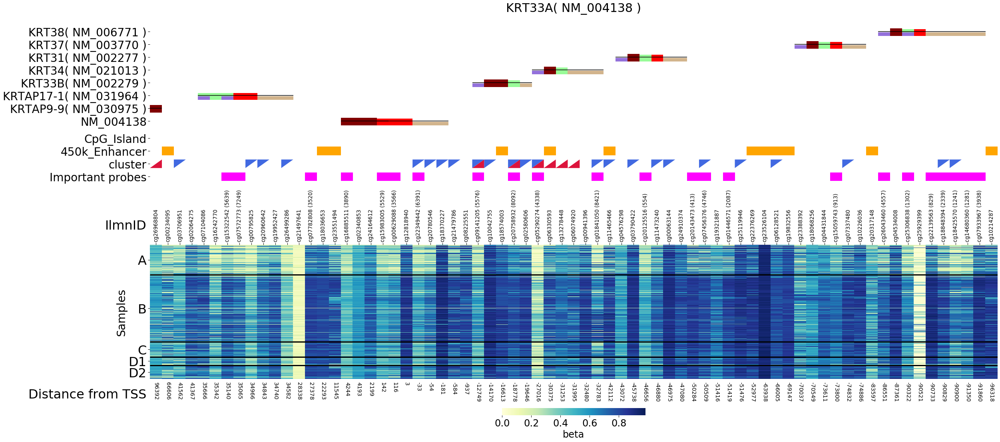

NM_001303500 SAMD9L - 92777698.0 92759368.0 92777698.0
NM_032528 ST6GAL2 - 107503565.0 107418055.0 107503565.0
140
3390 NM_001142351 170
37051 NM_001142352 200
[20, 50, 80, 110, 150, 180, 210]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_032528', 'ST6GAL2( NM_001142351 )', 'ST6GAL2( NM_001142352 )']
fin 200


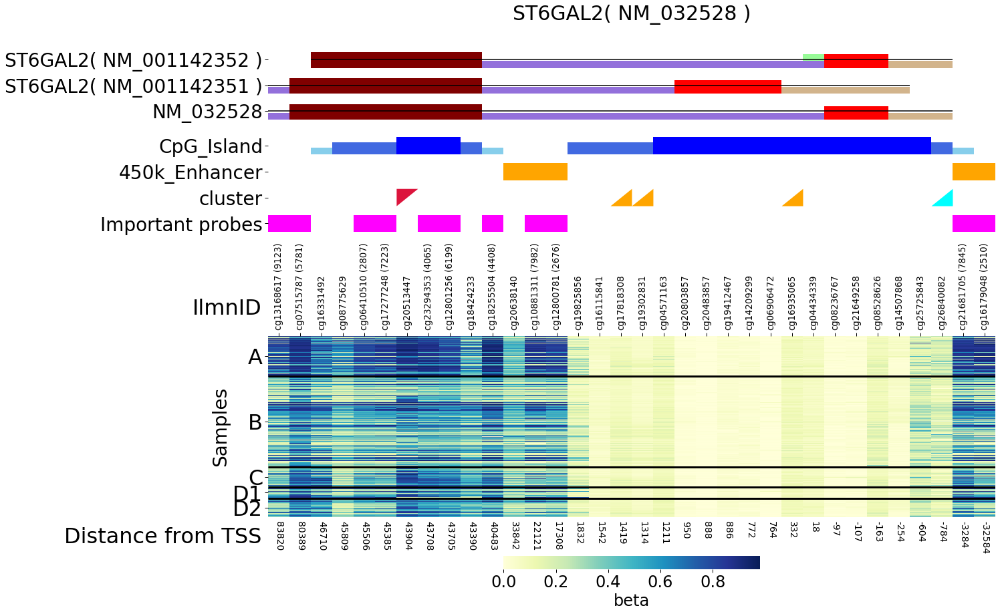

NM_152703 SAMD9L - 92777698.0 92759368.0 92777698.0
140
72257 NM_017654 170
46519 NM_198151 200
60215 NM_001039372 230
[20, 50, 80, 110, 150, 180, 210, 240]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_152703', 'SAMD9( NM_017654 )', 'HEPACAM2( NM_198151 )', 'HEPACAM2( NM_001039372 )']
fin 230


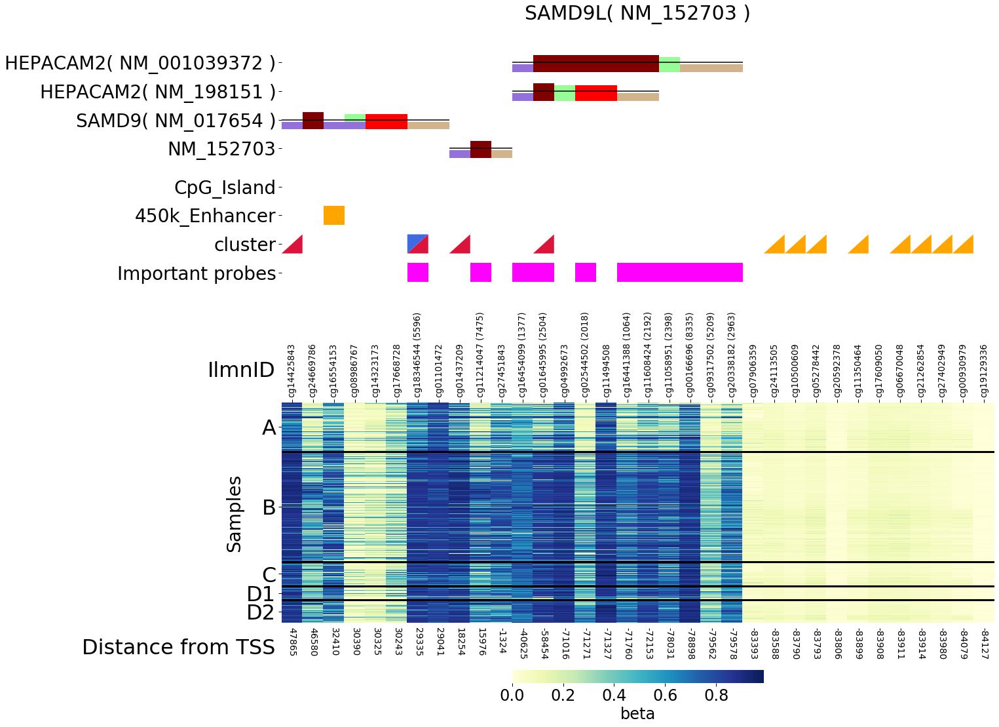

NM_001142351 ST6GAL2 - 107502623.0 107418055.0 107502623.0
140
16268 NM_032528 170
37051 NM_001142352 200
[20, 50, 80, 110, 150, 180, 210]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001142351', 'ST6GAL2( NM_032528 )', 'ST6GAL2( NM_001142352 )']
fin 200


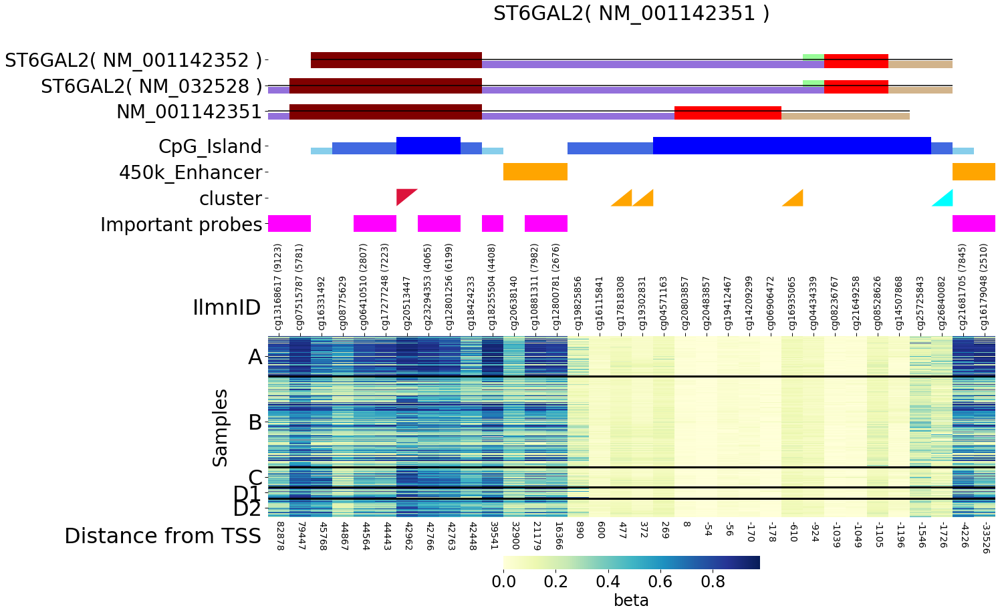

NM_001142352 ST6GAL2 - 107503565.0 107429531.0 107503565.0
140
3390 NM_001142351 170
16268 NM_032528 200
[20, 50, 80, 110, 150, 180, 210]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001142352', 'ST6GAL2( NM_001142351 )', 'ST6GAL2( NM_032528 )']
fin 200


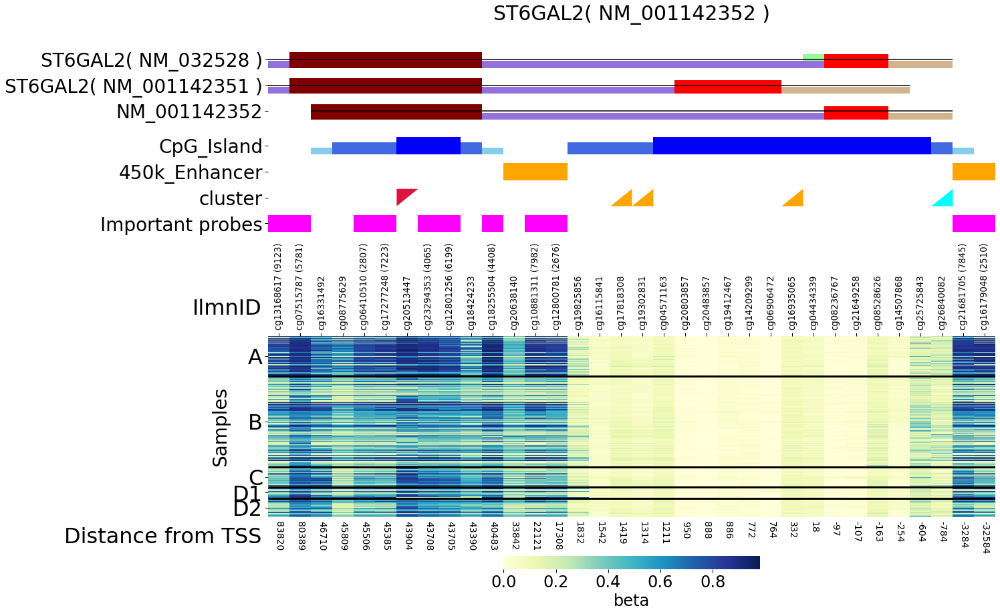

NM_001303497 SAMD9L - 92777698.0 92759368.0 92777698.0
NM_001303498 SAMD9L - 92777698.0 92759368.0 92777698.0
NM_001303496 SAMD9L - 92777698.0 92759368.0 92777698.0
NM_001317 CSH1 - 61973934.0 61972277.0 61973934.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
27728 NM_022558 440
51373 NM_002059 470
27729 NM_022557 500
41607 NM_022556 530
43477 NM_001318 560
13742 NM_022581 590
29393 NM_022579 620
10939 NM_022580 650
47838 NM_000515 680
67818 NM_022560 710
67819 NM_022559 740
69085 NM_001039933 770
32296 NM_000626 800
20576 NM_021602 830
29603 NM_000334 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001317', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002

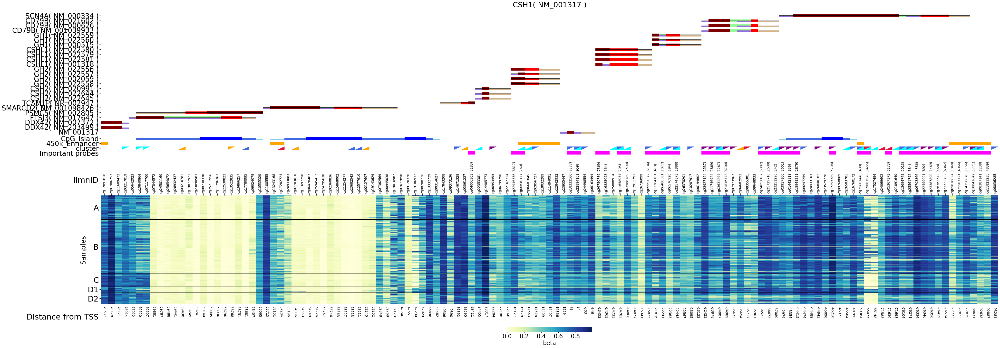

NM_002273 KRT8 - 53298860.0 53290974.0 53298860.0
140
22911 NM_002272 170
76616 NM_175834 200
76123 NM_173352 230
1263 NM_199187 260
47890 NM_000224 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_002273', 'KRT4( NM_002272 )', 'KRT79( NM_175834 )', 'KRT78( NM_173352 )', 'KRT18( NM_199187 )', 'KRT18( NM_000224 )']
fin 290


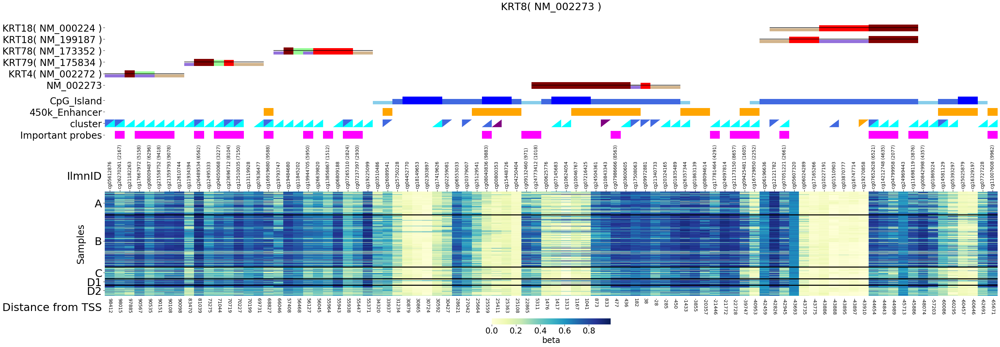

NM_020379 MAN1C1 + 25943281.0 25943281.0 26110940.0
140
62552 NM_015627 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_020379', 'LDLRAP1( NM_015627 )']
fin 170


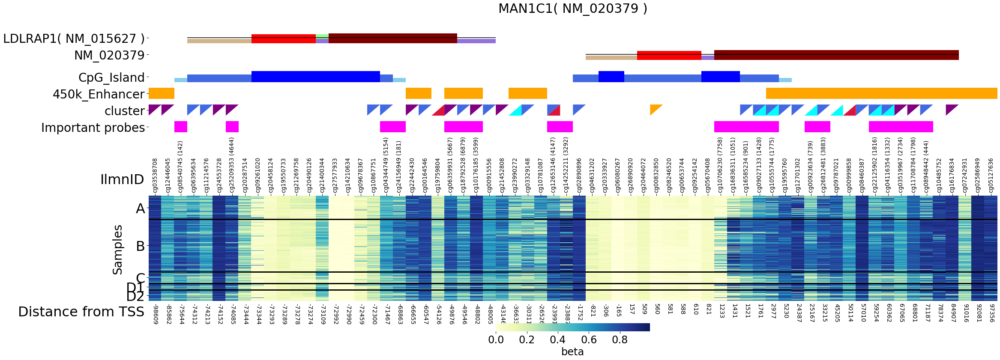

NM_001289010 MAN1C1 + 25943281.0 25943281.0 26110940.0
NM_002272 KRT4 - 53207900.0 53200332.0 53207900.0
140
67264 NM_015848 170
45697 NM_057088 200
76616 NM_175834 230
76123 NM_173352 260
22910 NM_002273 290
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_002272', 'KRT76( NM_015848 )', 'KRT3( NM_057088 )', 'KRT79( NM_175834 )', 'KRT78( NM_173352 )', 'KRT8( NM_002273 )']
fin 290


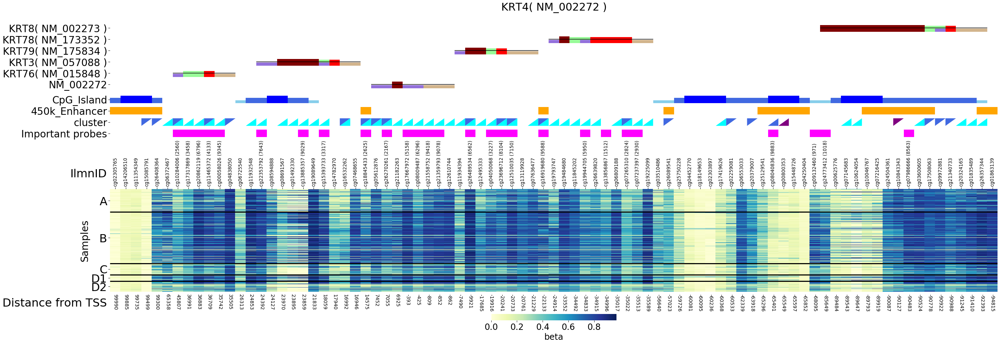

NR_015448 DLX6-AS1 - 96643377.0 96597826.0 96643377.0
140
9200 NM_005222 170
9201 NM_005221 200
[20, 50, 80, 110, 150, 180, 210]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NR_015448', 'DLX6( NM_005222 )', 'DLX5( NM_005221 )']
fin 200


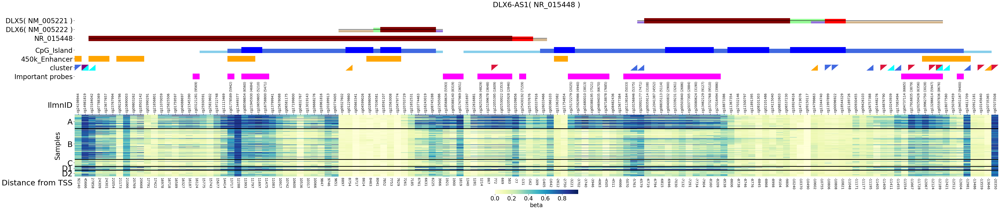

NM_032827 ATOH8 + 85981113.0 85981113.0 86018506.0
140
78215 NM_198843 170
18324 NM_000542 200
4196 NM_012483 230
22466 NM_006433 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_032827', 'SFTPB( NM_198843 )', 'SFTPB( NM_000542 )', 'GNLY( NM_012483 )', 'GNLY( NM_006433 )']
fin 260


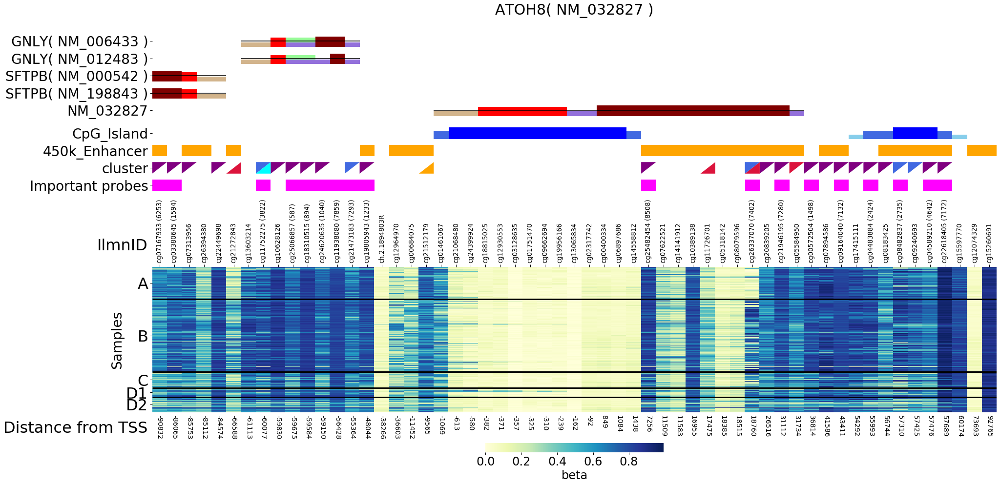

NM_005222 DLX6 + 96634864.0 96634864.0 96640352.0
140
21227 NR_015448 170
9201 NM_005221 200
[20, 50, 80, 110, 150, 180, 210]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_005222', 'DLX6-AS1( NR_015448 )', 'DLX5( NM_005221 )']
fin 200


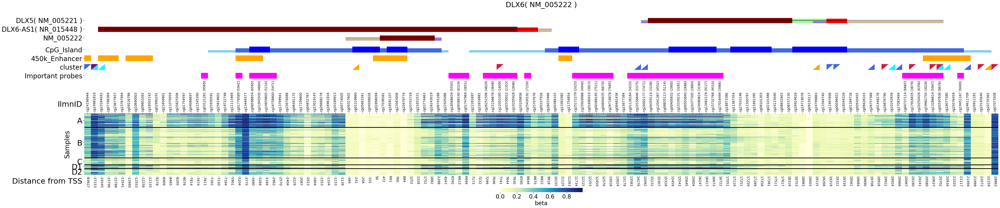

NM_001080451 SERPINA11 - 94919137.0 94908800.0 94919137.0
140
603 NM_000295 170
9670 NM_001127704 200
9671 NM_001127703 230
10120 NM_001127707 260
10122 NM_001127706 290
10124 NM_001127705 320
72132 NM_001127700 350
15769 NM_001002236 380
50420 NM_001002235 410
37855 NM_001127701 440
43901 NM_001127702 470
76628 NM_175739 500
53219 NM_001042518 530
74779 NM_173850 560
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001080451', 'SERPINA1( NM_000295 )', 'SERPINA1( NM_001127704 )', 'SERPINA1( NM_001127703 )', 'SERPINA1( NM_001127707 )', 'SERPINA1( NM_001127706 )', 'SERPINA1( NM_001127705 )', 'SERPINA1( NM_001127700 )', 'SERPINA1( NM_001002236 )', 'SERPINA1( NM_001002235 )', 'SERPINA1( NM_001127701 )', 'SERPINA1( NM_001127702 )', 'SERPINA9( NM_175739 )', 'SERPINA9( NM_001042518 )', 'SERPINA12( NM_173850 )']
fin 560


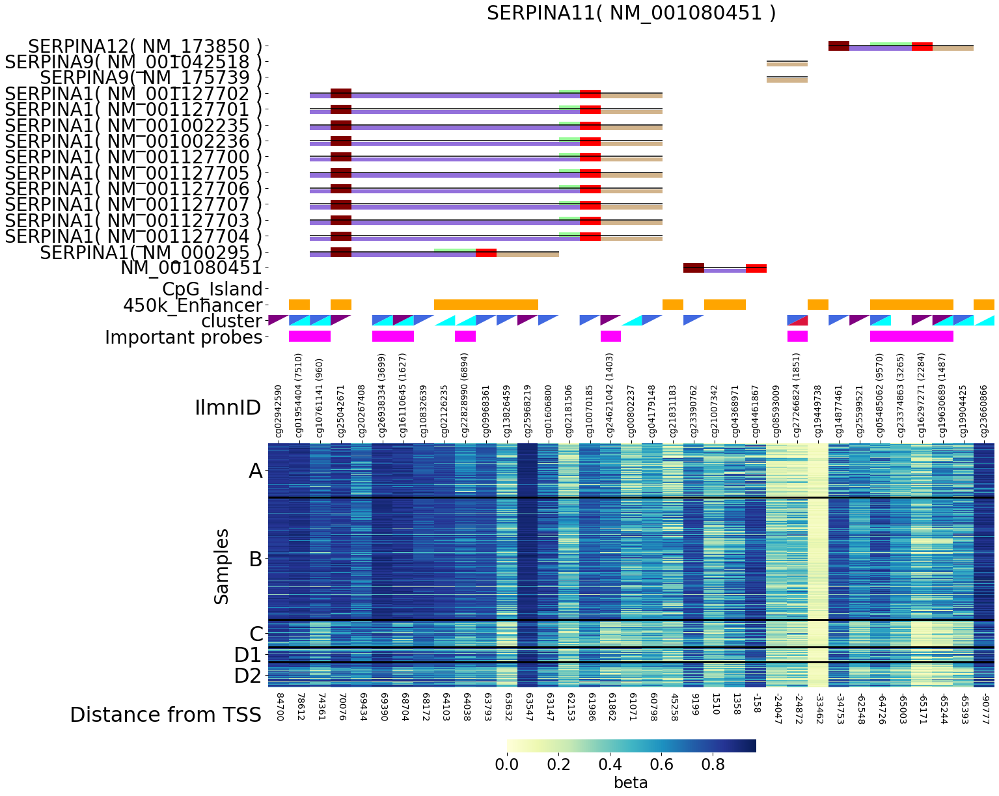

NM_001099403 PRDM8 + 81118656.0 81118656.0 81125482.0
140
25827 NM_020226 170
16088 NM_033143 200
45301 NM_004464 230
[20, 50, 80, 110, 150, 180, 210, 240]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001099403', 'PRDM8( NM_020226 )', 'FGF5( NM_033143 )', 'FGF5( NM_004464 )']
fin 230


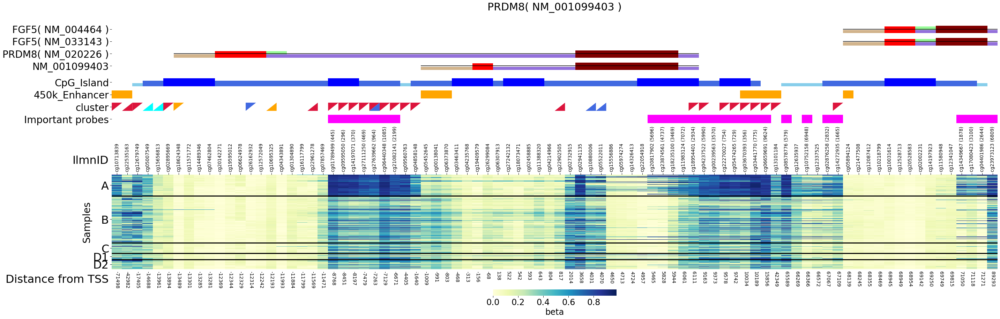

NM_031961 KRTAP9-2 + 39382899.0 39382899.0 39383904.0
140
38031 NM_033188 170
10310 NM_032524 200
13292 NM_033187 230
74263 NM_033062 260
74268 NM_033060 290
38795 NM_031962 320
38794 NM_031963 350
38029 NM_033191 380
43730 NM_030975 410
38793 NM_031964 440
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_031961', 'KRTAP4-5( NM_033188 )', 'KRTAP4-4( NM_032524 )', 'KRTAP4-3( NM_033187 )', 'KRTAP4-2( NM_033062 )', 'KRTAP4-1( NM_033060 )', 'KRTAP9-3( NM_031962 )', 'KRTAP9-8( NM_031963 )', 'KRTAP9-4( NM_033191 )', 'KRTAP9-9( NM_030975 )', 'KRTAP17-1( NM_031964 )']
fin 440


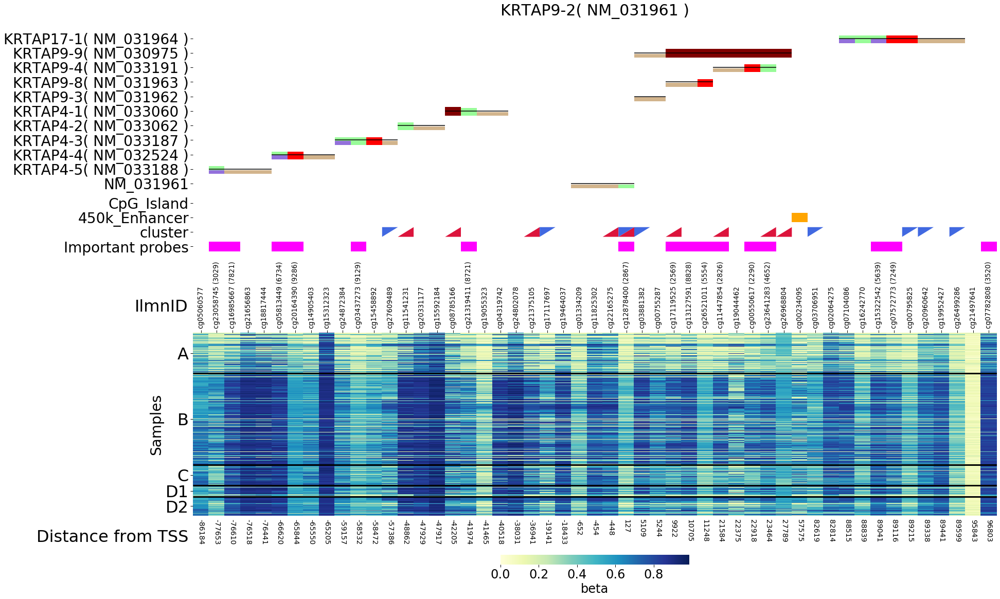

NM_001015045 FAM13A - 89744512.0 89647104.0 89744512.0
140
45502 NR_002806 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001015045', 'FAM13A-AS1( NR_002806 )']
fin 170


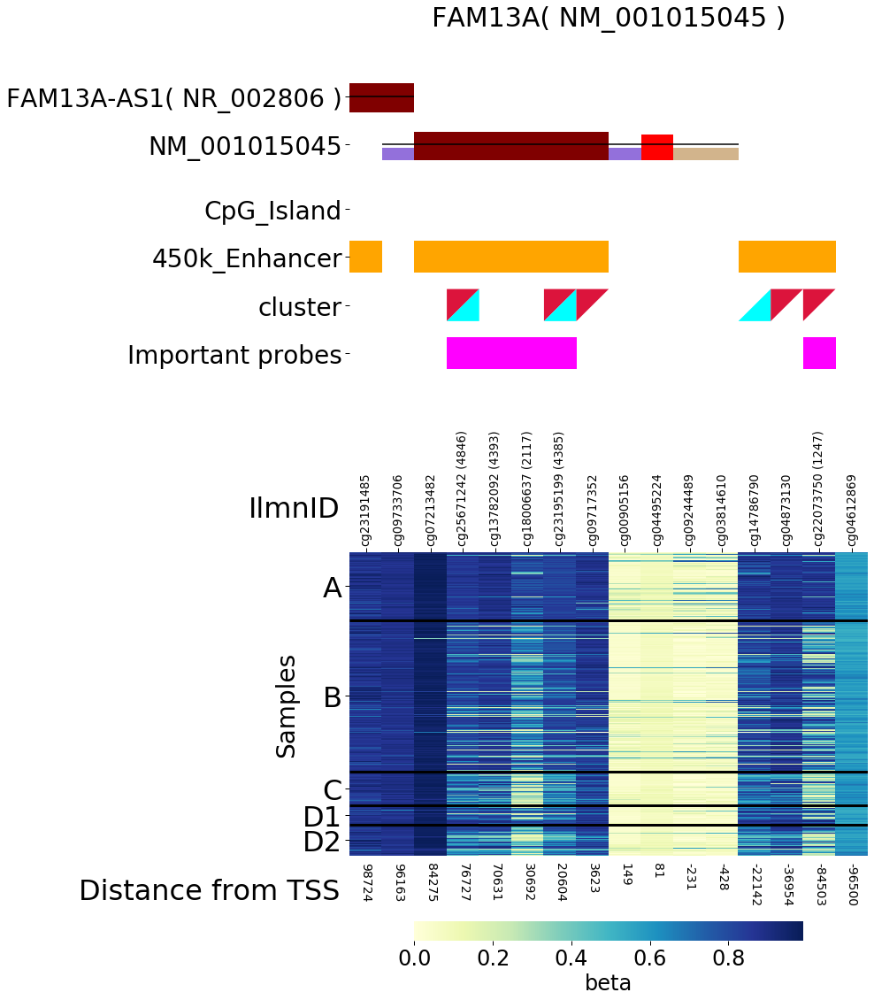

NR_036254 MIR4291 + 96581638.0 96581638.0 96581703.0
NM_001265579 FAM13A - 89744512.0 89647104.0 89744512.0
NM_001265578 FAM13A - 89744512.0 89647104.0 89744512.0
NM_001265580 FAM13A - 89744512.0 89647104.0 89744512.0
NM_022557 GH2 - 61959304.0 61957574.0 61959304.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
27728 NM_022558 440
51373 NM_002059 470
41607 NM_022556 500
49502 NM_001317 530
43477 NM_001318 560
13742 NM_022581 590
29393 NM_022579 620
10939 NM_022580 650
47838 NM_000515 680
67818 NM_022560 710
67819 NM_022559 740
69085 NM_001039933 770
32296 NM_000626 800
20576 NM_021602 830
29603 NM_000334 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022557', 'DDX42( NM_203499 )', 'DDX42

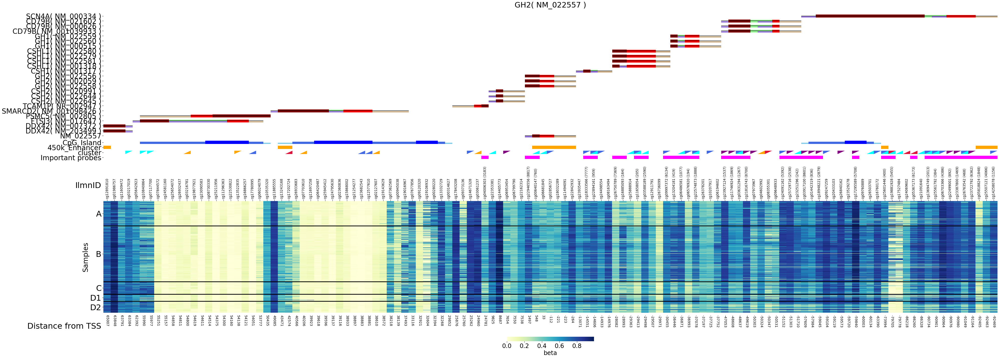

NM_022558 GH2 - 61959304.0 61957574.0 61959304.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
51373 NM_002059 440
27729 NM_022557 470
41607 NM_022556 500
49502 NM_001317 530
43477 NM_001318 560
13742 NM_022581 590
29393 NM_022579 620
10939 NM_022580 650
47838 NM_000515 680
67818 NM_022560 710
67819 NM_022559 740
69085 NM_001039933 770
32296 NM_000626 800
20576 NM_021602 830
29603 NM_000334 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022558', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_002059 )', 'GH2( NM_022557 )', 'GH2(

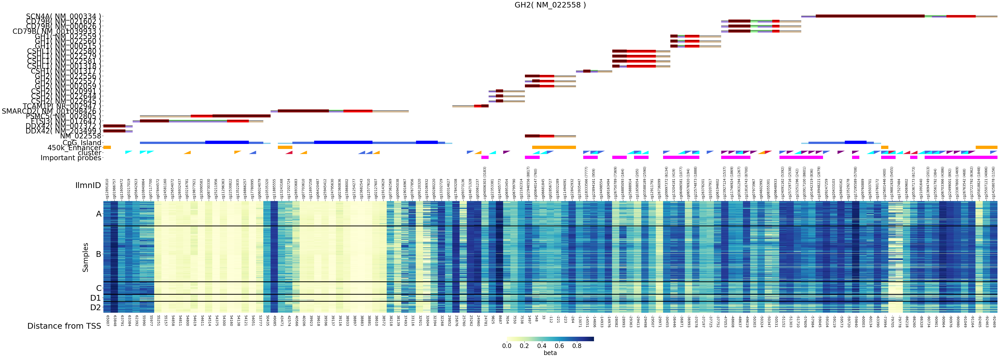

NM_022556 GH2 - 61959304.0 61957574.0 61959304.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
27728 NM_022558 440
51373 NM_002059 470
27729 NM_022557 500
49502 NM_001317 530
43477 NM_001318 560
13742 NM_022581 590
29393 NM_022579 620
10939 NM_022580 650
47838 NM_000515 680
67818 NM_022560 710
67819 NM_022559 740
69085 NM_001039933 770
32296 NM_000626 800
20576 NM_021602 830
29603 NM_000334 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022556', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_022558 )', 'GH2( NM_002059 )', 'GH2(

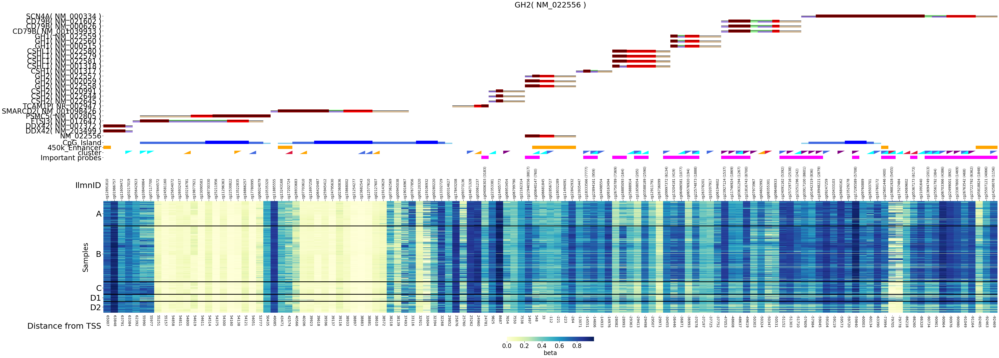

NM_002059 GH2 - 61959304.0 61957574.0 61959304.0
140
33163 NM_203499 170
54669 NM_007372 200
821 NM_017647 230
32933 NM_002805 260
12215 NM_001098426 290
26703 NR_002947 320
4506 NM_022645 350
4507 NM_022644 380
36167 NM_020991 410
27728 NM_022558 440
27729 NM_022557 470
41607 NM_022556 500
49502 NM_001317 530
43477 NM_001318 560
13742 NM_022581 590
29393 NM_022579 620
10939 NM_022580 650
47838 NM_000515 680
67818 NM_022560 710
67819 NM_022559 740
69085 NM_001039933 770
32296 NM_000626 800
20576 NM_021602 830
29603 NM_000334 860
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_002059', 'DDX42( NM_203499 )', 'DDX42( NM_007372 )', 'FTSJ3( NM_017647 )', 'PSMC5( NM_002805 )', 'SMARCD2( NM_001098426 )', 'TCAM1P( NR_002947 )', 'CSH2( NM_022645 )', 'CSH2( NM_022644 )', 'CSH2( NM_020991 )', 'GH2( NM_022558 )', 'GH2( NM_022557 )', 'GH2(

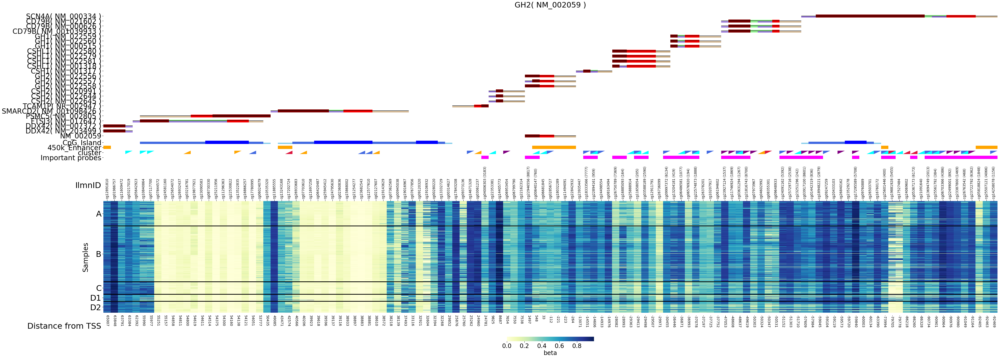

NM_031962 KRTAP9-3 + 39388700.0 39388700.0 39389706.0
140
38031 NM_033188 170
10310 NM_032524 200
13292 NM_033187 230
74263 NM_033062 260
74268 NM_033060 290
38796 NM_031961 320
38794 NM_031963 350
38029 NM_033191 380
43730 NM_030975 410
38793 NM_031964 440
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_031962', 'KRTAP4-5( NM_033188 )', 'KRTAP4-4( NM_032524 )', 'KRTAP4-3( NM_033187 )', 'KRTAP4-2( NM_033062 )', 'KRTAP4-1( NM_033060 )', 'KRTAP9-2( NM_031961 )', 'KRTAP9-8( NM_031963 )', 'KRTAP9-4( NM_033191 )', 'KRTAP9-9( NM_030975 )', 'KRTAP17-1( NM_031964 )']
fin 440


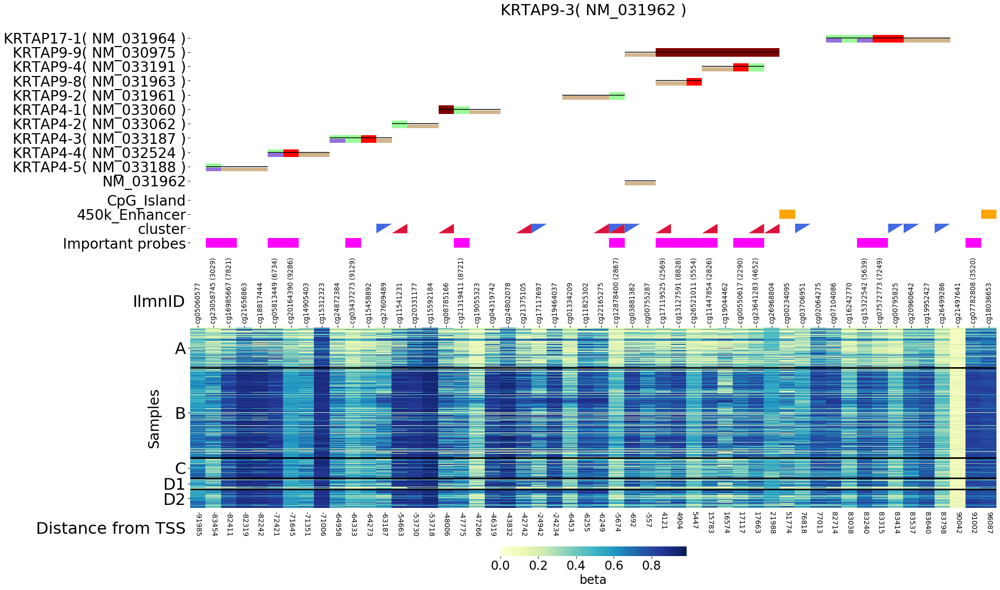

NM_031963 KRTAP9-8 + 39394250.0 39394250.0 39395256.0
140
38031 NM_033188 170
10310 NM_032524 200
13292 NM_033187 230
74263 NM_033062 260
74268 NM_033060 290
38796 NM_031961 320
38795 NM_031962 350
38029 NM_033191 380
43730 NM_030975 410
38793 NM_031964 440
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_031963', 'KRTAP4-5( NM_033188 )', 'KRTAP4-4( NM_032524 )', 'KRTAP4-3( NM_033187 )', 'KRTAP4-2( NM_033062 )', 'KRTAP4-1( NM_033060 )', 'KRTAP9-2( NM_031961 )', 'KRTAP9-3( NM_031962 )', 'KRTAP9-4( NM_033191 )', 'KRTAP9-9( NM_030975 )', 'KRTAP17-1( NM_031964 )']
fin 440


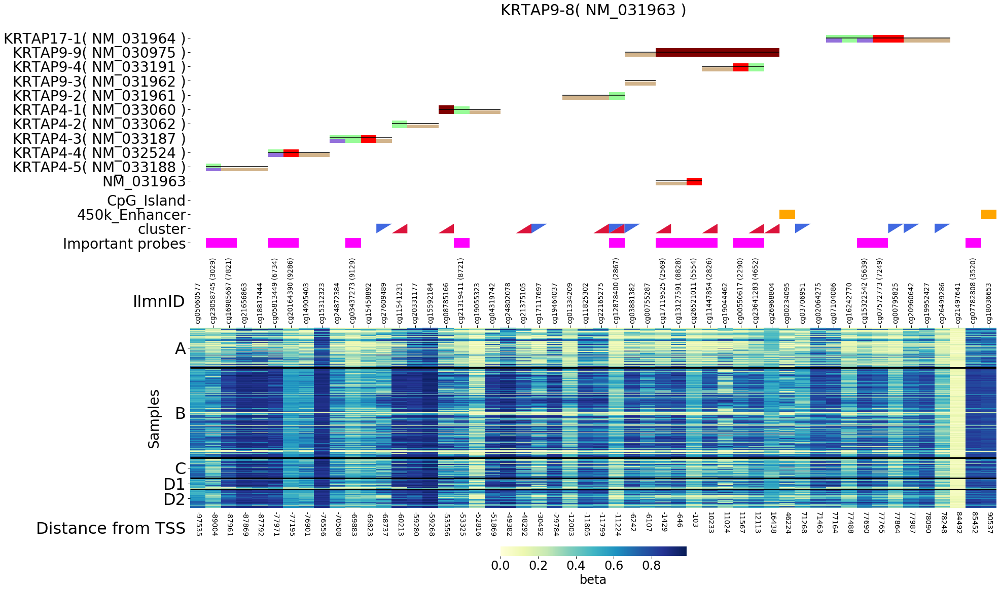

NM_020226 PRDM8 + 81106423.0 81106423.0 81125482.0
140
12384 NM_001099403 170
[20, 50, 80, 110, 150, 180]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_020226', 'PRDM8( NM_001099403 )']
fin 170


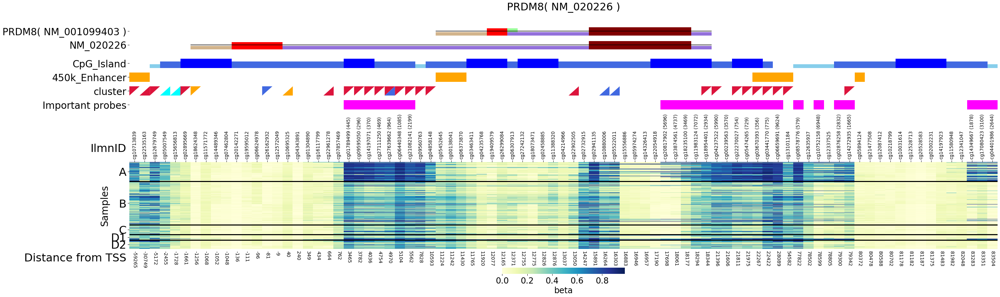

NM_021013 KRT34 - 39538636.0 39533920.0 39538636.0
140
38793 NM_031964 170
64109 NM_004138 200
9191 NM_002279 230
9194 NM_002277 260
14264 NM_003770 290
40943 NM_006771 320
9193 NM_002278 350
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_021013', 'KRTAP17-1( NM_031964 )', 'KRT33A( NM_004138 )', 'KRT33B( NM_002279 )', 'KRT31( NM_002277 )', 'KRT37( NM_003770 )', 'KRT38( NM_006771 )', 'KRT32( NM_002278 )']
fin 350


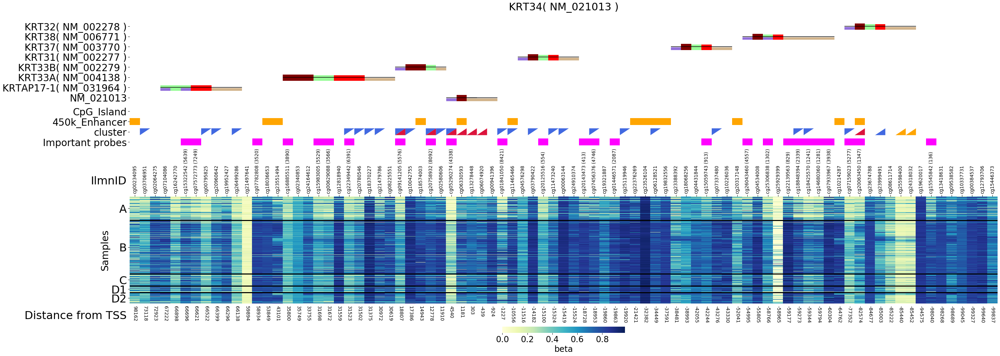

NM_022336 EDAR - 109605676.0 109510926.0 109605676.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_022336']
fin 140


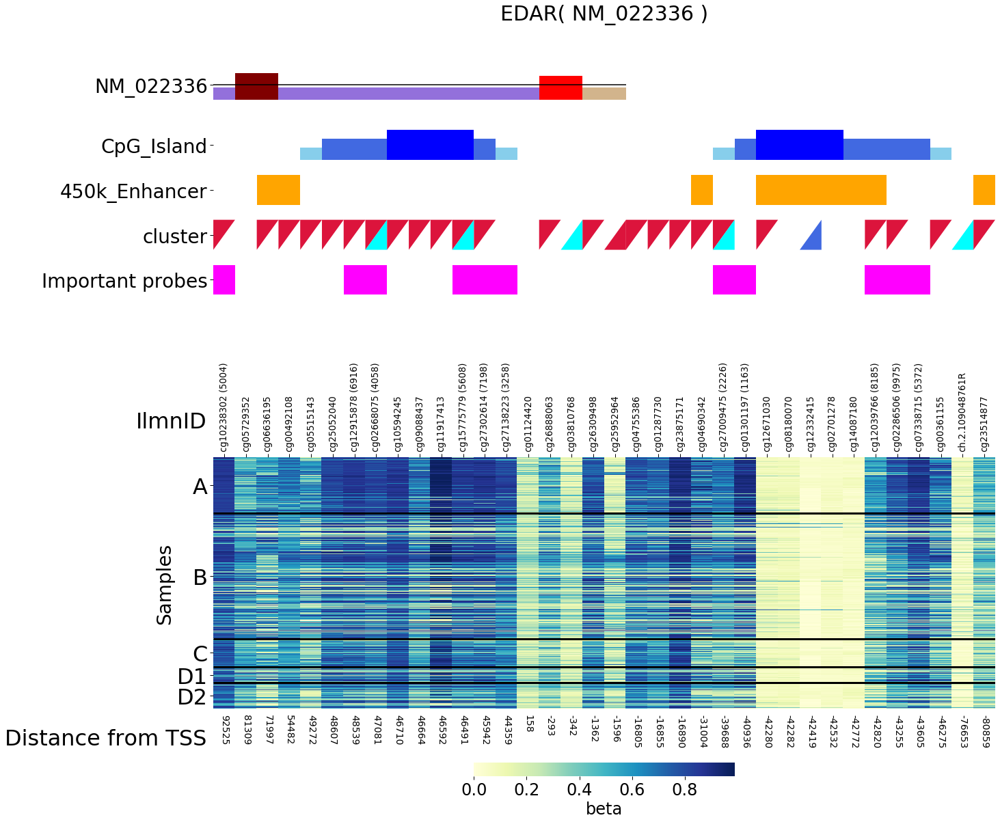

NM_030975 KRTAP9-9 + 39411635.0 39411635.0 39412616.0
140
10310 NM_032524 170
13292 NM_033187 200
74263 NM_033062 230
74268 NM_033060 260
38796 NM_031961 290
38795 NM_031962 320
38794 NM_031963 350
38029 NM_033191 380
38793 NM_031964 410
64109 NM_004138 440
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_030975', 'KRTAP4-4( NM_032524 )', 'KRTAP4-3( NM_033187 )', 'KRTAP4-2( NM_033062 )', 'KRTAP4-1( NM_033060 )', 'KRTAP9-2( NM_031961 )', 'KRTAP9-3( NM_031962 )', 'KRTAP9-8( NM_031963 )', 'KRTAP9-4( NM_033191 )', 'KRTAP17-1( NM_031964 )', 'KRT33A( NM_004138 )']
fin 440


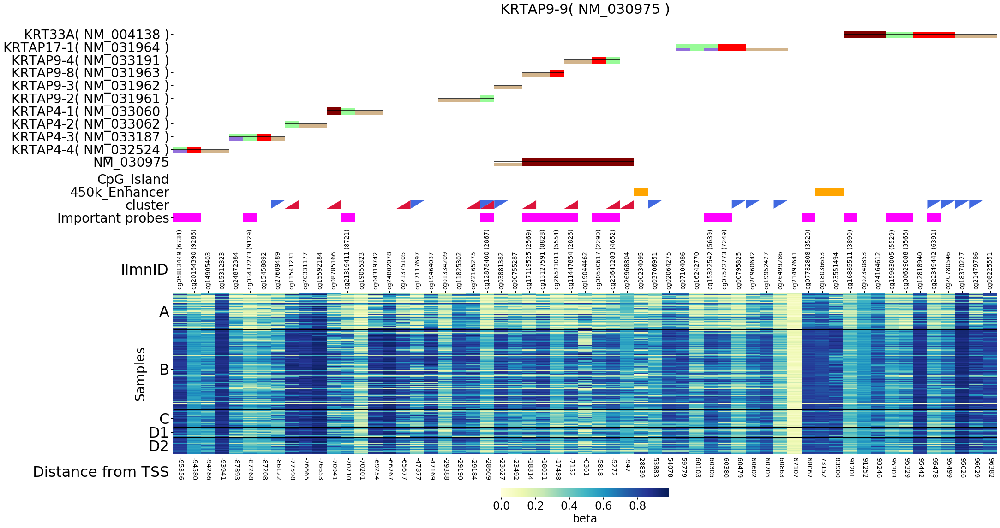

NR_110372 LINC01169 + 66874527.0 66874527.0 66978136.0
NM_001278562 LCTL - 66858336.0 66839516.0 66858336.0
NM_207338 LCTL - 66858336.0 66839869.0 66858336.0
140
39245 NM_002755 170
64005 NM_006049 200
50272 NM_000968 230
21042 NR_002443 260
21043 NR_002442 290
21044 NR_002440 320
21045 NR_002441 350
10336 NM_017975 380
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_207338', 'MAP2K1( NM_002755 )', 'SNAPC5( NM_006049 )', 'RPL4( NM_000968 )', 'SNORD18C( NR_002443 )', 'SNORD18B( NR_002442 )', 'SNORD16( NR_002440 )', 'SNORD18A( NR_002441 )', 'ZWILCH( NM_017975 )']
fin 380


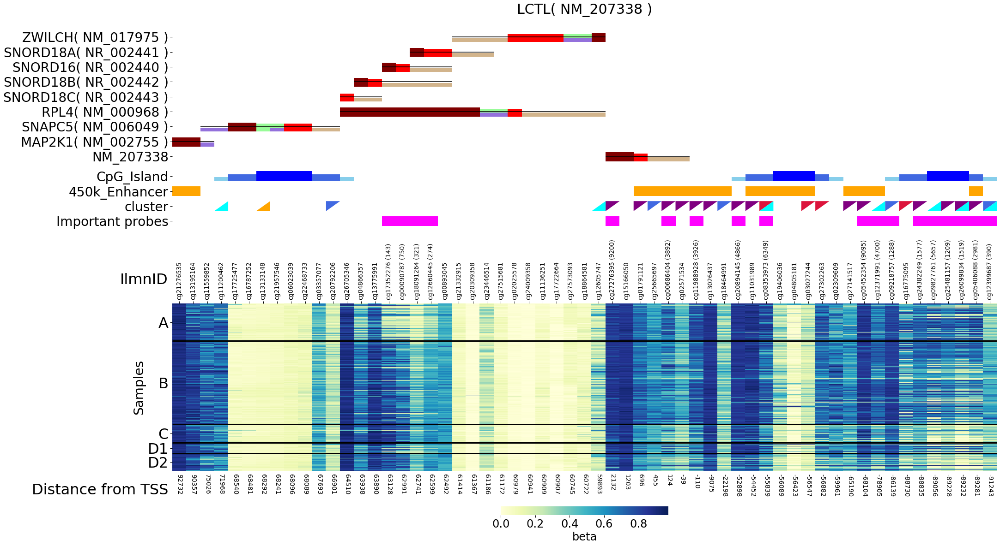

NR_103739 LCTL - 66858336.0 66839516.0 66858336.0
NM_001277332 KRTAP9-7 + 39431949.0 39431949.0 39432459.0
NM_005902 SMAD3 + 67357939.0 67357939.0 67487505.0
140
[20, 50, 80, 110, 150]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_005902']
fin 140


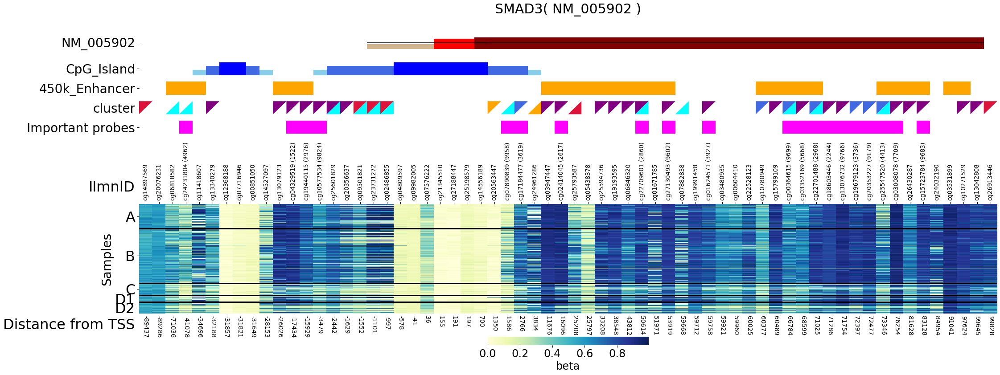

NM_001164829 C1orf210 - 43751252.0 43747550.0 43751252.0
140
25235 NM_001167965 170
74707 NM_152498 200
77284 NM_144626 230
13366 NM_182517 260
6576 NM_005424 290
20902 NM_005373 320
25624 NM_001255 350
30702 NM_022821 380
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001164829', 'CFAP57( NM_001167965 )', 'CFAP57( NM_152498 )', 'TMEM125( NM_144626 )', 'C1orf210( NM_182517 )', 'TIE1( NM_005424 )', 'MPL( NM_005373 )', 'CDC20( NM_001255 )', 'ELOVL1( NM_022821 )']
fin 380


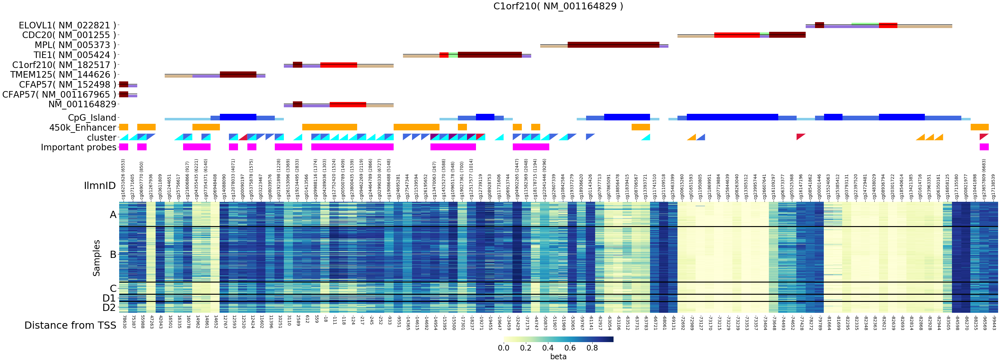

NM_182517 C1orf210 - 43751252.0 43747550.0 43751252.0
140
25235 NM_001167965 170
74707 NM_152498 200
77284 NM_144626 230
37665 NM_001164829 260
6576 NM_005424 290
20902 NM_005373 320
25624 NM_001255 350
30702 NM_022821 380
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_182517', 'CFAP57( NM_001167965 )', 'CFAP57( NM_152498 )', 'TMEM125( NM_144626 )', 'C1orf210( NM_001164829 )', 'TIE1( NM_005424 )', 'MPL( NM_005373 )', 'CDC20( NM_001255 )', 'ELOVL1( NM_022821 )']
fin 380


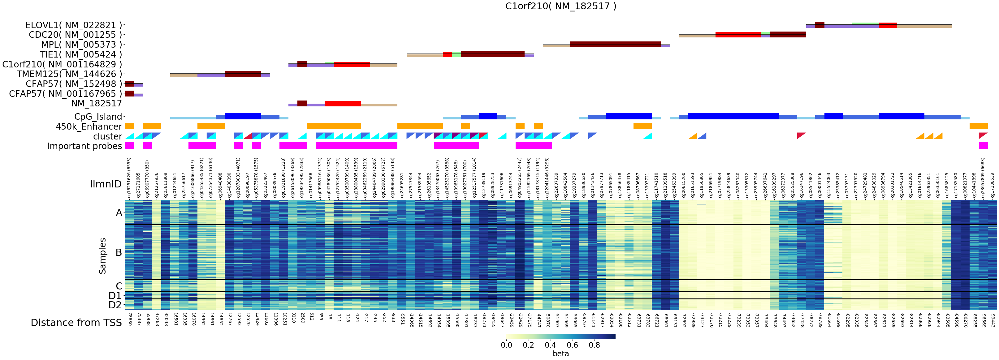

In [18]:
sns.set_context("paper", font_scale=1.5)

for j, itemsg in focal_genes.iterrows():
    TSS = 0
    if itemsg["strand"] == "+":
        TSS = itemsg["txStart"]
    else:
        TSS = itemsg["txEnd"]
        
    side = 100000
    print(itemsg["name"], itemsg["name2"], itemsg["strand"], TSS, itemsg["txStart"], itemsg["txEnd"])
#     continue
    refseq_id = itemsg["name"]
    symbol = itemsg["name2"]
    focalprobes = df_anno.loc[(df_anno["CHR"]==itemsg["chrom"].replace("chr","")) & (df_anno["Methyl450_Loci"]==True) & (df_anno["MAPINFO"]>TSS-side) & (df_anno["MAPINFO"]<TSS+side)].sort_values("MAPINFO")
    focalprobes

    focalprobes["UCSC_RefGene_Accession"] = focalprobes["UCSC_RefGene_Accession"].fillna("-1")

    if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(refseq_id)].shape[0]==0:
        continue

    chrom = df_refgenes.loc[df_refgenes["name"]==refseq_id]["chrom"].values[0]
    strand = df_refgenes.loc[df_refgenes["name"]==refseq_id]["strand"].values[0]
    txStart = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txStart"].values[0]
    txEnd = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txEnd"].values[0]
    focal_genes = df_refgenes.loc[(df_refgenes["chrom"]==chrom) & ((txStart-100000<df_refgenes["txEnd"])) & (df_refgenes["txEnd"]<txStart+100000)]
    focal_genes = focal_genes.sort_values("txStart")
    
    samplenum = 82+55+246+110

#     fig = plt.figure(figsize=(focalprobes.shape[0]/2, 10))
    fig = plt.figure(figsize=((focalprobes.shape[0]+5)/2, (samplenum+60+15*focal_genes.shape[0])/40))

    ############### ax2
    lw=3
    ax2 = fig.add_subplot(211)
    
    yticks_pos = []
    yticks_label = []
 
    h_offset = 0
    top_check = focalprobes.index.isin(top_probes.index)
    for i in range(len(top_check)):
        if focalprobes.index.isin(top_probes.index)[i]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((i,h_offset+10),1,20,fc="magenta"))
    yticks_pos.append(h_offset+20)
    yticks_label.append("Important probes")

    focal_Gini = pd.DataFrame()
    for k in focalprobes.index:
        for ka in ['thre', 'large', 'small', 'large0.5', 'small0.5', 'large0.6', 'small0.6', 'large0.7', 'small0.7', 'large0.8', 'small0.8', 'large0.9', 'small0.9']:
            focal_Gini.at[k, ka] = df_Gini.at[k, ka]
    focal_Gini
    
    h_offset+=40
    ia = 0
    for i, items in focal_Gini.iterrows():
        for k in cluster_color.keys():
            if items["large0.8"]==k:
                tri = plt.Polygon(((ia,h_offset+20),(ia+1,h_offset+20),(ia,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
            if items["small0.8"]==k:
                tri = plt.Polygon(((ia,h_offset),(ia+1,h_offset+20),(ia+1,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("cluster")
    
    h_offset += 30
    ia = 0
    for i, items in focalprobes.iterrows():
        if items["450k_Enhancer"]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,20,fc="orange"))
        if items["Relation_to_UCSC_CpG_Island"]=="Island":
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,20,fc="b"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shore") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shore"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,14,fc="royalblue"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shelf") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shelf"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,8,fc="skyblue"))
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("450k_Enhancer")
    yticks_pos.append(h_offset+40)
    yticks_label.append("CpG_Island")

#     yticks_label.append("Relation_to_UCSC_CpG_Island")
    h_offset += 40

    # gene annotation
    ia = 0
    for k in [refseq_id]:
        h_offset+=30
        for i, items in focalprobes.iterrows():
            if items["UCSC_RefGene_Accession"]=="-1":

                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)

            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,8,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values.shape[0] == 0:
                continue
            group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
        yticks_label.append(k)



    print(h_offset)
    for ka,itemsk in focal_genes.iterrows():
        k = itemsk["name"]
#         print(itemsk["name"],itemsk["name2"])
        if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(k)].shape[0]==0:
            continue
        if k==refseq_id:
            continue
            
        ia = 0
        h_offset+=30
        print(ka, k, h_offset)

        for i, items in focalprobes.iterrows():
            if pd.isna(items["UCSC_RefGene_Accession"])==True:
                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

#             print(k, i)
            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)
#                 print("\t", k, i, h_offset)
            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
#                 print(df_tmp)
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,16,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")].shape[0] > 0:
                group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
#         yticks_label.append(k)
        yticks_label.append(itemsk["name2"]+"( "+itemsk["name"]+" )")

    print(yticks_pos)
    print(yticks_label)


    ax2.set_yticks(yticks_pos)
    ax2.set_yticklabels(yticks_label,fontsize=28)
    ax2.set_xticks([])
    ax2.set_xticklabels([])
    ax2.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax2.set_ylim(-50, h_offset+50)
    ax2.spines['top'].set_visible(False)
    ax2.spines['bottom'].set_visible(False)
    ax2.spines['right'].set_visible(False)
    ax2.spines['left'].set_visible(False)
    plt.title(symbol+"( "+refseq_id+" )", fontsize=30)


#     ax2.axis('off')

    xlabel_rank = []
    xlabel_rank2 = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
        if itemsg["strand"] == "+":
            xlabel_rank2.append(int(focalprobes.at[k, "MAPINFO"]-itemsg["txStart"]))
        else:
            xlabel_rank2.append(int(itemsg["txEnd"]-focalprobes.at[k, "MAPINFO"]))

    ax1 = fig.add_subplot(212)
    
    xlabel_rank = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
    sns.heatmap(df_beta.loc[focalprobes.index][sorted_samples].transpose(), xticklabels=xlabel_rank, cmap="YlGnBu"
                , cbar_kws={"shrink": 0.3*40/focalprobes.shape[0], "label":"beta", "orientation":"horizontal"})
    cax = ax1.collections[0].colorbar.ax
    cax.tick_params(which='major', labelsize=24)
    cax.xaxis.label.set_fontsize(24)

    lw=3
    ax1.hlines(51,0,443,"k",linewidth=lw)
    ax1.hlines(82,0,443,"k",linewidth=lw)
    ax1.hlines(82+55,0,443,"k",linewidth=lw)
    ax1.hlines(82+55+246,0,443,"k",linewidth=lw)
    # ax.hlines(110+55+246+82,0,443,"k",linewidth=lw)

    labels = ax1.get_xticklabels()
    ax1.set_xticklabels(labels,rotation=90)
    ax1.xaxis.tick_top()

    # ylabel
    ax1.set_yticks([51/2,51+31/2,82+55/2,82+55+246/2,82+55+246+110/2])
    ax1.set_yticklabels(["D2","D1","C","B","A"],fontsize=32)
    ax1.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax1.set_ylim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[0])

    ax1.text(-.3,550,"IlmnID", size=32, ha="right")
    ax1.text(-.3,-70,"Distance from TSS", size=32, ha="right")

    for i in range(len(xlabel_rank2)):
        ax1.text(i+.5,-10,xlabel_rank2[i], size=14, ha="center", va="top", rotation=-90)

    ax1.set_xlabel("")
    ax1.set_ylabel("Samples",fontsize=28)

    print("fin", h_offset)


    plt.savefig(wd+"/fig/topgenes_D1D2_1209/"+symbol+"-"+refseq_id+".pdf", bbox_inches="tight")
    plt.show()
#     break

In [12]:
focal_genes = pd.DataFrame()
for k in ["CASP8", "EMP3", "HOXA9", "NR1l2", "CD44"]:
    for i,items in df_refgenes.loc[df_refgenes["name2"]==k].iterrows():
#         print(items["name"], items["name2"])
        focal_genes.at[items["name"], "name"] = items["name"]
        focal_genes.at[items["name"], "chrom"] = items["chrom"]
        focal_genes.at[items["name"], "strand"] = items["strand"]
        focal_genes.at[items["name"], "txStart"] = items["txStart"]
        focal_genes.at[items["name"], "txEnd"] = items["txEnd"]
        focal_genes.at[items["name"], "name2"] = items["name2"]
focal_genes

,name,chrom,strand,txStart,txEnd,name2
NM_001080125,NM_001080125,chr2,+,202122757.0,202152432.0,CASP8
NM_033358,NM_033358,chr2,+,202098185.0,202146640.0,CASP8
NM_033356,NM_033356,chr2,+,202125258.0,202152432.0,CASP8
NM_033355,NM_033355,chr2,+,202098165.0,202152434.0,CASP8
NM_001228,NM_001228,chr2,+,202098165.0,202152434.0,CASP8
NM_001080124,NM_001080124,chr2,+,202098185.0,202152432.0,CASP8
NR_111983,NR_111983,chr2,+,202122757.0,202152432.0,CASP8
NM_001372051,NM_001372051,chr2,+,202125258.0,202152432.0,CASP8
NM_001425,NM_001425,chr19,+,48828808.0,48833810.0,EMP3
NM_001313905,NM_001313905,chr19,+,48829255.0,48833810.0,EMP3


NM_001080125 CASP8 + 202122757.0 202122757.0 202152432.0
140
9863 NM_003879 170
63669 NM_001230 200
7175 NM_032977 230
4313 NM_032974 260
42748 NM_033355 290
50724 NM_001228 320
42746 NM_033358 350
54216 NM_001080124 380
42747 NM_033356 410
51472 NM_001127391 440
75514 NM_139163 470
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001080125', 'CFLAR( NM_003879 )', 'CASP10( NM_001230 )', 'CASP10( NM_032977 )', 'CASP10( NM_032974 )', 'CASP8( NM_033355 )', 'CASP8( NM_001228 )', 'CASP8( NM_033358 )', 'CASP8( NM_001080124 )', 'CASP8( NM_033356 )', 'FLACC1( NM_001127391 )', 'FLACC1( NM_139163 )']
fin 470


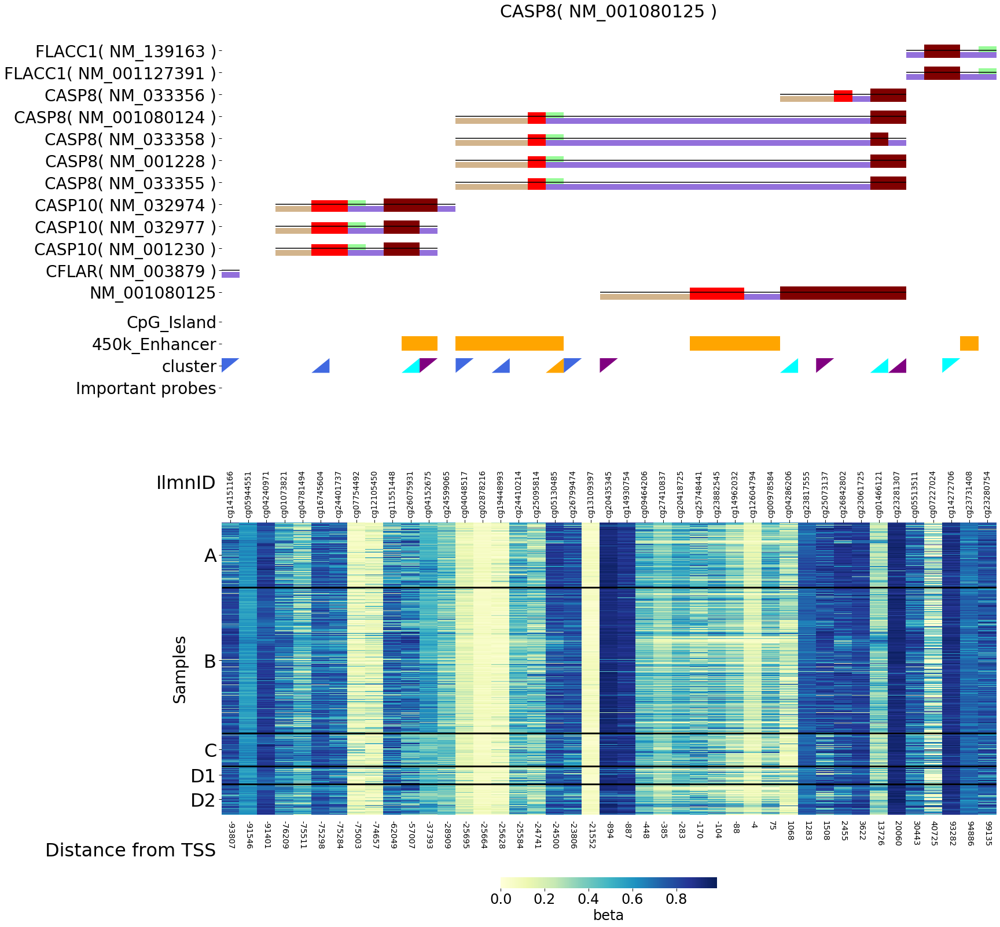

NM_033358 CASP8 + 202098185.0 202098185.0 202146640.0
140
36953 NM_001127184 170
9863 NM_003879 200
36954 NM_001127183 230
63669 NM_001230 260
7175 NM_032977 290
4313 NM_032974 320
42748 NM_033355 350
50724 NM_001228 380
54216 NM_001080124 410
20185 NM_001080125 440
42747 NM_033356 470
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_033358', 'CFLAR( NM_001127184 )', 'CFLAR( NM_003879 )', 'CFLAR( NM_001127183 )', 'CASP10( NM_001230 )', 'CASP10( NM_032977 )', 'CASP10( NM_032974 )', 'CASP8( NM_033355 )', 'CASP8( NM_001228 )', 'CASP8( NM_001080124 )', 'CASP8( NM_001080125 )', 'CASP8( NM_033356 )']
fin 470


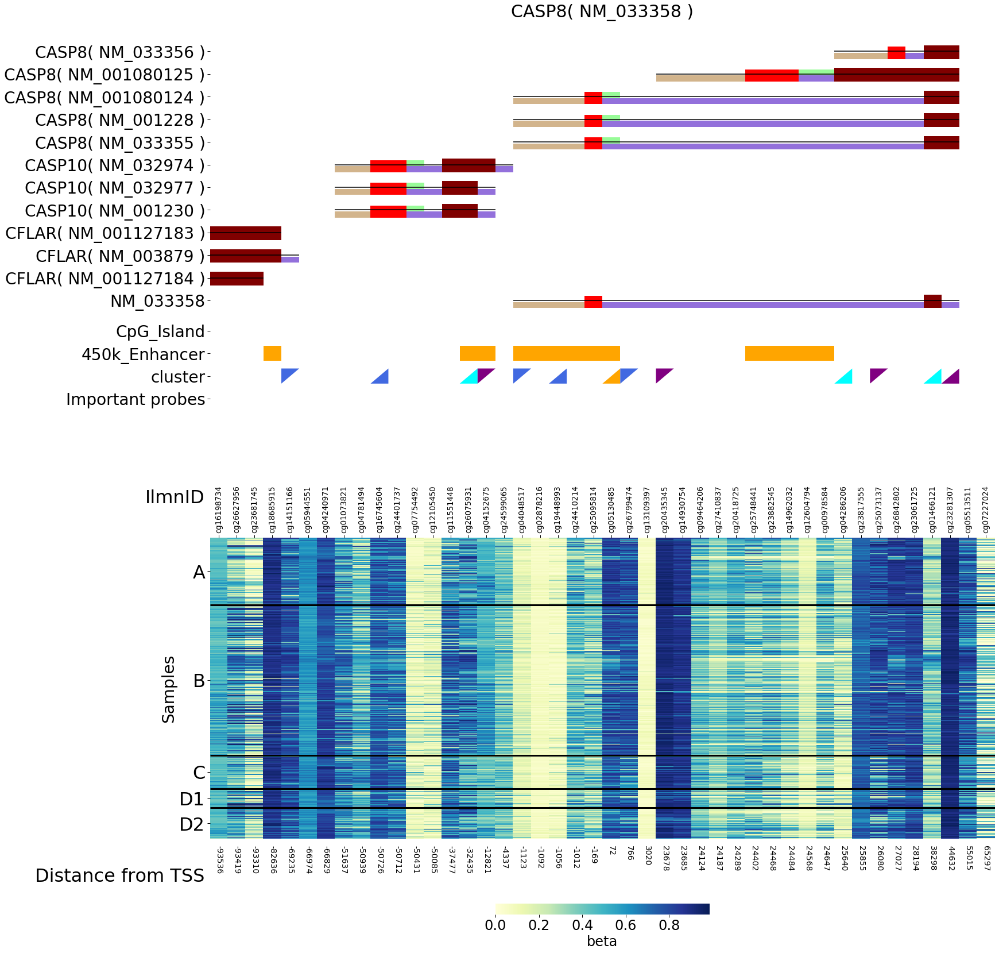

NM_033356 CASP8 + 202125258.0 202125258.0 202152432.0
140
9863 NM_003879 170
63669 NM_001230 200
7175 NM_032977 230
4313 NM_032974 260
42748 NM_033355 290
50724 NM_001228 320
42746 NM_033358 350
54216 NM_001080124 380
20185 NM_001080125 410
51472 NM_001127391 440
75514 NM_139163 470
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_033356', 'CFLAR( NM_003879 )', 'CASP10( NM_001230 )', 'CASP10( NM_032977 )', 'CASP10( NM_032974 )', 'CASP8( NM_033355 )', 'CASP8( NM_001228 )', 'CASP8( NM_033358 )', 'CASP8( NM_001080124 )', 'CASP8( NM_001080125 )', 'FLACC1( NM_001127391 )', 'FLACC1( NM_139163 )']
fin 470


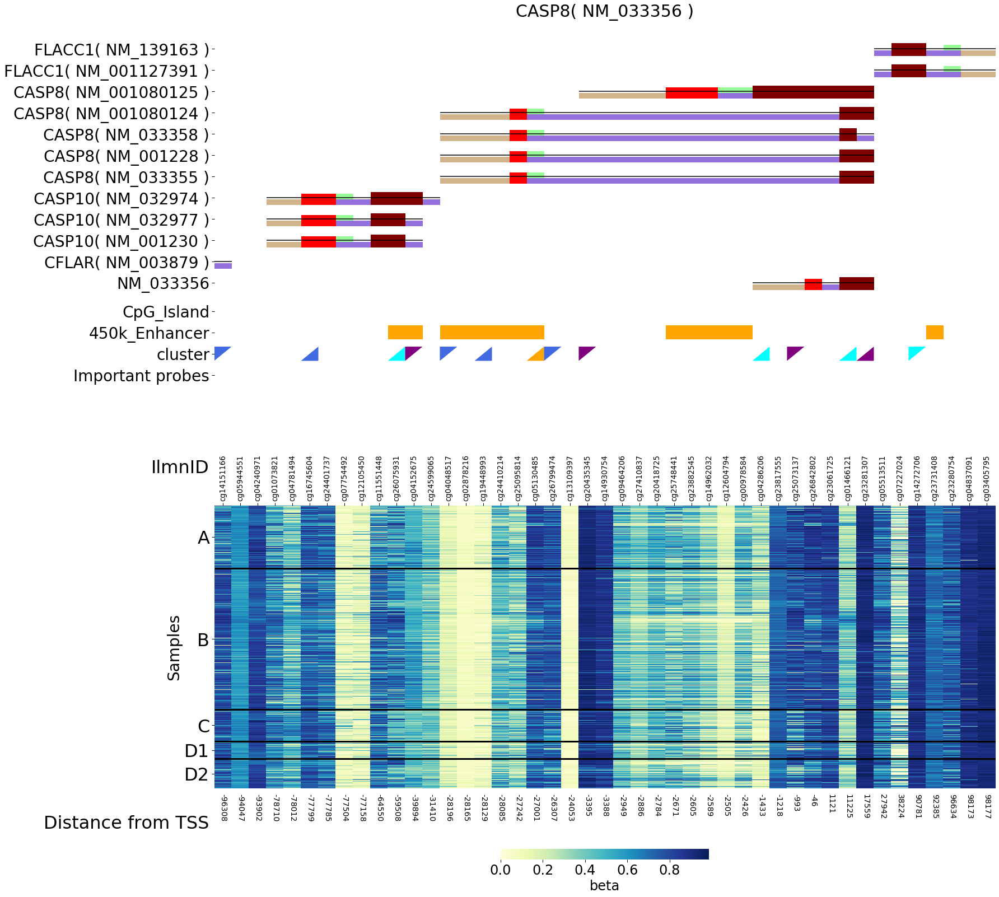

NM_033355 CASP8 + 202098165.0 202098165.0 202152434.0
140
36953 NM_001127184 170
9863 NM_003879 200
36954 NM_001127183 230
63669 NM_001230 260
7175 NM_032977 290
4313 NM_032974 320
50724 NM_001228 350
54216 NM_001080124 380
42746 NM_033358 410
20185 NM_001080125 440
42747 NM_033356 470
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_033355', 'CFLAR( NM_001127184 )', 'CFLAR( NM_003879 )', 'CFLAR( NM_001127183 )', 'CASP10( NM_001230 )', 'CASP10( NM_032977 )', 'CASP10( NM_032974 )', 'CASP8( NM_001228 )', 'CASP8( NM_001080124 )', 'CASP8( NM_033358 )', 'CASP8( NM_001080125 )', 'CASP8( NM_033356 )']
fin 470


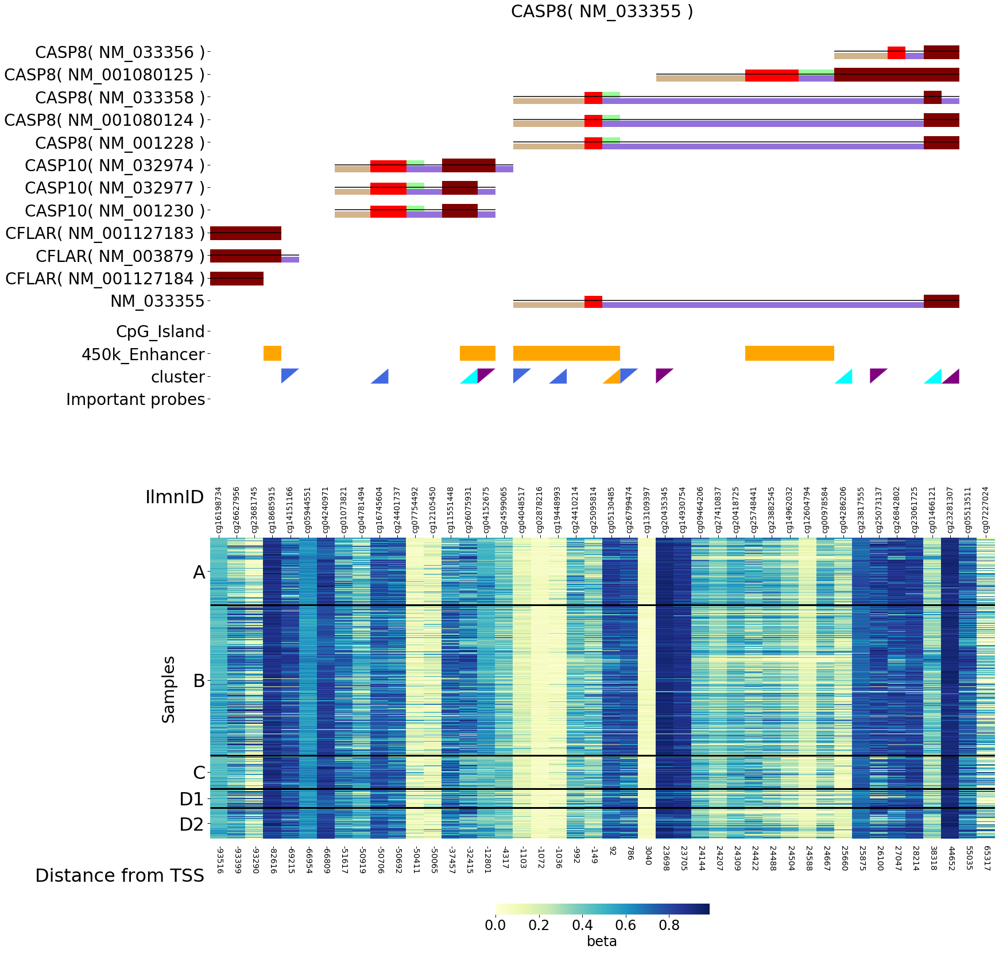

NM_001228 CASP8 + 202098165.0 202098165.0 202152434.0
140
36953 NM_001127184 170
9863 NM_003879 200
36954 NM_001127183 230
63669 NM_001230 260
7175 NM_032977 290
4313 NM_032974 320
42748 NM_033355 350
54216 NM_001080124 380
42746 NM_033358 410
20185 NM_001080125 440
42747 NM_033356 470
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001228', 'CFLAR( NM_001127184 )', 'CFLAR( NM_003879 )', 'CFLAR( NM_001127183 )', 'CASP10( NM_001230 )', 'CASP10( NM_032977 )', 'CASP10( NM_032974 )', 'CASP8( NM_033355 )', 'CASP8( NM_001080124 )', 'CASP8( NM_033358 )', 'CASP8( NM_001080125 )', 'CASP8( NM_033356 )']
fin 470


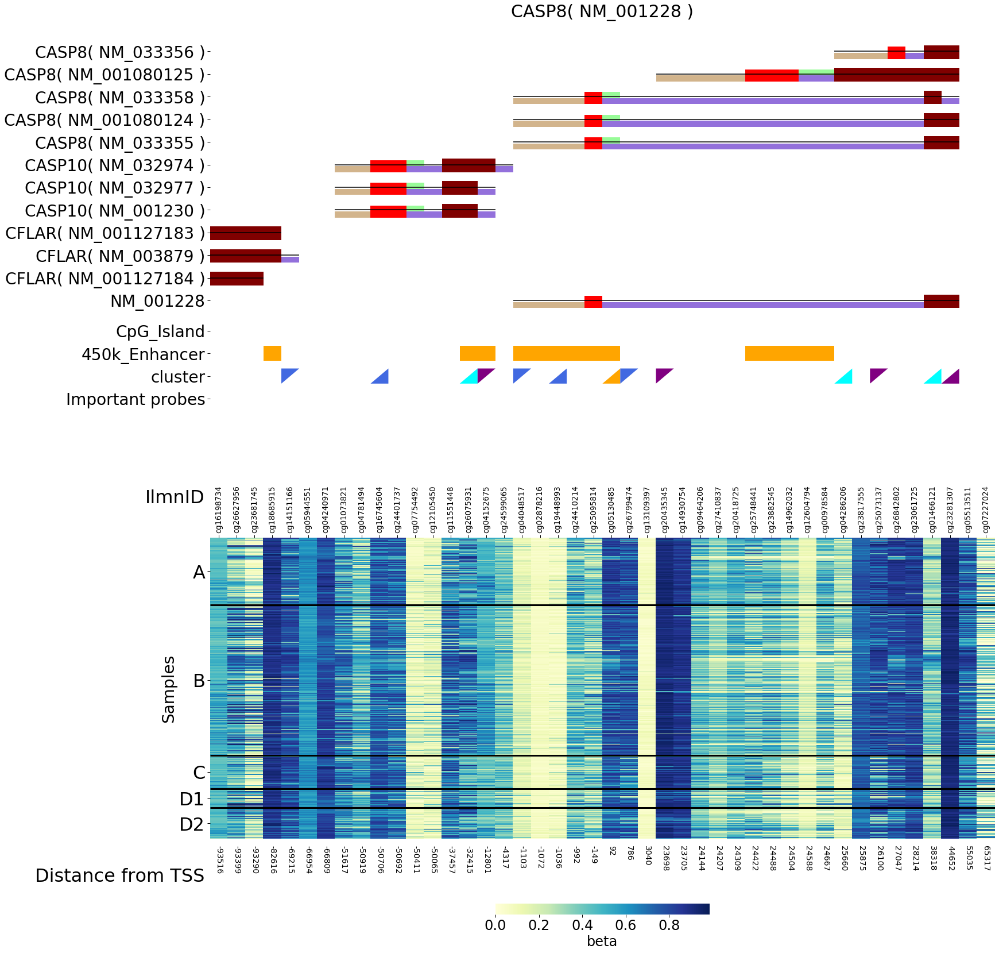

NM_001080124 CASP8 + 202098185.0 202098185.0 202152432.0
140
36953 NM_001127184 170
9863 NM_003879 200
36954 NM_001127183 230
63669 NM_001230 260
7175 NM_032977 290
4313 NM_032974 320
42748 NM_033355 350
50724 NM_001228 380
42746 NM_033358 410
20185 NM_001080125 440
42747 NM_033356 470
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001080124', 'CFLAR( NM_001127184 )', 'CFLAR( NM_003879 )', 'CFLAR( NM_001127183 )', 'CASP10( NM_001230 )', 'CASP10( NM_032977 )', 'CASP10( NM_032974 )', 'CASP8( NM_033355 )', 'CASP8( NM_001228 )', 'CASP8( NM_033358 )', 'CASP8( NM_001080125 )', 'CASP8( NM_033356 )']
fin 470


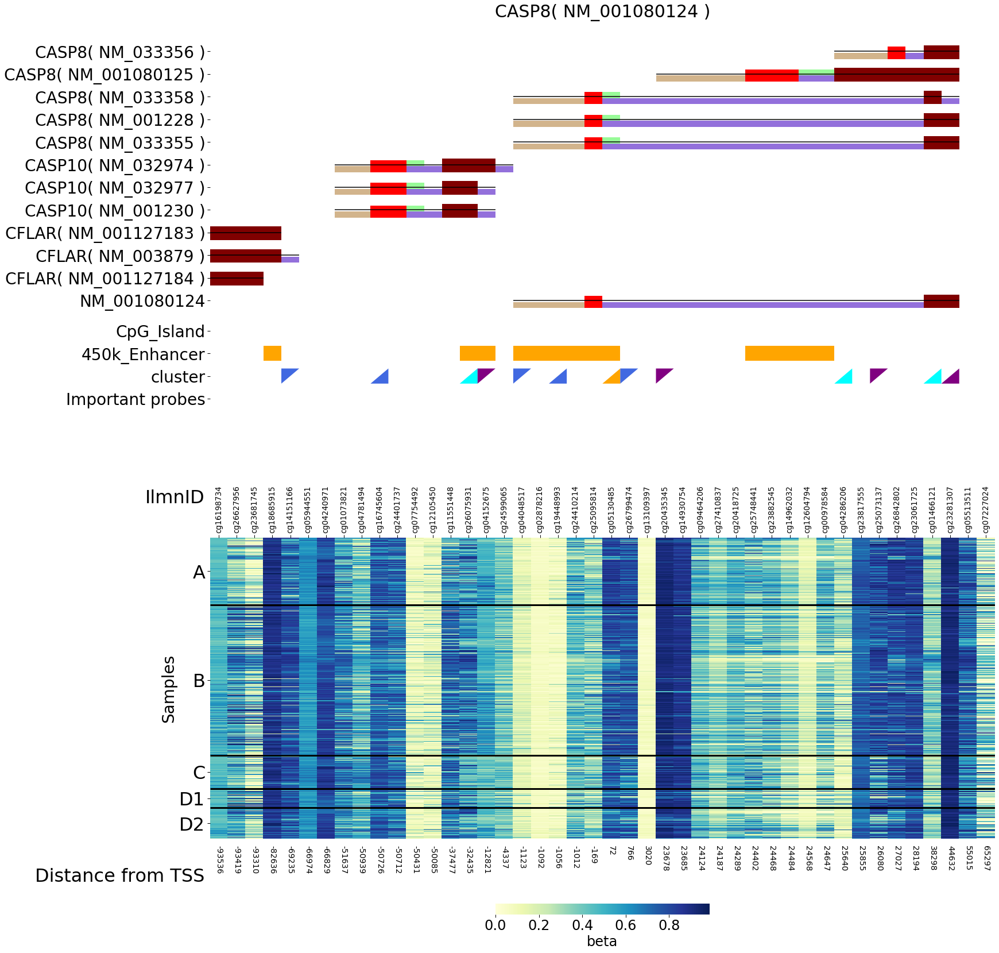

NR_111983 CASP8 + 202122757.0 202122757.0 202152432.0
NM_001372051 CASP8 + 202125258.0 202125258.0 202152432.0
NM_001425 EMP3 + 48828808.0 48828808.0 48833810.0
140
28322 NM_014959 170
75855 NM_153608 200
35069 NM_144577 230
20883 NM_018273 260
64676 NM_012451 290
48950 NM_006801 320
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001425', 'CARD8( NM_014959 )', 'ZNF114( NM_153608 )', 'CCDC114( NM_144577 )', 'TMEM143( NM_018273 )', 'SYNGR4( NM_012451 )', 'KDELR1( NM_006801 )']
fin 320


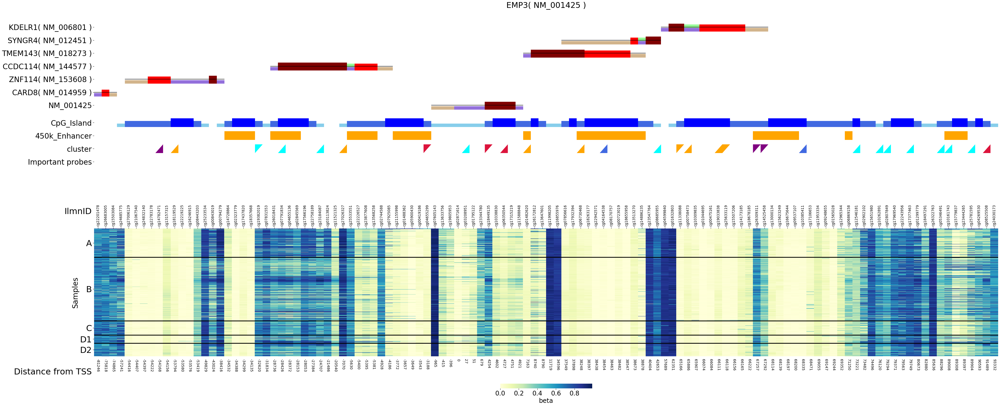

NM_001313905 EMP3 + 48829255.0 48829255.0 48833810.0
NM_152739 HOXA9 - 27205156.0 27202056.0 27205156.0
140
50216 NM_005522 170
75883 NM_153620 200
38516 NM_006735 230
80003 NM_030661 260
80014 NM_153631 290
29199 NM_002141 320
20879 NM_019102 350
13626 NM_024014 380
9883 NM_006896 410
72680 NR_029911 440
35158 NM_018951 470
50215 NM_005523 500
3327 NR_002795 530
68425 NM_000522 560
19085 NM_001989 590
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_152739', 'HOXA1( NM_005522 )', 'HOXA1( NM_153620 )', 'HOXA2( NM_006735 )', 'HOXA3( NM_030661 )', 'HOXA3( NM_153631 )', 'HOXA4( NM_002141 )', 'HOXA5( NM_019102 )', 'HOXA6( NM_024014 )', 'HOXA7( NM_006896 )', 'MIR196B( NR_029911 )', 'HOXA10( NM_018951 )', 'HOXA11( NM_005523 )', 'HOXA11-AS( NR_002795 )', 'HOXA13( NM_000522 )', 'EVX1( NM_001989 )']
fin 590


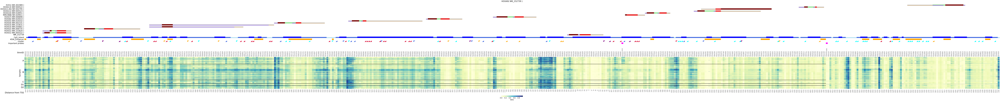

NM_001202555 CD44 + 35160717.0 35160717.0 35253949.0
NM_001001391 CD44 + 35160717.0 35160717.0 35253949.0
140
40153 NM_001001390 170
42643 NM_001001392 200
47602 NM_001001389 230
47998 NM_000610 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001001391', 'CD44( NM_001001390 )', 'CD44( NM_001001392 )', 'CD44( NM_001001389 )', 'CD44( NM_000610 )']
fin 260


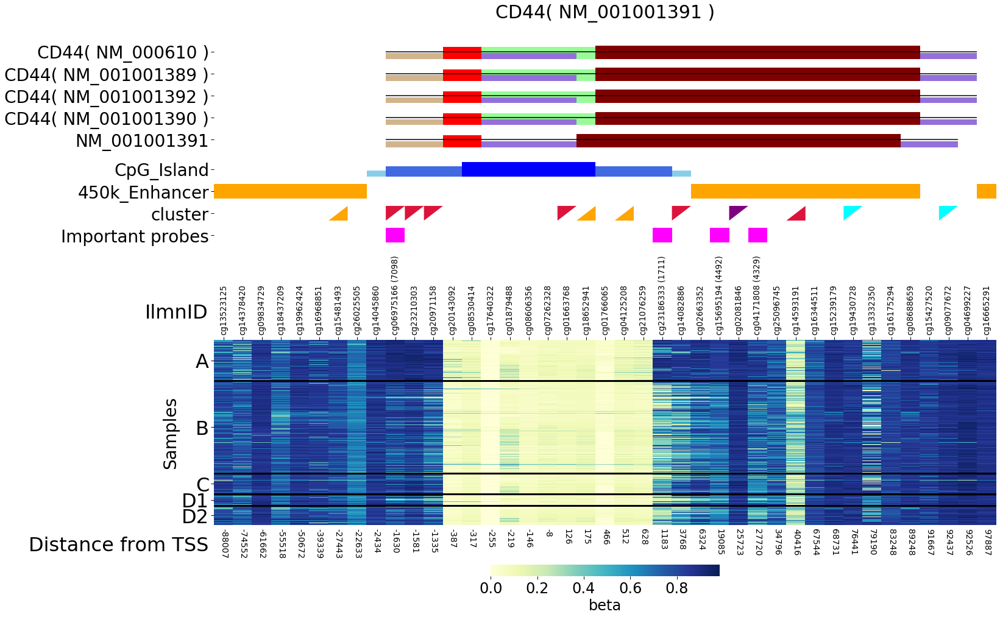

NM_001202557 CD44 + 35160717.0 35160717.0 35244866.0
NM_001202556 CD44 + 35160717.0 35160717.0 35253949.0
NM_001001390 CD44 + 35160717.0 35160717.0 35253949.0
140
19449 NM_001001391 170
42643 NM_001001392 200
47602 NM_001001389 230
47998 NM_000610 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001001390', 'CD44( NM_001001391 )', 'CD44( NM_001001392 )', 'CD44( NM_001001389 )', 'CD44( NM_000610 )']
fin 260


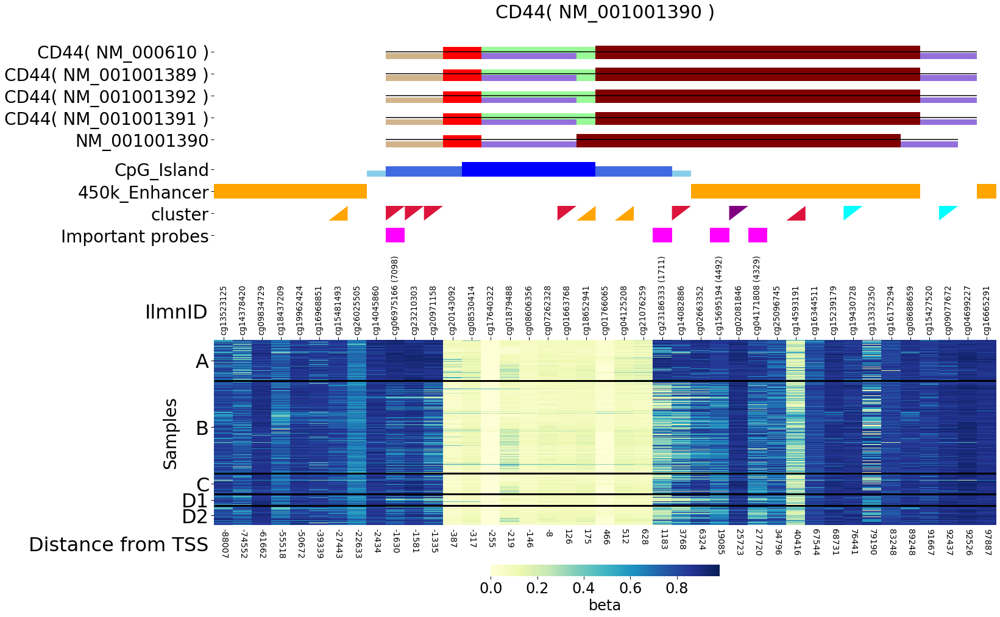

NM_001001392 CD44 + 35160717.0 35160717.0 35253949.0
140
19449 NM_001001391 170
40153 NM_001001390 200
47602 NM_001001389 230
47998 NM_000610 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001001392', 'CD44( NM_001001391 )', 'CD44( NM_001001390 )', 'CD44( NM_001001389 )', 'CD44( NM_000610 )']
fin 260


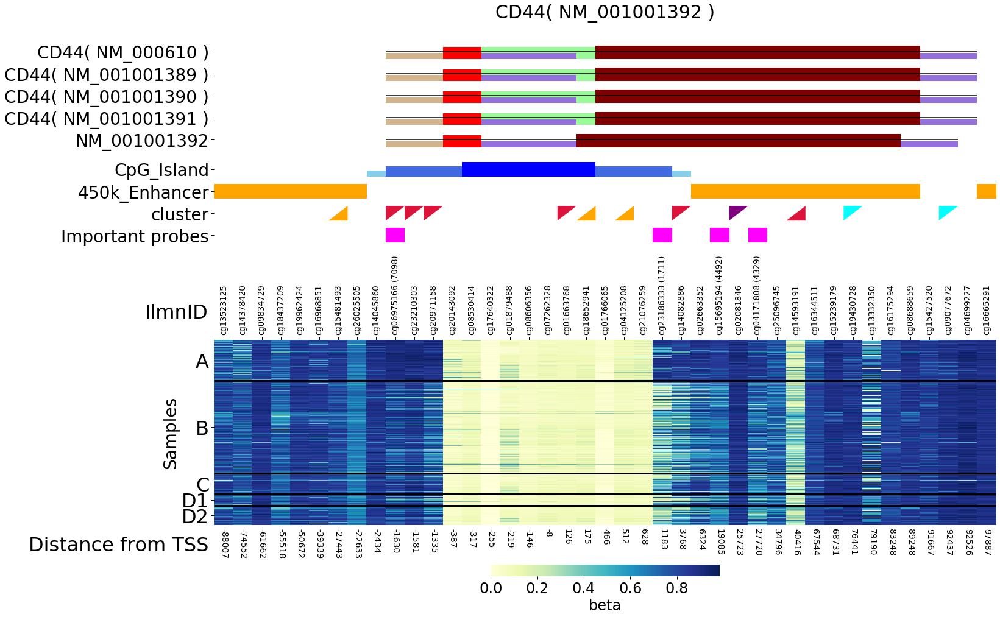

NM_001001389 CD44 + 35160717.0 35160717.0 35253949.0
140
19449 NM_001001391 170
40153 NM_001001390 200
42643 NM_001001392 230
47998 NM_000610 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_001001389', 'CD44( NM_001001391 )', 'CD44( NM_001001390 )', 'CD44( NM_001001392 )', 'CD44( NM_000610 )']
fin 260


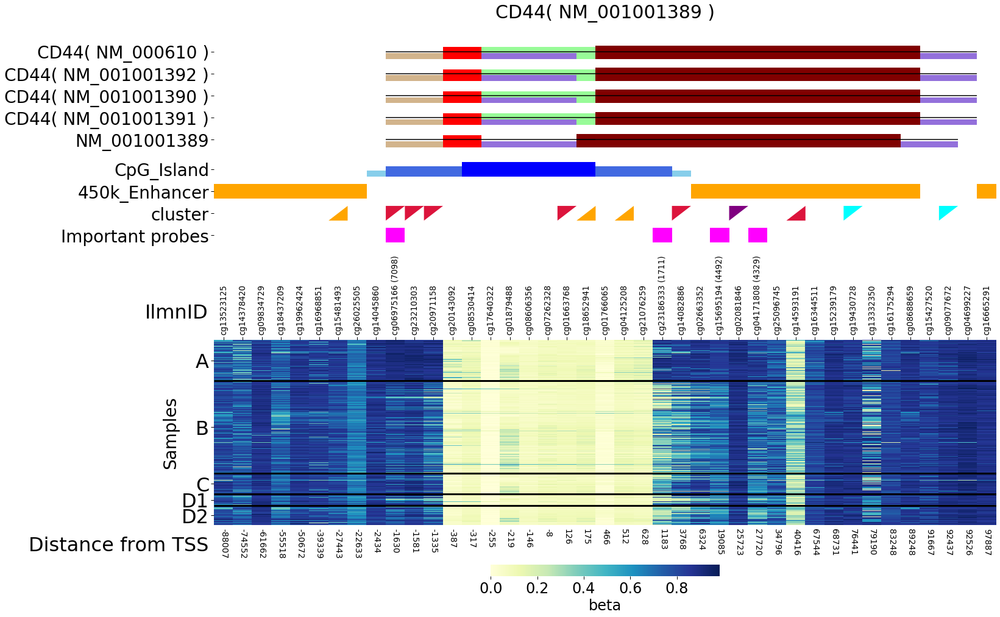

NM_000610 CD44 + 35160717.0 35160717.0 35253949.0
140
19449 NM_001001391 170
40153 NM_001001390 200
42643 NM_001001392 230
47602 NM_001001389 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_000610', 'CD44( NM_001001391 )', 'CD44( NM_001001390 )', 'CD44( NM_001001392 )', 'CD44( NM_001001389 )']
fin 260


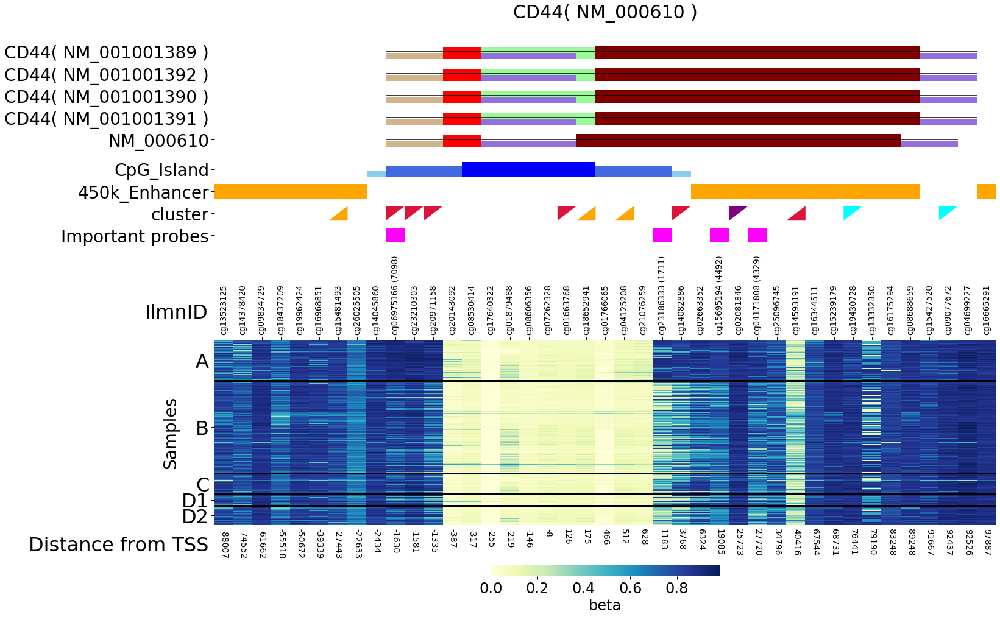

In [13]:
sns.set_context("paper", font_scale=1.5)

for j, itemsg in focal_genes.iterrows():
    TSS = 0
    if itemsg["strand"] == "+":
        TSS = itemsg["txStart"]
    else:
        TSS = itemsg["txEnd"]
        
    side = 100000
    print(itemsg["name"], itemsg["name2"], itemsg["strand"], TSS, itemsg["txStart"], itemsg["txEnd"])
#     continue
    refseq_id = itemsg["name"]
    symbol = itemsg["name2"]
    focalprobes = df_anno.loc[(df_anno["CHR"]==itemsg["chrom"].replace("chr","")) & (df_anno["Methyl450_Loci"]==True) & (df_anno["MAPINFO"]>TSS-side) & (df_anno["MAPINFO"]<TSS+side)].sort_values("MAPINFO")
    focalprobes

    focalprobes["UCSC_RefGene_Accession"] = focalprobes["UCSC_RefGene_Accession"].fillna("-1")

    if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(refseq_id)].shape[0]==0:
        continue

    chrom = df_refgenes.loc[df_refgenes["name"]==refseq_id]["chrom"].values[0]
    strand = df_refgenes.loc[df_refgenes["name"]==refseq_id]["strand"].values[0]
    txStart = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txStart"].values[0]
    txEnd = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txEnd"].values[0]
    focal_genes = df_refgenes.loc[(df_refgenes["chrom"]==chrom) & ((txStart-100000<df_refgenes["txEnd"])) & (df_refgenes["txEnd"]<txStart+100000)]
    focal_genes = focal_genes.sort_values("txStart")
    
    samplenum = 82+55+246+110

#     fig = plt.figure(figsize=(focalprobes.shape[0]/2, 10))
    fig = plt.figure(figsize=((focalprobes.shape[0]+5)/2, (samplenum+60+15*focal_genes.shape[0])/40))

    ############### ax2
    lw=3
    ax2 = fig.add_subplot(211)
    
    yticks_pos = []
    yticks_label = []
 
    h_offset = 0
    top_check = focalprobes.index.isin(top_probes.index)
    for i in range(len(top_check)):
        if focalprobes.index.isin(top_probes.index)[i]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((i,h_offset+10),1,20,fc="magenta"))
    yticks_pos.append(h_offset+20)
    yticks_label.append("Important probes")

    focal_Gini = pd.DataFrame()
    for k in focalprobes.index:
        for ka in ['thre', 'large', 'small', 'large0.5', 'small0.5', 'large0.6', 'small0.6', 'large0.7', 'small0.7', 'large0.8', 'small0.8', 'large0.9', 'small0.9']:
            focal_Gini.at[k, ka] = df_Gini.at[k, ka]
    focal_Gini
    
    h_offset+=40
    ia = 0
    for i, items in focal_Gini.iterrows():
        for k in cluster_color.keys():
            if items["large0.8"]==k:
                tri = plt.Polygon(((ia,h_offset+20),(ia+1,h_offset+20),(ia,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
            if items["small0.8"]==k:
                tri = plt.Polygon(((ia,h_offset),(ia+1,h_offset+20),(ia+1,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("cluster")
    
    h_offset += 30
    ia = 0
    for i, items in focalprobes.iterrows():
        if items["450k_Enhancer"]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,20,fc="orange"))
        if items["Relation_to_UCSC_CpG_Island"]=="Island":
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,20,fc="b"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shore") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shore"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,14,fc="royalblue"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shelf") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shelf"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,8,fc="skyblue"))
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("450k_Enhancer")
    yticks_pos.append(h_offset+40)
    yticks_label.append("CpG_Island")

#     yticks_label.append("Relation_to_UCSC_CpG_Island")
    h_offset += 40

    # gene annotation
    ia = 0
    for k in [refseq_id]:
        h_offset+=30
        for i, items in focalprobes.iterrows():
            if items["UCSC_RefGene_Accession"]=="-1":

                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)

            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,8,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values.shape[0] == 0:
                continue
            group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
        yticks_label.append(k)



    print(h_offset)
    for ka,itemsk in focal_genes.iterrows():
        k = itemsk["name"]
#         print(itemsk["name"],itemsk["name2"])
        if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(k)].shape[0]==0:
            continue
        if k==refseq_id:
            continue
            
        ia = 0
        h_offset+=30
        print(ka, k, h_offset)

        for i, items in focalprobes.iterrows():
            if pd.isna(items["UCSC_RefGene_Accession"])==True:
                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

#             print(k, i)
            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)
#                 print("\t", k, i, h_offset)
            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
#                 print(df_tmp)
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,16,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")].shape[0] > 0:
                group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
#         yticks_label.append(k)
        yticks_label.append(itemsk["name2"]+"( "+itemsk["name"]+" )")

    print(yticks_pos)
    print(yticks_label)


    ax2.set_yticks(yticks_pos)
    ax2.set_yticklabels(yticks_label,fontsize=28)
    ax2.set_xticks([])
    ax2.set_xticklabels([])
    ax2.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax2.set_ylim(-50, h_offset+50)
    ax2.spines['top'].set_visible(False)
    ax2.spines['bottom'].set_visible(False)
    ax2.spines['right'].set_visible(False)
    ax2.spines['left'].set_visible(False)
    plt.title(symbol+"( "+refseq_id+" )", fontsize=30)


#     ax2.axis('off')

    xlabel_rank = []
    xlabel_rank2 = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
        if itemsg["strand"] == "+":
            xlabel_rank2.append(int(focalprobes.at[k, "MAPINFO"]-itemsg["txStart"]))
        else:
            xlabel_rank2.append(int(itemsg["txEnd"]-focalprobes.at[k, "MAPINFO"]))

    ax1 = fig.add_subplot(212)
    
    xlabel_rank = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
    sns.heatmap(df_beta.loc[focalprobes.index][sorted_samples].transpose(), xticklabels=xlabel_rank, cmap="YlGnBu"
                , cbar_kws={"shrink": 0.3*40/focalprobes.shape[0], "label":"beta", "orientation":"horizontal"})
    cax = ax1.collections[0].colorbar.ax
    cax.tick_params(which='major', labelsize=24)
    cax.xaxis.label.set_fontsize(24)

    lw=3
    ax1.hlines(51,0,443,"k",linewidth=lw)
    ax1.hlines(82,0,443,"k",linewidth=lw)
    ax1.hlines(82+55,0,443,"k",linewidth=lw)
    ax1.hlines(82+55+246,0,443,"k",linewidth=lw)
    # ax.hlines(110+55+246+82,0,443,"k",linewidth=lw)

    labels = ax1.get_xticklabels()
    ax1.set_xticklabels(labels,rotation=90)
    ax1.xaxis.tick_top()

    # ylabel
    ax1.set_yticks([51/2,51+31/2,82+55/2,82+55+246/2,82+55+246+110/2])
    ax1.set_yticklabels(["D2","D1","C","B","A"],fontsize=32)
    ax1.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax1.set_ylim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[0])

    ax1.text(-.3,550,"IlmnID", size=32, ha="right")
    ax1.text(-.3,-70,"Distance from TSS", size=32, ha="right")

    for i in range(len(xlabel_rank2)):
        ax1.text(i+.5,-10,xlabel_rank2[i], size=14, ha="center", va="top", rotation=-90)

    ax1.set_xlabel("")
    ax1.set_ylabel("Samples",fontsize=28)

    print("fin", h_offset)


    plt.savefig(wd+"/fig/topgenes_D1D2_1221/"+symbol+"-"+refseq_id+".pdf", bbox_inches="tight")
    plt.show()
#     break

In [77]:
focal_genes = pd.DataFrame()
for k in ["PCDHB", "SKIV2L", "CYP26C1"]:
# for k in ["SKIV2L"]:
    for i,items in df_refgenes.loc[df_refgenes["name2"]==k].iterrows():
#     for i,items in df_refgenes.loc[df_refgenes["name2"].str.contains(k)].iterrows():
#         print(items["name"], items["name2"])
        focal_genes.at[items["name"], "name"] = items["name"]
        focal_genes.at[items["name"], "chrom"] = items["chrom"]
        focal_genes.at[items["name"], "strand"] = items["strand"]
        focal_genes.at[items["name"], "txStart"] = items["txStart"]
        focal_genes.at[items["name"], "txEnd"] = items["txEnd"]
        focal_genes.at[items["name"], "name2"] = items["name2"]
focal_genes

,name,chrom,strand,txStart,txEnd,name2
NM_006929,NM_006929,chr6_ssto_hap7,+,3259661.0,3270237.0,SKIV2L
NM_183374,NM_183374,chr10,+,94820554.0,94829297.0,CYP26C1


In [78]:
# focal_genes.at["NM_006929", "chrom"]
focal_genes.loc["NM_006929"]
focal_genes.at["NM_006929", "chrom"] = "chr6"
focal_genes.at["NM_006929", "txStart"] = 31926952
focal_genes.at["NM_006929", "txEnd"] = 31937528
focal_genes

,name,chrom,strand,txStart,txEnd,name2
NM_006929,NM_006929,chr6,+,31926952.0,31937528.0,SKIV2L
NM_183374,NM_183374,chr10,+,94820554.0,94829297.0,CYP26C1


In [72]:
df_refgenes.loc[df_refgenes["name2"]=="HGF"]

,bin,name,chrom,strand,txStart,txEnd,cdsStart,cdsEnd,exonCount,exonStarts,exonEnds,score,name2,cdsStartStat,cdsEndStat,exonFrames
5646,150,NM_001010931,chr7,-,81372006,81399363,81372257,81399287,8,"81372006,81372668,81374315,81381435,81386504,8...","81372265,81372787,81374436,81381578,81386619,8...",0,HGF,cmpl,cmpl,"1,2,1,2,1,2,1,0,"
34758,150,NM_001010934,chr7,-,81380215,81399363,81381427,81399287,5,"81380215,81386504,81388007,81392022,81399199,","81381578,81386619,81388120,81392188,81399363,",0,HGF,cmpl,cmpl,"2,1,2,1,0,"
35865,150,NM_001010932,chr7,-,81328327,81399363,81331896,81399287,18,"81328327,81334705,81334962,81335602,81336605,8...","81332073,81334851,81335069,81335743,81336680,8...",0,HGF,cmpl,cmpl,"0,1,2,2,2,1,1,2,1,2,1,2,1,2,1,2,1,0,"
39591,150,NM_001010933,chr7,-,81372006,81399363,81372257,81399287,8,"81372006,81372668,81374315,81381435,81386504,8...","81372265,81372787,81374436,81381563,81386619,8...",0,HGF,cmpl,cmpl,"1,2,1,2,1,2,1,0,"
44064,150,NM_000601,chr7,-,81328327,81399363,81331896,81399287,18,"81328327,81334705,81334962,81335602,81336605,8...","81332073,81334851,81335069,81335743,81336680,8...",0,HGF,cmpl,cmpl,"0,1,2,2,2,1,1,2,1,2,1,2,1,2,1,2,1,0,"


NM_006929 SKIV2L + 31926952.0 31926952.0 31937528.0
140
23974 NM_000434 170
39518 NM_025257 200
50500 NM_006709 230
29640 NM_025256 260
50864 NM_181842 290
18156 NM_001145903 320
13365 NM_000063 350
17407 NM_001710 380
60678 NM_002904 410
58655 NR_031601 440
4679 NM_005510 470
54716 NR_026717 500
62871 NM_032454 530
79825 NM_004197 560
55513 NM_007293 590
26843 NM_001002029 620
2979 NM_032470 650
50466 NR_001284 680
62872 NM_032454 710
79826 NM_004197 740
54717 NR_026717 770
35576 NM_001002029 800
11374 NM_000500 830
79827 NM_001128590 860
2980 NM_032470 890
[20, 50, 80, 110, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450, 480, 510, 540, 570, 600, 630, 660, 690, 720, 750, 780, 810, 840, 870, 900]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_006929', 'NEU1( NM_000434 )', 'SLC44A4( NM_025257 )', 'EHMT2( NM_006709 )', 'EHMT2( NM_025256 )', 'ZBTB12( NM_181842 )', 'C2( NM_001145903 )', 'C2( NM_000063 )', 'CFB( NM_001710 )', 'NELFE( NM_002904 )', 'MIR1236( NR_031

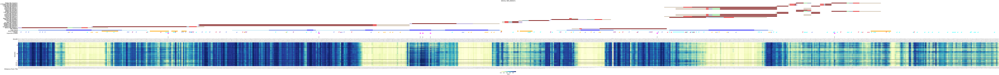

NM_183374 CYP26C1 + 94820554.0 94820554.0 94829297.0
140
6362 NM_001013848 170
48653 NM_019053 200
45689 NM_057157 230
42290 NM_000783 260
[20, 50, 80, 110, 150, 180, 210, 240, 270]
['Important probes', 'cluster', '450k_Enhancer', 'CpG_Island', 'NM_183374', 'EXOC6( NM_001013848 )', 'EXOC6( NM_019053 )', 'CYP26A1( NM_057157 )', 'CYP26A1( NM_000783 )']
fin 260


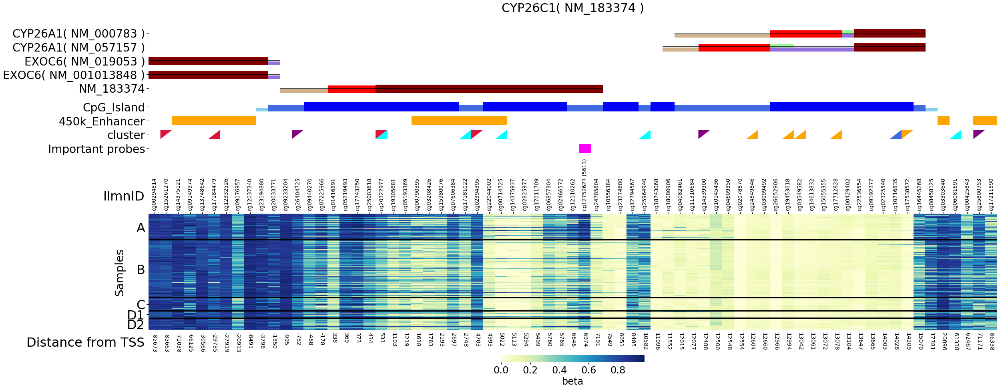

In [79]:
sns.set_context("paper", font_scale=1.5)

for j, itemsg in focal_genes.iterrows():
    TSS = 0
    if itemsg["strand"] == "+":
        TSS = itemsg["txStart"]
    else:
        TSS = itemsg["txEnd"]
        
    side = 100000
    print(itemsg["name"], itemsg["name2"], itemsg["strand"], TSS, itemsg["txStart"], itemsg["txEnd"])
#     continue
    refseq_id = itemsg["name"]
    symbol = itemsg["name2"]
    focalprobes = df_anno.loc[(df_anno["CHR"]==itemsg["chrom"].replace("chr","")) & (df_anno["Methyl450_Loci"]==True) & (df_anno["MAPINFO"]>TSS-side) & (df_anno["MAPINFO"]<TSS+side)].sort_values("MAPINFO")
    focalprobes

    focalprobes["UCSC_RefGene_Accession"] = focalprobes["UCSC_RefGene_Accession"].fillna("-1")

    if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(refseq_id)].shape[0]==0:
        print(refseq_id, focalprobes.shape, "skipped")
        print(focalprobes)
        continue

    chrom = df_refgenes.loc[df_refgenes["name"]==refseq_id]["chrom"].values[0]
    strand = df_refgenes.loc[df_refgenes["name"]==refseq_id]["strand"].values[0]
    txStart = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txStart"].values[0]
    txEnd = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txEnd"].values[0]
    focal_genes = df_refgenes.loc[(df_refgenes["chrom"]==chrom) & ((txStart-100000<df_refgenes["txEnd"])) & (df_refgenes["txEnd"]<txStart+100000)]
    focal_genes = focal_genes.sort_values("txStart")
    
    samplenum = 82+55+246+110

#     fig = plt.figure(figsize=(focalprobes.shape[0]/2, 10))
    fig = plt.figure(figsize=((focalprobes.shape[0]+5)/2, (samplenum+60+15*focal_genes.shape[0])/40))

    ############### ax2
    lw=3
    ax2 = fig.add_subplot(211)
    
    yticks_pos = []
    yticks_label = []
 
    h_offset = 0
    top_check = focalprobes.index.isin(top_probes.index)
    for i in range(len(top_check)):
        if focalprobes.index.isin(top_probes.index)[i]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((i,h_offset+10),1,20,fc="magenta"))
    yticks_pos.append(h_offset+20)
    yticks_label.append("Important probes")

    focal_Gini = pd.DataFrame()
    for k in focalprobes.index:
        for ka in ['thre', 'large', 'small', 'large0.5', 'small0.5', 'large0.6', 'small0.6', 'large0.7', 'small0.7', 'large0.8', 'small0.8', 'large0.9', 'small0.9']:
            focal_Gini.at[k, ka] = df_Gini.at[k, ka]
    focal_Gini
    
    h_offset+=40
    ia = 0
    for i, items in focal_Gini.iterrows():
        for k in cluster_color.keys():
            if items["large0.8"]==k:
                tri = plt.Polygon(((ia,h_offset+20),(ia+1,h_offset+20),(ia,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
            if items["small0.8"]==k:
                tri = plt.Polygon(((ia,h_offset),(ia+1,h_offset+20),(ia+1,h_offset)),fc=cluster_color[k])
                ax2.add_patch(tri)
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("cluster")
    
    h_offset += 30
    ia = 0
    for i, items in focalprobes.iterrows():
        if items["450k_Enhancer"]==True:
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,20,fc="orange"))
        if items["Relation_to_UCSC_CpG_Island"]=="Island":
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,20,fc="b"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shore") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shore"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,14,fc="royalblue"))
        elif (items["Relation_to_UCSC_CpG_Island"]=="N_Shelf") or (items["Relation_to_UCSC_CpG_Island"]=="S_Shelf"):
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset+30),1,8,fc="skyblue"))
        ia += 1
    yticks_pos.append(h_offset+10)
    yticks_label.append("450k_Enhancer")
    yticks_pos.append(h_offset+40)
    yticks_label.append("CpG_Island")

#     yticks_label.append("Relation_to_UCSC_CpG_Island")
    h_offset += 40

    # gene annotation
    ia = 0
    for k in [refseq_id]:
        h_offset+=30
        for i, items in focalprobes.iterrows():
            if items["UCSC_RefGene_Accession"]=="-1":

                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)

            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,8,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values.shape[0] == 0:
                continue
            group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
            ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
        yticks_label.append(k)



    print(h_offset)
    for ka,itemsk in focal_genes.iterrows():
        k = itemsk["name"]
#         print(itemsk["name"],itemsk["name2"])
        if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(k)].shape[0]==0:
            continue
        if k==refseq_id:
            continue
            
        ia = 0
        h_offset+=30
        print(ka, k, h_offset)

        for i, items in focalprobes.iterrows():
            if pd.isna(items["UCSC_RefGene_Accession"])==True:
                ia += 1
                continue
            tmp = pd.DataFrame(items["UCSC_RefGene_Accession"].split(";"))
            if tmp.loc[tmp[0]==k].shape[0]==0:
                ia += 1
                continue

#             print(k, i)
            if items["UCSC_RefGene_Accession"].find(k)!=-1:
                ax2.hlines(h_offset+10,ia,ia+1,"k",linewidth=lw/2)
#                 print("\t", k, i, h_offset)
            tmp = [items["UCSC_RefGene_Accession"].split(";")]
            tmp.append(items["UCSC_RefGene_Name"].split(";"))
            tmp.append(items["UCSC_RefGene_Group"].split(";"))
            df_tmp = pd.DataFrame(tmp).transpose()
            df_tmp.loc[df_tmp[0]==k][2]            
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]=="1stExon")].shape[0] > 0:
#                 print(df_tmp)
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,16,fc=gene_color["1stExon"]))
            if df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")].shape[0] > 0:
                group = df_tmp.loc[(df_tmp[0]==k) & (df_tmp[2]!="1stExon")][2].values[0]
                ax2.add_patch(matplotlib.patches.Rectangle((ia,h_offset),1,gene_height[group]*20,fc=gene_color[group]))
            ia += 1
        yticks_pos.append(h_offset+10)
#         yticks_label.append(k)
        yticks_label.append(itemsk["name2"]+"( "+itemsk["name"]+" )")

    print(yticks_pos)
    print(yticks_label)


    ax2.set_yticks(yticks_pos)
    ax2.set_yticklabels(yticks_label,fontsize=28)
    ax2.set_xticks([])
    ax2.set_xticklabels([])
    ax2.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax2.set_ylim(-50, h_offset+50)
    ax2.spines['top'].set_visible(False)
    ax2.spines['bottom'].set_visible(False)
    ax2.spines['right'].set_visible(False)
    ax2.spines['left'].set_visible(False)
    plt.title(symbol+"( "+refseq_id+" )", fontsize=30)


#     ax2.axis('off')

    xlabel_rank = []
    xlabel_rank2 = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
        if itemsg["strand"] == "+":
            xlabel_rank2.append(int(focalprobes.at[k, "MAPINFO"]-itemsg["txStart"]))
        else:
            xlabel_rank2.append(int(itemsg["txEnd"]-focalprobes.at[k, "MAPINFO"]))

    ax1 = fig.add_subplot(212)
    
    xlabel_rank = []
    for k in focalprobes.index:
        if df_imp.loc[df_imp[0]==k].index[0]<10000:
            xlabel_rank.append(k+" ("+str(df_imp.loc[df_imp[0]==k].index[0]+1)+")")
        else:
            xlabel_rank.append(k)
    sns.heatmap(df_beta.loc[focalprobes.index][sorted_samples].transpose(), xticklabels=xlabel_rank, cmap="YlGnBu"
                , cbar_kws={"shrink": 0.3*40/focalprobes.shape[0], "label":"beta", "orientation":"horizontal"})
    cax = ax1.collections[0].colorbar.ax
    cax.tick_params(which='major', labelsize=24)
    cax.xaxis.label.set_fontsize(24)

    lw=3
    lr=9000 # 443
    ax1.hlines(51,0,lr,"k",linewidth=lw)
    ax1.hlines(82,0,lr,"k",linewidth=lw)
    ax1.hlines(82+55,0,lr,"k",linewidth=lw)
    ax1.hlines(82+55+246,0,lr,"k",linewidth=lw)
    # ax.hlines(110+55+246+82,0,443,"k",linewidth=lw)

    labels = ax1.get_xticklabels()
    ax1.set_xticklabels(labels,rotation=90)
    ax1.xaxis.tick_top()

    # ylabel
    ax1.set_yticks([51/2,51+31/2,82+55/2,82+55+246/2,82+55+246+110/2])
    ax1.set_yticklabels(["D2","D1","C","B","A"],fontsize=32)
    ax1.set_xlim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[1])
    ax1.set_ylim(0, df_beta.loc[focalprobes.index][sorted_samples].transpose().shape[0])

    ax1.text(-.3,550,"IlmnID", size=32, ha="right")
    ax1.text(-.3,-70,"Distance from TSS", size=32, ha="right")

    for i in range(len(xlabel_rank2)):
        ax1.text(i+.5,-10,xlabel_rank2[i], size=14, ha="center", va="top", rotation=-90)

    ax1.set_xlabel("")
    ax1.set_ylabel("Samples",fontsize=28)

    print("fin", h_offset)


    plt.savefig(wd+"/fig/topgenes_D1D2_1209/"+symbol+"-"+refseq_id+".pdf", bbox_inches="tight")
    plt.show()
#     break

In [75]:
focalprobes[['CHR','MAPINFO',"UCSC_RefGene_Accession","UCSC_RefGene_Name","UCSC_CpG_Islands_Name"]].sort_values("MAPINFO")

,CHR,MAPINFO,UCSC_RefGene_Accession,UCSC_RefGene_Name,UCSC_CpG_Islands_Name
IlmnID,,,,,
cg04219580,6,31827122.0,NM_000434,NEU1,chr6:31830299-31830948
cg26710347,6,31827226.0,NM_000434,NEU1,chr6:31830299-31830948
cg15551272,6,31827414.0,NM_000434,NEU1,chr6:31830299-31830948
cg22240802,6,31827528.0,NM_000434,NEU1,chr6:31830299-31830948
cg16918667,6,31827573.0,NM_000434,NEU1,chr6:31830299-31830948
...,...,...,...,...,...
cg25596754,6,32026610.0,NM_019105,TNXB,NaN
cg19071976,6,32026656.0,NM_019105,TNXB,NaN
cg14642392,6,32026740.0,NM_019105,TNXB,NaN


In [27]:
sns.set_context("paper", font_scale=1.5)

for j, itemsg in focal_genes.iterrows():
    TSS = 0
    if itemsg["strand"] == "+":
        TSS = itemsg["txStart"]
    else:
        TSS = itemsg["txEnd"]
        
    side = 100000
    print(itemsg["name"], itemsg["name2"], itemsg["strand"], TSS, itemsg["txStart"], itemsg["txEnd"])
#     continue
    refseq_id = itemsg["name"]
    symbol = itemsg["name2"]
    focalprobes = df_anno.loc[(df_anno["CHR"]==itemsg["chrom"].replace("chr","")) & (df_anno["Methyl450_Loci"]==True) & (df_anno["MAPINFO"]>TSS-side) & (df_anno["MAPINFO"]<TSS+side)].sort_values("MAPINFO")
    focalprobes

    focalprobes["UCSC_RefGene_Accession"] = focalprobes["UCSC_RefGene_Accession"].fillna("-1")

    if focalprobes.loc[focalprobes["UCSC_RefGene_Accession"].str.contains(refseq_id)].shape[0]==0:
        continue

    chrom = df_refgenes.loc[df_refgenes["name"]==refseq_id]["chrom"].values[0]
    strand = df_refgenes.loc[df_refgenes["name"]==refseq_id]["strand"].values[0]
    txStart = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txStart"].values[0]
    txEnd = df_refgenes.loc[df_refgenes["name"]==refseq_id]["txEnd"].values[0]
    focal_genes = df_refgenes.loc[(df_refgenes["chrom"]==chrom) & ((txStart-100000<df_refgenes["txEnd"])) & (df_refgenes["txEnd"]<txStart+100000)]
    focal_genes = focal_genes.sort_values("txStart")
    


NM_001013848 EXOC6 + 94586587 94586587 94819251
NM_001319194 EXOC6 + 94590864 94590864 94819245
NM_001319200 EXOC6 + 94608211 94608211 94819251
NM_019053 EXOC6 + 94608276 94608276 94819245
NM_001319195 EXOC6 + 94608276 94608276 94819245
NM_183374 CYP26C1 + 94820554 94820554 94829297
NM_057157 CYP26A1 + 94833231 94833231 94837641
NM_000783 CYP26A1 + 94833649 94833649 94837642


In [67]:
df_anno.loc[(~df_anno["UCSC_RefGene_Accession"].isnull()) & (df_anno["UCSC_RefGene_Accession"].str.contains("NM_006929"))][['CHR','MAPINFO',"UCSC_RefGene_Accession","UCSC_RefGene_Name","UCSC_RefGene_Group"]].sort_values("MAPINFO")

,CHR,MAPINFO,UCSC_RefGene_Accession,UCSC_RefGene_Name,UCSC_RefGene_Group
IlmnID,,,,,
cg18051316,6,31925660.0,NM_002904;NM_006929;NR_031601,RDBP;SKIV2L;MIR1236,Body;TSS1500;TSS1500
cg09583599,6,31925920.0,NM_002904;NM_006929;NR_031601,RDBP;SKIV2L;MIR1236,Body;TSS1500;TSS1500
cg08810053,6,31926072.0,NM_002904;NM_006929;NR_031601,RDBP;SKIV2L;MIR1236,Body;TSS1500;TSS1500
cg01869058,6,31926196.0,NM_002904;NM_006929;NR_031601,RDBP;SKIV2L;MIR1236,Body;TSS1500;TSS1500
cg10223234,6,31926205.0,NM_002904;NM_006929;NR_031601,RDBP;SKIV2L;MIR1236,Body;TSS1500;TSS1500
...,...,...,...,...,...
cg25559531,6,31937394.0,NM_006929,SKIV2L,Body
cg10674805,6,31937437.0,NM_006929,SKIV2L,Body
cg05909390,6,31937454.0,NR_026717;NM_006929,STK19;SKIV2L,TSS1500;Body


In [37]:
df_anno.columns

Index(['Name', 'AddressA_ID', 'AlleleA_ProbeSeq', 'AddressB_ID',
       'AlleleB_ProbeSeq', 'Infinium_Design_Type', 'Next_Base',
       'Color_Channel', 'Forward_Sequence', 'Genome_Build', 'CHR', 'MAPINFO',
       'SourceSeq', 'Strand', 'UCSC_RefGene_Name', 'UCSC_RefGene_Accession',
       'UCSC_RefGene_Group', 'UCSC_CpG_Islands_Name',
       'Relation_to_UCSC_CpG_Island', 'Phantom4_Enhancers',
       'Phantom5_Enhancers', 'DMR', '450k_Enhancer', 'HMM_Island',
       'Regulatory_Feature_Name', 'Regulatory_Feature_Group',
       'GencodeBasicV12_NAME', 'GencodeBasicV12_Accession',
       'GencodeBasicV12_Group', 'GencodeCompV12_NAME',
       'GencodeCompV12_Accession', 'GencodeCompV12_Group',
       'DNase_Hypersensitivity_NAME', 'DNase_Hypersensitivity_Evidence_Count',
       'OpenChromatin_NAME', 'OpenChromatin_Evidence_Count', 'TFBS_NAME',
       'TFBS_Evidence_Count', 'Methyl27_Loci', 'Methyl450_Loci',
       'Chromosome_36', 'Coordinate_36', 'SNP_ID', 'SNP_DISTANCE',
       'SNP_Mi

In [61]:
k=100
for i in range(20):
    k=k-k*0.06
    print(i, k)
#     print(100-(100-(i-1)*6))

0 94.0
1 88.36
2 83.0584
3 78.07489600000001
4 73.39040224000001
5 68.98697810560002
6 64.84775941926401
7 60.956893854108166
8 57.299480222861675
9 53.86151140948998
10 50.62982072492058
11 47.592031481425344
12 44.736509592539825
13 42.05231901698743
14 39.52917987596819
15 37.1574290834101
16 34.9279833384055
17 32.83230433810117
18 30.862366077815096
19 29.01062411314619
